<a href="https://colab.research.google.com/github/mehdi-khribch/Probabilistic-Graphical-Models/blob/master/gaussian_processes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 Markdown Cell:
 Monte Carlo Simulation for Probability Estimation

 This notebook implements various Monte Carlo methods to estimate the probability:

 $P(X \in A)$ where $X \sim N_d(0, I_d)$ and $A = \{(x_1, \ldots, x_d), \prod_{i=1}^d |x_i| \leq c\}$

 We'll implement and compare:
 1. Standard Monte Carlo
 2. Control Variates method
 3. Antithetic Variables
 4. Quasi-Monte Carlo (QMC)

In [2]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
from matplotlib.animation import FuncAnimation
from tqdm.notebook import tqdm
from IPython.display import HTML

# Set random seed for reproducibility
np.random.seed(42)

In [3]:
def standard_monte_carlo(n, d, c):
    """
    Standard Monte Carlo estimation of probability P(X ∈ A)

    Parameters:
    n (int): Number of samples
    d (int): Dimension
    c (float): Threshold parameter

    Returns:
    float: Probability estimate
    """
    # Generate n samples from N_d(0, I_d)
    X = np.random.normal(0, 1, (n, d))

    # Calculate product of absolute values for each sample
    products = np.prod(np.abs(X), axis=1)

    # Check if each sample is in set A
    indicator = products <= c

    # Return the mean (proportion of samples in A)
    return np.mean(indicator), indicator, X, products

In [4]:
# Run standard Monte Carlo for d=2, c=1.0
n = 10**4  # Number of samples
d = 2      # Dimension
c = 1.0    # Threshold parameter

mc_prob, mc_indicator, mc_X, mc_products = standard_monte_carlo(n, d, c)
print(f"Standard Monte Carlo estimate: P(X ∈ A) = {mc_prob:.6f}")

Standard Monte Carlo estimate: P(X ∈ A) = 0.795100


In [5]:
def plot_2d_samples(X, indicator, c, method_name="Monte Carlo"):
    """Plot 2D samples showing points inside and outside the set A"""
    plt.figure(figsize=(10, 8))

    # Separate points inside and outside set A
    X_in = X[indicator]
    X_out = X[~indicator]

    # Plot points
    plt.scatter(X_in[:, 0], X_in[:, 1], c='blue', alpha=0.6, s=10, label=f'Inside A: |x₁×x₂| ≤ {c}')
    plt.scatter(X_out[:, 0], X_out[:, 1], c='red', alpha=0.4, s=10, label=f'Outside A: |x₁×x₂| > {c}')

    plt.title(f'{method_name} Simulation: P(X ∈ A) ≈ {np.mean(indicator):.4f}')
    plt.xlabel('x₁')
    plt.ylabel('x₂')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.axis('equal')

    # Optional: Plot the boundary |x₁×x₂| = c
    x = np.linspace(-4, 4, 1000)
    # Avoid division by zero
    y_upper = np.zeros_like(x)
    y_lower = np.zeros_like(x)

    for i, xi in enumerate(x):
        if xi != 0:
            y_upper[i] = c / np.abs(xi)
            y_lower[i] = -c / np.abs(xi)

    plt.plot(x, y_upper, 'k--', alpha=0.5)
    plt.plot(x, y_lower, 'k--', alpha=0.5)

    plt.xlim(-4, 4)
    plt.ylim(-4, 4)

    return plt.gcf()

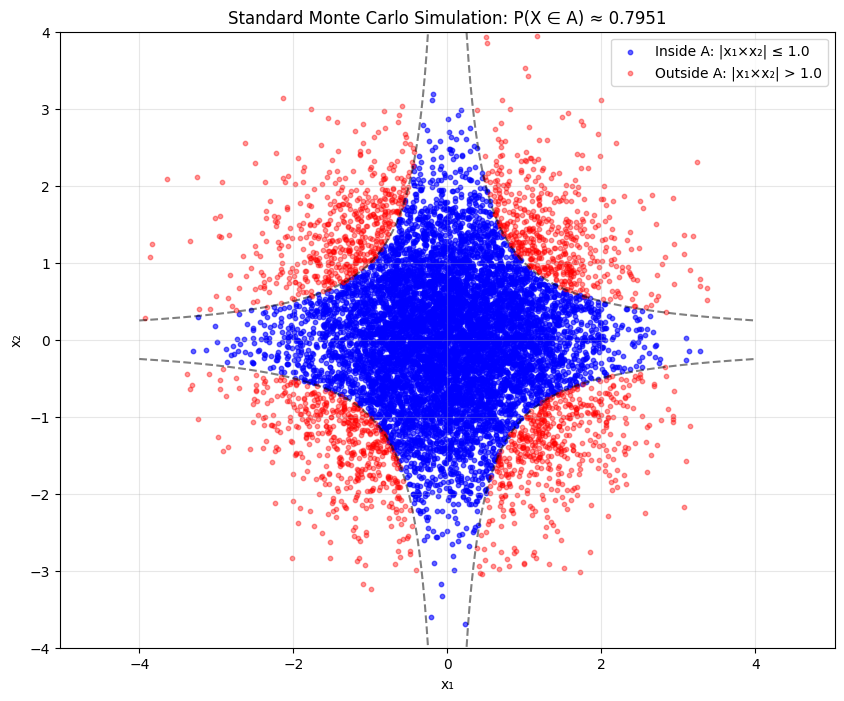

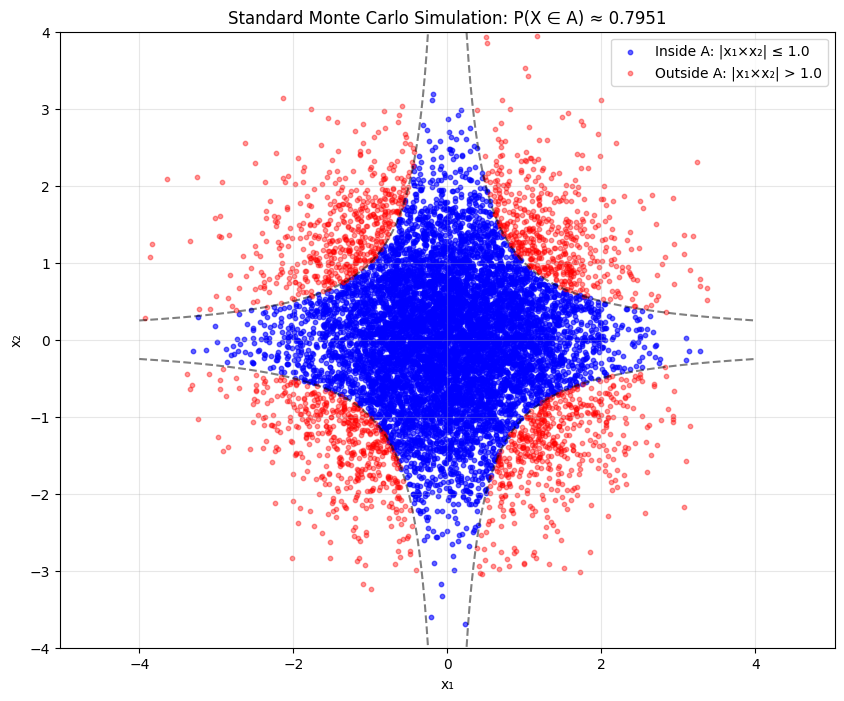

In [6]:
# Plot the 2D case
plot_2d_samples(mc_X, mc_indicator, c, "Standard Monte Carlo")

c = 1.00: P(X ∈ A) = 0.789100, % samples in A: 78.9100%
c = 0.50: P(X ∈ A) = 0.587600, % samples in A: 58.7600%
c = 0.10: P(X ∈ A) = 0.212300, % samples in A: 21.2300%
c = 0.01: P(X ∈ A) = 0.034500, % samples in A: 3.4500%


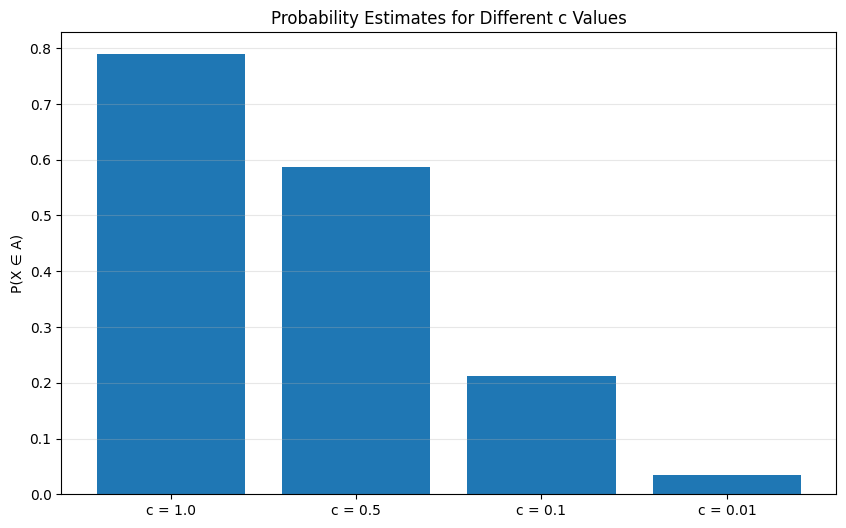

In [7]:
# Test different values of c
c_values = [1.0, 0.5, 0.1, 0.01]
results = []

for c in c_values:
    prob, indicator, _, _ = standard_monte_carlo(n, d, c)
    results.append(prob)
    print(f"c = {c:.2f}: P(X ∈ A) = {prob:.6f}, % samples in A: {prob*100:.4f}%")

# Create bar chart of probabilities
plt.figure(figsize=(10, 6))
plt.bar(range(len(c_values)), results, tick_label=[f"c = {c}" for c in c_values])
plt.title("Probability Estimates for Different c Values")
plt.ylabel("P(X ∈ A)")
plt.grid(alpha=0.3, axis='y')

In [8]:
def control_variate_monte_carlo(n, d, c):
    """
    Parameters:
    n (int): Number of samples
    d (int): Dimension
    c (float): Threshold parameter

    Returns:
    float: Improved probability estimate
    """
    # Generate n samples from N_d(0, I_d)
    X = np.random.normal(0, 1, (n, d))

    # For d=2, calculate |X[,1] * X[,2]| as the product
    products = np.abs(X[:, 0] * X[:, 1])  # using product for d=2

    # Check if each sample is in set A
    indicator = products <= c

    # Control variate: Z = |X[,1] * X[,2]| - 2/π (for d=2, expectation is 2/π)
    Z = products - 2/np.pi  # E[|X_1 * X_2|] = 2/π for d=2

    # Calculate optimal beta coefficient
    beta = -np.cov(indicator.astype(float), Z)[0, 1] / np.var(Z)

    # Control variate estimator
    cv_estimator = np.mean(indicator) + beta * np.mean(Z)  # mean(Z) should be close to 0

    return cv_estimator, indicator, X, products, Z, beta

In [9]:
def run_control_variate_simulation(n_sim=1000, n_samples=1000, d=2, c=0.5):
    """
    Parameters:
    n_sim (int): Number of simulations
    n_samples (int): Number of samples per simulation
    d (int): Dimension (default 2)
    c (float): Threshold parameter

    Returns:
    np.array: Matrix of estimates (n_sim x 2)
    """
    # Create matrix to store results (similar to R's matrix)
    estimates = np.zeros((n_sim, 2))

    for j in range(n_sim):
        # Generate samples
        X = np.random.normal(0, 1, (n_samples, d))

        # Calculate product and indicator
        products = np.abs(X[:, 0] * X[:, 1])
        Y = products <= c

        # Store standard MC estimate
        estimates[j, 0] = np.mean(Y)

        # Control variate Z = |X[,1] * X[,2]| - 2/π
        Z = products - 2/np.pi

        # Calculate beta and control variate estimate
        beta = -np.cov(Y.astype(float), Z)[0, 1] / np.var(Z)
        estimates[j, 1] = np.mean(Y + beta * Z)

    # Calculate and print statistics (similar to apply in R)
    variances = np.var(estimates, axis=0)
    means = np.mean(estimates, axis=0)

    print("Variances of estimates:")
    print(f"Standard MC: {variances[0]:.8f}")
    print(f"Control Variate: {variances[1]:.8f}")
    print(f"Variance reduction ratio: {variances[0]/variances[1]:.2f}")

    print("\nMeans of estimates:")
    print(f"Standard MC: {means[0]:.6f}")
    print(f"Control Variate: {means[1]:.6f}")

    return estimates, variances, means

Variances of estimates:
Standard MC: 0.00024649
Control Variate: 0.00012820
Variance reduction ratio: 1.92

Means of estimates:
Standard MC: 0.589745
Control Variate: 0.589710


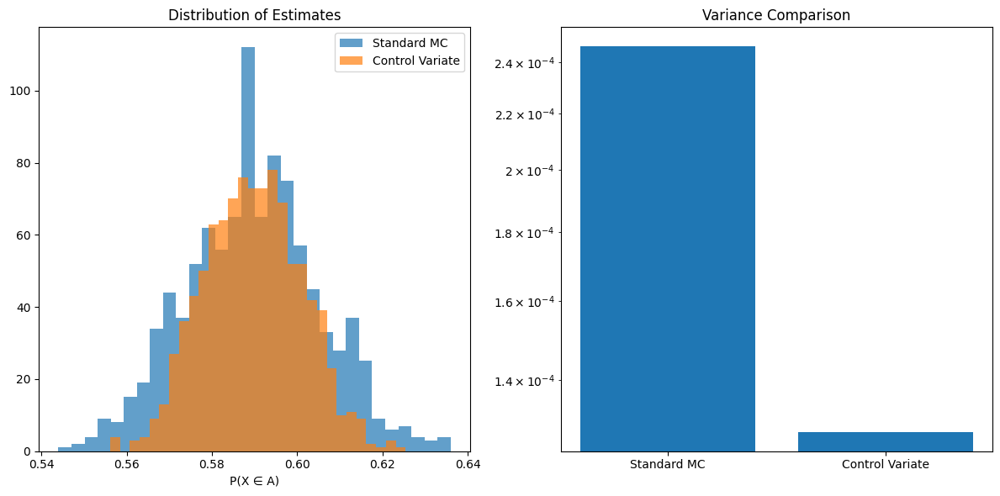

In [10]:
# Run the simulation
n_sim = 1000
n_samples = 1000
d = 2
c = 0.5

estimates, variances, means = run_control_variate_simulation(n_sim, n_samples, d, c)

# Plot the results
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(estimates[:, 0], bins=30, alpha=0.7, label="Standard MC")
plt.hist(estimates[:, 1], bins=30, alpha=0.7, label="Control Variate")
plt.title("Distribution of Estimates")
plt.xlabel("P(X ∈ A)")
plt.legend()

plt.subplot(1, 2, 2)
plt.bar([0, 1], variances, tick_label=["Standard MC", "Control Variate"])
plt.title("Variance Comparison")
plt.yscale('log')

plt.tight_layout()

In [11]:
def qmc_estimation(n, d, c):
    """
    Quasi-Monte Carlo estimation using Sobol sequences

    Parameters:
    n (int): Number of samples
    d (int): Dimension
    c (float): Threshold parameter

    Returns:
    float: Probability estimate using QMC
    """
    # Generate Sobol sequence in [0,1]^d
    from scipy.stats import qmc

    sampler = qmc.Sobol(d=d, scramble=True)
    samples = sampler.random(n)

    # Transform to standard normal distribution using inverse CDF
    X = stats.norm.ppf(samples)

    # Calculate product of absolute values for each sample
    products = np.prod(np.abs(X), axis=1)

    # Check if each sample is in set A
    indicator = products <= c

    # Return the mean (proportion of samples in A)
    return np.mean(indicator), indicator, X, products

In [12]:
# Compare standard MC and QMC
def compare_mc_qmc(n_sim=100, n_samples=1000, d=2, c_values=[1.0, 0.5, 0.1, 0.01]):
    """
    Compare standard Monte Carlo with QMC across different values of c

    Parameters:
    n_sim (int): Number of simulations
    n_samples (int): Number of samples per simulation
    d (int): Dimension
    c_values (list): List of c values to test

    Returns:
    dict: Results including means and variances
    """
    results = {}

    for c in c_values:
        results[c] = {
            'standard_mc': {'estimates': np.zeros(n_sim)},
            'qmc': {'estimates': np.zeros(n_sim)}
        }

        for i in tqdm(range(n_sim), desc=f"Running simulations for c={c}"):
            # Standard MC
            results[c]['standard_mc']['estimates'][i], _, _, _ = standard_monte_carlo(n_samples, d, c)

            # QMC
            results[c]['qmc']['estimates'][i], _, _, _ = qmc_estimation(n_samples, d, c)

        # Calculate statistics
        for method in results[c]:
            results[c][method]['mean'] = np.mean(results[c][method]['estimates'])
            results[c][method]['variance'] = np.var(results[c][method]['estimates'])
            results[c][method]['std'] = np.std(results[c][method]['estimates'])

    return results

Running simulations for c=1.0:   0%|          | 0/100 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/scipy/stats/_qmc.py:958: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Running simulations for c=0.5:   0%|          | 0/100 [00:00<?, ?it/s]

Running simulations for c=0.1:   0%|          | 0/100 [00:00<?, ?it/s]

Running simulations for c=0.01:   0%|          | 0/100 [00:00<?, ?it/s]

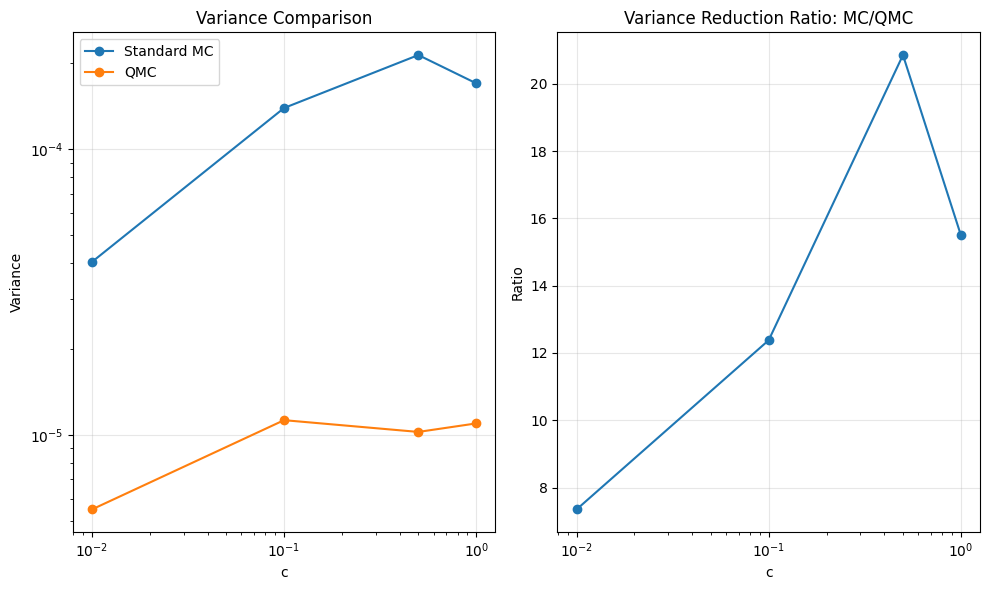

In [13]:
# Run comparison
qmc_results = compare_mc_qmc(n_sim=100, n_samples=1000, c_values=[1.0, 0.5, 0.1, 0.01])

# Visualize results
def plot_qmc_comparison(results):
    """Plot comparison of QMC with standard MC"""
    c_values = list(results.keys())

    # Plot variance comparison
    plt.figure(figsize=(10, 6))

    std_variances = [results[c]['standard_mc']['variance'] for c in c_values]
    qmc_variances = [results[c]['qmc']['variance'] for c in c_values]

    plt.subplot(1, 2, 1)
    plt.plot(c_values, std_variances, 'o-', label='Standard MC')
    plt.plot(c_values, qmc_variances, 'o-', label='QMC')
    plt.title('Variance Comparison')
    plt.xlabel('c')
    plt.ylabel('Variance')
    plt.xscale('log')
    plt.yscale('log')
    plt.legend()
    plt.grid(alpha=0.3)

    # Plot variance reduction ratio
    plt.subplot(1, 2, 2)
    var_reduction = [results[c]['standard_mc']['variance'] / results[c]['qmc']['variance'] for c in c_values]
    plt.plot(c_values, var_reduction, 'o-')
    plt.title('Variance Reduction Ratio: MC/QMC')
    plt.xlabel('c')
    plt.ylabel('Ratio')
    plt.xscale('log')
    plt.grid(alpha=0.3)

    plt.tight_layout()

    return

# Plot QMC comparison
plot_qmc_comparison(qmc_results)

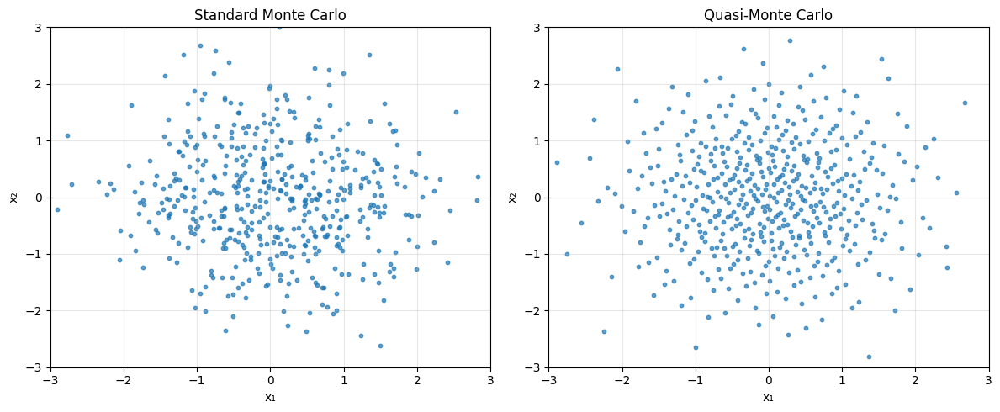

In [14]:
def visualize_point_distribution(n=500, d=2):
    """Visualize the distribution of points in standard MC vs QMC"""
    # Generate standard MC points
    X_mc = np.random.normal(0, 1, (n, d))

    # Generate QMC points
    from scipy.stats import qmc
    sampler = qmc.Sobol(d=d, scramble=True)
    samples = sampler.random(n)
    X_qmc = stats.norm.ppf(samples)

    # Create plots
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.scatter(X_mc[:, 0], X_mc[:, 1], s=10, alpha=0.7)
    plt.title("Standard Monte Carlo")
    plt.xlabel("x₁")
    plt.ylabel("x₂")
    plt.xlim(-3, 3)
    plt.ylim(-3, 3)
    plt.grid(alpha=0.3)

    plt.subplot(1, 2, 2)
    plt.scatter(X_qmc[:, 0], X_qmc[:, 1], s=10, alpha=0.7)
    plt.title("Quasi-Monte Carlo")
    plt.xlabel("x₁")
    plt.ylabel("x₂")
    plt.xlim(-3, 3)
    plt.ylim(-3, 3)
    plt.grid(alpha=0.3)

    plt.tight_layout()

    return

# Visualize point distributions
visualize_point_distribution(n=500)

In [15]:
def comprehensive_comparison(n_sim=100, n_samples=1000, d=2, c_values=[1.0, 0.5, 0.1, 0.01]):
    """
    Compare all Monte Carlo methods across different values of c

    Parameters:
    n_sim (int): Number of simulations
    n_samples (int): Number of samples per simulation
    d (int): Dimension
    c_values (list): List of c values to test

    Returns:
    dict: Results including means and variances for each method and c value
    """
    results = {}

    for c in c_values:
        results[c] = {
            'standard_mc': {'estimates': np.zeros(n_sim)},
            'control_variate': {'estimates': np.zeros(n_sim)},
            'qmc': {'estimates': np.zeros(n_sim)}
        }

        for i in tqdm(range(n_sim), desc=f"Running simulations for c={c}"):
            # Standard MC
            X = np.random.normal(0, 1, (n_samples, d))
            products = np.abs(X[:, 0] * X[:, 1])  # For d=2
            Y = products <= c
            results[c]['standard_mc']['estimates'][i] = np.mean(Y)

            # Control Variate
            Z = products - 2/np.pi
            beta = -np.cov(Y.astype(float), Z)[0, 1] / np.var(Z)
            results[c]['control_variate']['estimates'][i] = np.mean(Y + beta * Z)

            # QMC
            qmc_prob, _, _, _ = qmc_estimation(n_samples, d, c)
            results[c]['qmc']['estimates'][i] = qmc_prob

        # Calculate statistics
        for method in results[c]:
            results[c][method]['mean'] = np.mean(results[c][method]['estimates'])
            results[c][method]['variance'] = np.var(results[c][method]['estimates'])
            results[c][method]['std'] = np.std(results[c][method]['estimates'])

    return results

# Run comprehensive comparison
comprehensive_results = comprehensive_comparison(n_sim=50, n_samples=1000, c_values=[1.0, 0.5, 0.1, 0.01])

Running simulations for c=1.0:   0%|          | 0/50 [00:00<?, ?it/s]

Running simulations for c=0.5:   0%|          | 0/50 [00:00<?, ?it/s]

Running simulations for c=0.1:   0%|          | 0/50 [00:00<?, ?it/s]

Running simulations for c=0.01:   0%|          | 0/50 [00:00<?, ?it/s]

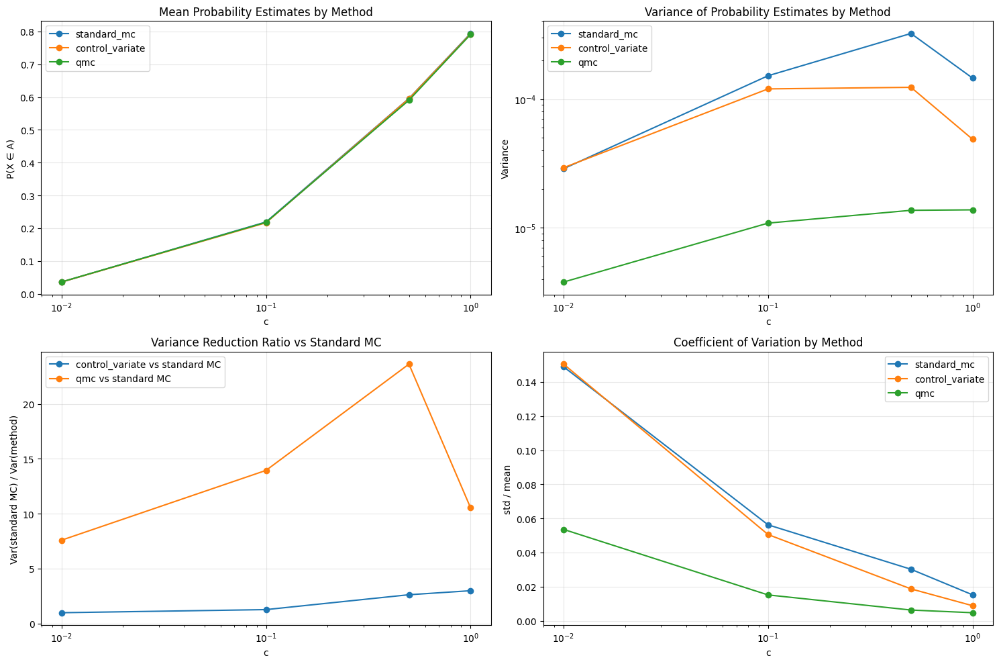

In [18]:
def plot_comprehensive_comparison(results):
    """Plot comparison of all methods"""
    c_values = list(results.keys())
    methods = list(results[c_values[0]].keys())

    # Plot means
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    for method in methods:
        means = [results[c][method]['mean'] for c in c_values]
        plt.plot(c_values, means, 'o-', label=method)

    plt.title('Mean Probability Estimates by Method')
    plt.xlabel('c')
    plt.ylabel('P(X ∈ A)')
    plt.xscale('log')
    plt.grid(alpha=0.3)
    plt.legend()

    # Plot variances
    plt.subplot(2, 2, 2)
    for method in methods:
        variances = [results[c][method]['variance'] for c in c_values]
        plt.plot(c_values, variances, 'o-', label=method)

    plt.title('Variance of Probability Estimates by Method')
    plt.xlabel('c')
    plt.ylabel('Variance')
    plt.xscale('log')
    plt.yscale('log')
    plt.grid(alpha=0.3)
    plt.legend()

    # Plot variance reduction ratio vs standard MC
    plt.subplot(2, 2, 3)
    for method in methods:
        if method != 'standard_mc':
            var_reduction = [results[c]['standard_mc']['variance'] / results[c][method]['variance'] for c in c_values]
            plt.plot(c_values, var_reduction, 'o-', label=f'{method} vs standard MC')

    plt.title('Variance Reduction Ratio vs Standard MC')
    plt.xlabel('c')
    plt.ylabel('Var(standard MC) / Var(method)')
    plt.xscale('log')
    plt.grid(alpha=0.3)
    plt.legend()

    # Plot coefficient of variation
    plt.subplot(2, 2, 4)
    for method in methods:
        cv = [results[c][method]['std'] / results[c][method]['mean'] for c in c_values]
        plt.plot(c_values, cv, 'o-', label=method)

    plt.title('Coefficient of Variation by Method')
    plt.xlabel('c')
    plt.ylabel('std / mean')
    plt.xscale('log')
    plt.grid(alpha=0.3)
    plt.legend()

    plt.tight_layout()

    return

# Plot comprehensive comparison
plot_comprehensive_comparison(comprehensive_results)

# Quasi-Monte Carlo (QMC) Method

## Introduction

Quasi-Monte Carlo (QMC) methods are deterministic alternatives to Monte Carlo methods. While traditional Monte Carlo uses random (or pseudo-random) samples, QMC uses low-discrepancy sequences to ensure more uniform coverage of the integration domain. This leads to potentially faster convergence rates, especially for problems with moderate dimensions.

## Mathematical Foundation

Given an integral:

$$I = \int_{[0,1]^d} f(\mathbf{x}) \, d\mathbf{x}$$

The standard Monte Carlo estimator is:

$$\hat{I}_{MC} = \frac{1}{n} \sum_{i=1}^{n} f(\mathbf{X}_i)$$

where $\mathbf{X}_i$ are independent random samples from $[0,1]^d$.

The QMC estimator has the same form:

$$\hat{I}_{QMC} = \frac{1}{n} \sum_{i=1}^{n} f(\mathbf{x}_i)$$

But here, $\mathbf{x}_i$ are points from a low-discrepancy sequence.

## Low-Discrepancy Sequences

The discrepancy of a point set $P = \{\mathbf{x}_1, \mathbf{x}_2, \ldots, \mathbf{x}_n\}$ in $[0,1]^d$ is defined as:

$$D_n(P) = \sup_{B \in B} \left| \frac{A(B; P)}{n} - \lambda(B) \right|$$

where:
- $B$ is the set of all boxes $[0, \mathbf{t}) = [0, t_1) \times [0, t_2) \times \cdots \times [0, t_d)$
- $A(B; P)$ is the number of points in $P$ that fall into $B$
- $\lambda(B)$ is the Lebesgue measure (volume) of $B$

Common low-discrepancy sequences include:
- Sobol sequences
- Halton sequences
- Faure sequences

## Convergence Rates

The error bounds for Monte Carlo and QMC integration are:

1. **Monte Carlo**: With probability at least $1-\delta$, the error is bounded by:

   $$|I - \hat{I}_{MC}| \leq O\left( \frac{\sigma}{\sqrt{n}} \right)$$

   where $\sigma^2$ is the variance of $f(\mathbf{X})$.

2. **Quasi-Monte Carlo**: For functions with bounded variation in the sense of Hardy and Krause:

   $$|I - \hat{I}_{QMC}| \leq V(f) \cdot D_n^*(P)$$

   where $V(f)$ is the variation of $f$ and $D_n^*(P)$ is the star-discrepancy of $P$.

For well-constructed low-discrepancy sequences, we have:

$$D_n^*(P) \leq O\left( \frac{(\log n)^d}{n} \right)$$

leading to an asymptotic convergence rate of:

$$|I - \hat{I}_{QMC}| \leq O\left( \frac{(\log n)^d}{n} \right)$$

## Comparison of Theoretical Convergence Rates

- **Monte Carlo**: $O(n^{-1/2})$, independent of dimension
- **Quasi-Monte Carlo**: $O(n^{-1}(\log n)^d)$, depends on dimension

For low to moderate dimensions, the QMC rate is superior despite the $(\log n)^d$ factor. However, as dimensions increase, the so-called "curse of dimensionality" can make QMC less effective compared to standard MC.

## Randomized Quasi-Monte Carlo (RQMC)

To combine the advantages of both approaches, RQMC introduces randomness into low-discrepancy sequences, allowing for:
- Error estimation via replication
- Unbiased estimators
- Probabilistic error bounds

The typical RQMC error convergence rate is:

$$|I - \hat{I}_{RQMC}| \leq O\left( \frac{1}{n^{3/2-\epsilon}} \right)$$

for any $\epsilon > 0$ and smooth enough integrands.

## Application to Our Problem

For the probability estimation problem where:
- $X \sim N_d(0, I_d)$ (standard Gaussian distribution)
- $A = \{(x_1, \ldots, x_d), \prod_{i=1}^d |x_i| \leq c\}$

The QMC approach involves:

1. Generating a low-discrepancy sequence $\{\mathbf{u}_i\}$ in $[0,1]^d$
2. Transforming to the standard Gaussian distribution using the inverse CDF: $\mathbf{x}_i = \Phi^{-1}(\mathbf{u}_i)$
3. Estimating the probability as:

$$P(X \in A) \approx \frac{1}{n} \sum_{i=1}^{n} \mathbf{1}_{\{\prod_{j=1}^{d} |x_{ij}| \leq c\}}$$

This approach typically yields lower variance estimates compared to standard Monte Carlo, especially for moderate dimensions and small values of $c$.

# Bivariate Normal Distribution Analysis

## 1. Distribution Identification

The PDF presented is:

$$p(x_1, x_2) = \frac{1}{2\pi\sqrt{1-\rho^2}}\exp\left(-\frac{1}{2(1-\rho^2)}(x_1^2 + x_2^2 - 2\rho x_1 x_2)\right)$$

This is a bivariate normal distribution with:
- Mean vector $\mu = (0, 0)$
- Covariance matrix $\Sigma = \begin{pmatrix} 1 & \rho \\ \rho & 1 \end{pmatrix}$

Where $\rho$ represents the correlation coefficient between $x_1$ and $x_2$.

## 2. Conditional Distributions and Gibbs Sampler

For a bivariate normal distribution, the conditional distributions are also normal:

- $X_1 | X_2 = x_2 \sim Normal(\rho x_2, 1-\rho^2)$
- $X_2 | X_1 = x_1 \sim Normal(\rho x_1, 1-\rho^2)$

This makes the Gibbs sampler particularly straightforward to implement, as we can sample directly from these conditional distributions.

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy import stats
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from tqdm.notebook import tqdm

# Set random seed for reproducibility
np.random.seed(42)

In [36]:
def gibbs_sampler_bivariate_normal(n_samples, rho):
    """
    Gibbs sampler for bivariate normal distribution

    Parameters:
    n_samples (int): Number of samples to generate
    rho (float): Correlation coefficient, must be in [-1, 1]

    Returns:
    np.array: Array of shape (n_samples, 2) containing the samples
    """
    # Initialize arrays to store samples
    X = np.zeros((n_samples, 2))

    # Standard deviation for conditional distributions
    sd_cond = np.sqrt(1 - rho**2)

    # Gibbs sampling
    for i in range(1, n_samples):
        # Sample x_1 given x_2
        X[i, 0] = np.random.normal(rho * X[i-1, 1], sd_cond)

        # Sample x_2 given x_1
        X[i, 1] = np.random.normal(rho * X[i, 0], sd_cond)

    return X

(<Figure size 1000x800 with 1 Axes>,
 <Axes: title={'center': 'Bivariate Normal Distribution Contours (ρ = 0.5)'}, xlabel='$x_1$', ylabel='$x_2$'>)

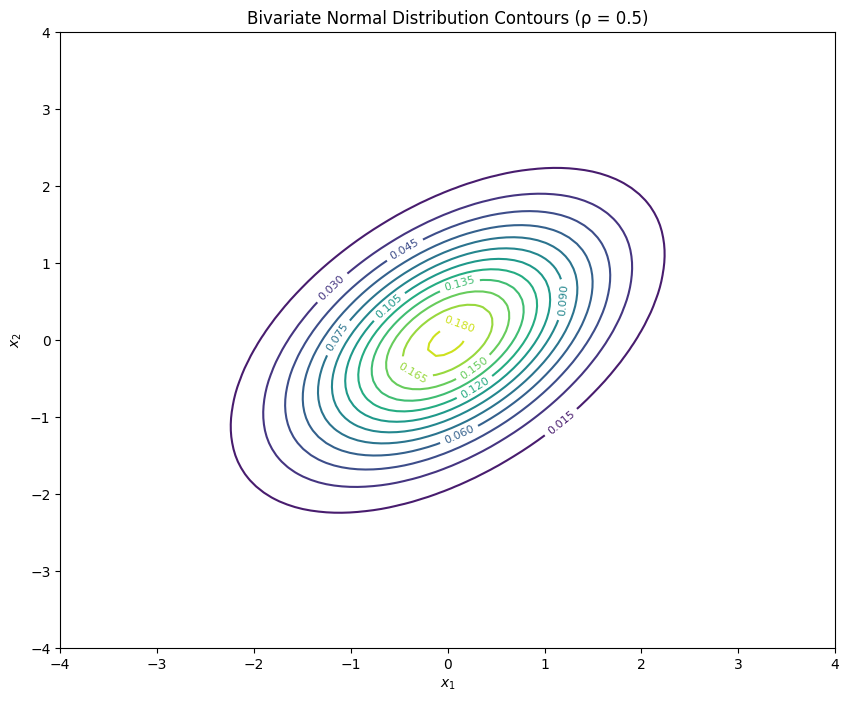

In [31]:
def plot_bivariate_normal_contours(rho, xlim=(-4, 4), ylim=(-4, 4), n_grid=100):
    """
    Plot contours of the bivariate normal distribution

    Parameters:
    rho (float): Correlation coefficient
    xlim, ylim (tuple): Limits for x and y axes
    n_grid (int): Number of grid points for contour plot

    Returns:
    fig, ax: The figure and axis objects
    """
    # Create grid
    x = np.linspace(xlim[0], xlim[1], n_grid)
    y = np.linspace(ylim[0], ylim[1], n_grid)
    X, Y = np.meshgrid(x, y)

    # Create meshgrid of positions
    pos = np.dstack((X, Y))

    # Create bivariate normal distribution
    rv = stats.multivariate_normal([0, 0], [[1, rho], [rho, 1]])

    # Calculate PDF values
    Z = rv.pdf(pos)

    # Create plot
    fig, ax = plt.subplots(figsize=(10, 8))

    # Plot contours
    contour = ax.contour(X, Y, Z, levels=15, cmap=cm.viridis)
    ax.clabel(contour, inline=True, fontsize=8)

    # Add labels and title
    ax.set_xlabel('$x_1$')
    ax.set_ylabel('$x_2$')
    ax.set_title(f'Bivariate Normal Distribution Contours (ρ = {rho})')

    return fig, ax

rho=0.5
plot_bivariate_normal_contours(rho)

In [54]:
def run_and_visualize_gibbs(rho, n_samples=10000, burn_in=1000):
    """
    Run Gibbs sampler and visualize the results

    Parameters:
    rho (float): Correlation coefficient
    n_samples (int): Number of samples to generate
    burn_in (int): Number of initial samples to discard

    Returns:
    np.array: Samples after burn-in
    """
    # Run Gibbs sampler
    samples = gibbs_sampler_bivariate_normal(n_samples, rho)

    # Apply burn-in
    samples_after_burnin = samples[burn_in:]

    # Create contour plot
    fig, ax = plot_bivariate_normal_contours(rho)

    # Plot the first 1000 steps of the chain as a path
    max_path = min(1000, len(samples) - burn_in)
    ax.plot(samples[burn_in:burn_in+max_path, 0], samples[burn_in:burn_in+max_path, 1],
            'r-', alpha=0.7, linewidth=0.8, label='Markov Chain Path')

    ax.legend()
    plt.tight_layout()
    plt.show()

    # Plot autocorrelation
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plot_acf(samples[:, 0], lags=50)
    plt.title(f'Autocorrelation of $X_1$ (ρ = {rho})')

    plt.subplot(1, 2, 2)
    plot_acf(samples[:, 1], lags=50)
    plt.title(f'Autocorrelation of $X_2$ (ρ = {rho})')

    plt.tight_layout()
    plt.show()

    return samples_after_burnin

### Effect of ρ Approaching 1

As ρ approaches 1, several interesting phenomena occur:

1. The contours of the bivariate normal become increasingly elongated along the line $x_1 = x_2$.

2. The conditional variance $(1-\rho^2)$ becomes very small, meaning the conditional distributions become very narrow.

3. The Gibbs sampler moves in increasingly small steps in each direction, leading to:
   - Highly autocorrelated samples
   - Very slow exploration of the target distribution
   - Requires many more iterations to cover the distribution adequately

This is a classic example of how Gibbs sampling can be inefficient for highly correlated variables.

In [44]:
def bivariate_normal_pdf(x, rho):
    """
    Calculate PDF of bivariate normal distribution at point x = (x1, x2)

    Parameters:
    x (array): Point where to evaluate the PDF
    rho (float): Correlation coefficient

    Returns:
    float: PDF value
    """
    x1, x2 = x
    term = (x1**2 + x2**2 - 2*rho*x1*x2) / (1 - rho**2)
    return (1 / (2 * np.pi * np.sqrt(1 - rho**2))) * np.exp(-0.5 * term)

In [45]:
def rwhm_bivariate_normal(n_samples, rho, proposal_cov):
    """
    Random Walk Hastings-Metropolis for bivariate normal distribution

    Parameters:
    n_samples (int): Number of samples to generate
    rho (float): Correlation coefficient
    proposal_cov (np.array): 2x2 covariance matrix for the proposal distribution

    Returns:
    np.array: Array of shape (n_samples, 2) containing the samples
    dict: Additional information about the run
    """
    # Initialize arrays to store samples and acceptance
    X = np.zeros((n_samples, 2))
    accepted = np.zeros(n_samples, dtype=bool)

    # Start from the origin
    X[0] = [0, 0]

    # RWHM algorithm
    for i in range(1, n_samples):
        # Generate proposal
        proposal = X[i-1] + np.random.multivariate_normal([0, 0], proposal_cov)

        # Calculate acceptance ratio
        current_pdf = bivariate_normal_pdf(X[i-1], rho)
        proposal_pdf = bivariate_normal_pdf(proposal, rho)

        # Accept or reject
        if proposal_pdf / current_pdf > np.random.random():
            X[i] = proposal
            accepted[i] = True
        else:
            X[i] = X[i-1]

    # Calculate acceptance rate
    acceptance_rate = np.mean(accepted[1:])

    return X, {"acceptance_rate": acceptance_rate}

In [52]:
def run_and_visualize_rwhm(rho, proposal_type="isotropic", tau=1.0, n_samples=10000, burn_in=1000):
    """
    Run RWHM and visualize the results

    Parameters:
    rho (float): Correlation coefficient
    proposal_type (str): Either "isotropic" or "adapted"
    tau (float): Scaling factor for the proposal covariance
    n_samples (int): Number of samples to generate
    burn_in (int): Number of initial samples to discard

    Returns:
    np.array: Samples after burn-in
    """
    # Set proposal covariance based on type
    if proposal_type == "isotropic":
        proposal_cov = tau * np.eye(2)
        title_suffix = f"Isotropic Proposal (τ = {tau})"
    else:  # "adapted"
        target_cov = np.array([[1, rho], [rho, 1]])
        proposal_cov = tau * target_cov
        title_suffix = f"Adapted Proposal (τ = {tau})"

    # Run RWHM
    samples, info = rwhm_bivariate_normal(n_samples, rho, proposal_cov)
    acceptance_rate = info["acceptance_rate"]

    # Apply burn-in
    samples_after_burnin = samples[burn_in:]

    # Create contour plot
    fig, ax = plot_bivariate_normal_contours(rho)

    # Plot the first 1000 steps of the chain as a path
    max_path = min(1000, len(samples) - burn_in)
    ax.plot(samples[burn_in:burn_in+max_path, 0], samples[burn_in:burn_in+max_path, 1],
            'r-', alpha=0.7, linewidth=0.8, label='Markov Chain Path')

    ax.set_title(f'RWHM: ρ = {rho}, {title_suffix}\nAcceptance Rate: {acceptance_rate:.2f}')
    ax.legend()
    plt.tight_layout()
    plt.show()

    # Plot autocorrelation
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plot_acf(samples[:, 0], lags=50)
    plt.title(f'Autocorrelation of $X_1$ (ρ = {rho})')

    plt.subplot(1, 2, 2)
    plot_acf(samples[:, 1], lags=50)
    plt.title(f'Autocorrelation of $X_2$ (ρ = {rho})')

    plt.tight_layout()
    plt.show()

    return samples_after_burnin, acceptance_rate

## 3. Random Walk Hastings-Metropolis (RWHM) Algorithm

The RWHM algorithm proposes moves using a random walk with a Gaussian proposal distribution. For each iteration:

1. Generate a proposal: $Y_{t+1} = X_t + \epsilon$ where $\epsilon \sim Normal(0, \sigma)$
2. Accept the proposal with probability: $\min\left(1, \frac{p(Y_{t+1})}{p(X_t)}\right)$

### Implementation Options:

1. **Isotropic proposal**: $\sigma = \tau I_2$ (scaled identity matrix)
   - Simple but may perform poorly with correlated variables
   
2. **Adapted proposal**: $\sigma = \tau \Sigma$ (scaled target covariance)
   - Better handles correlation structure of the target distribution

### Effect of τ (proposal scale):

- **Too small**: High acceptance rate but slow exploration (small steps)
- **Too large**: Low acceptance rate with many rejections
- **Optimal**: Theory suggests targeting ~0.234 acceptance rate in high dimensions

### Performance with high correlation (ρ→1):

When ρ approaches 1:
- Isotropic proposals perform poorly due to mismatch with target's shape
- Adapted proposals significantly outperform isotropic ones
- Proper tuning of τ becomes increasingly important


--- Gibbs Sampler: ρ = 0.5 ---


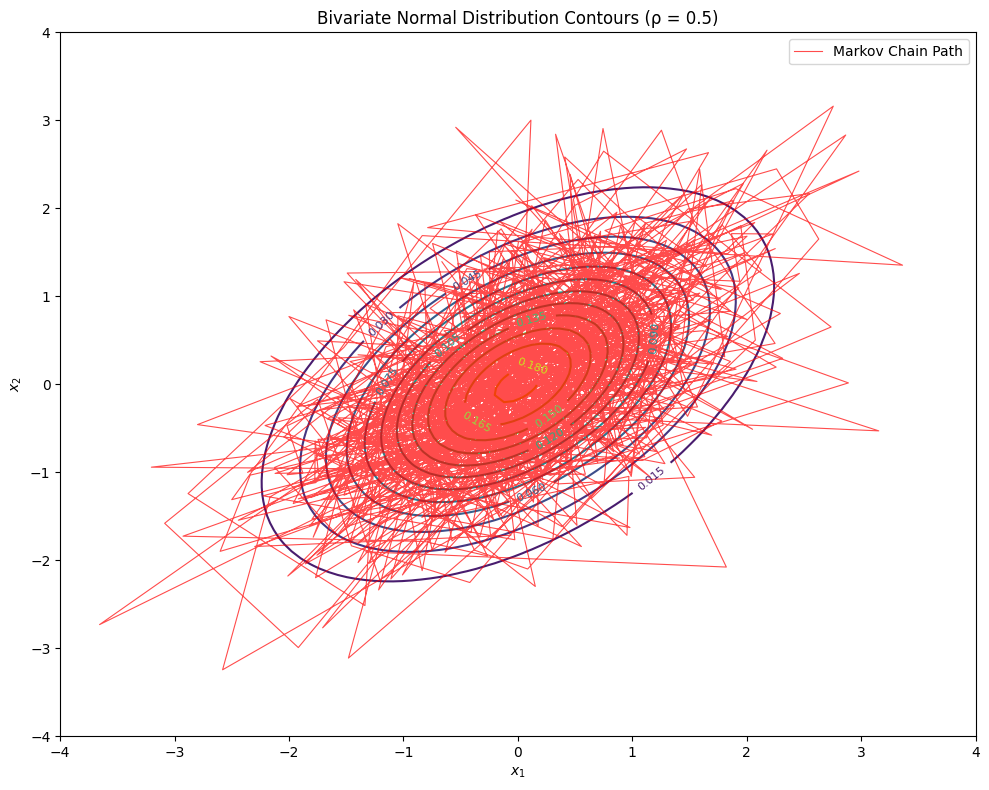

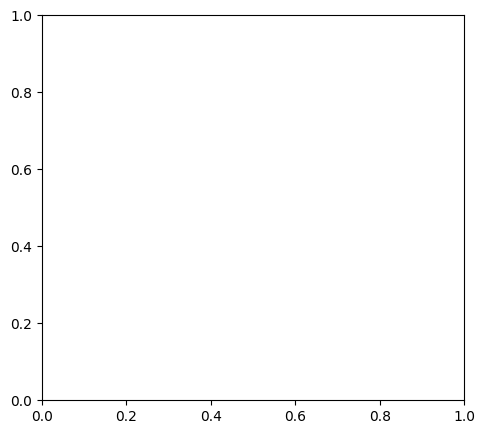

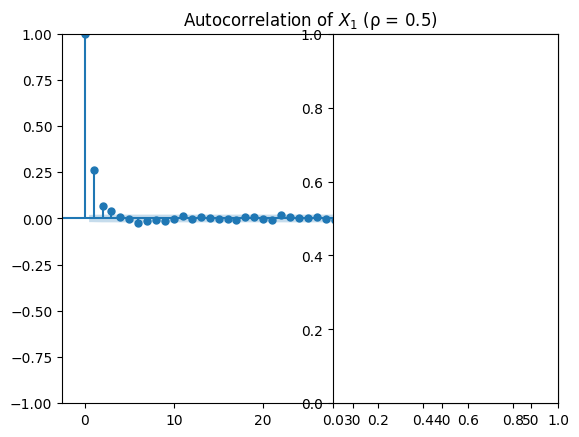

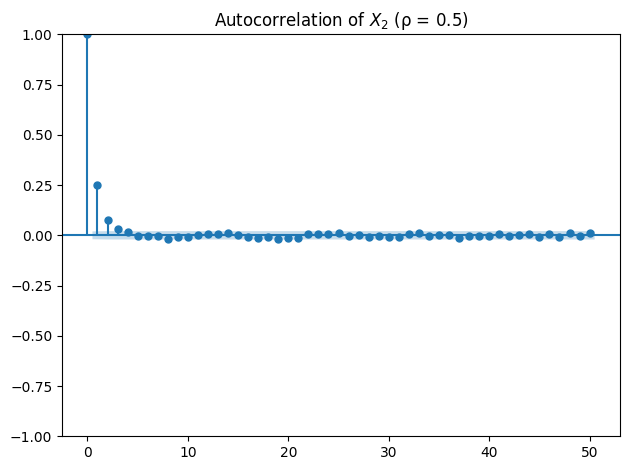


--- Gibbs Sampler: ρ = 0.9 ---


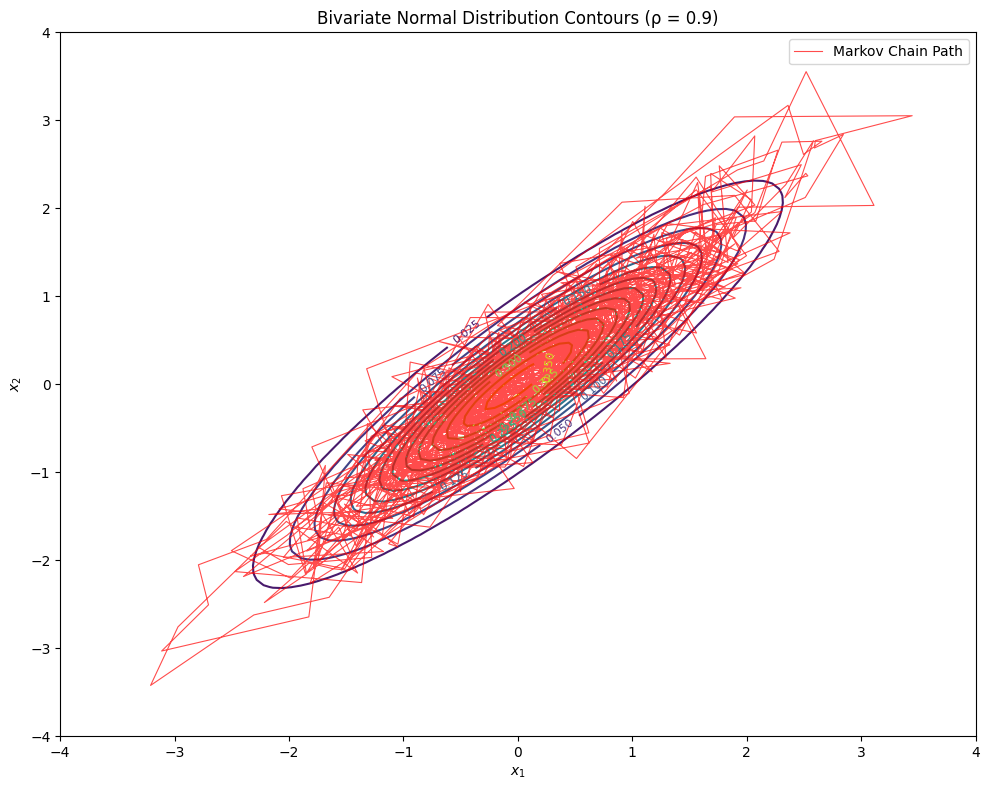

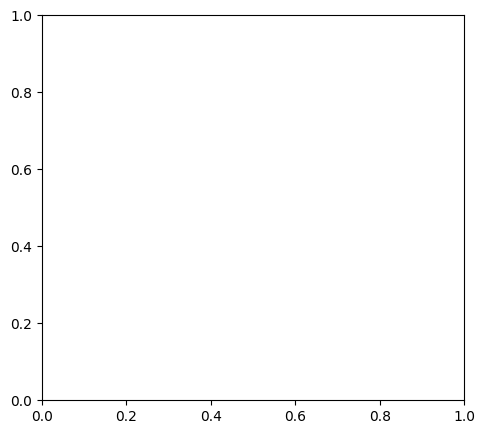

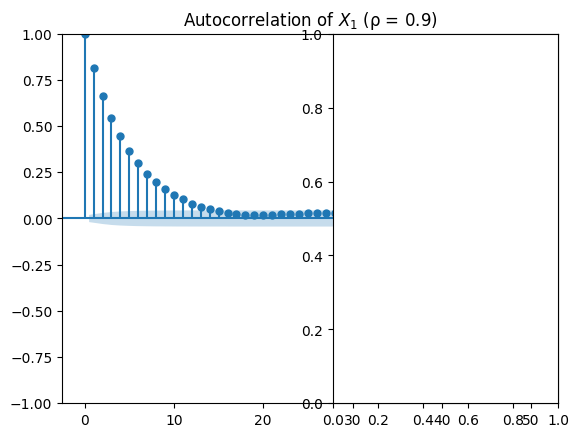

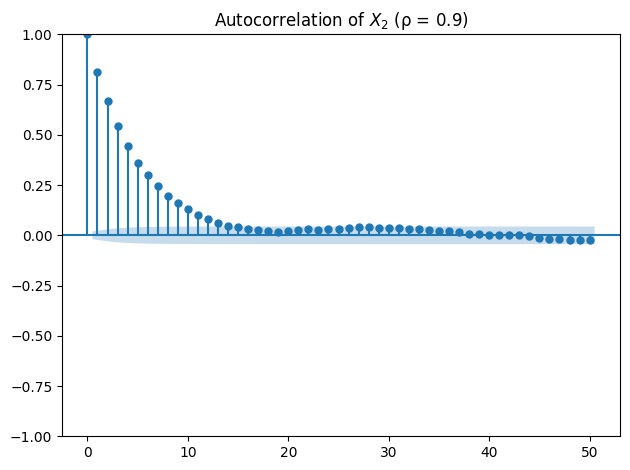


--- Gibbs Sampler: ρ = 0.99 ---


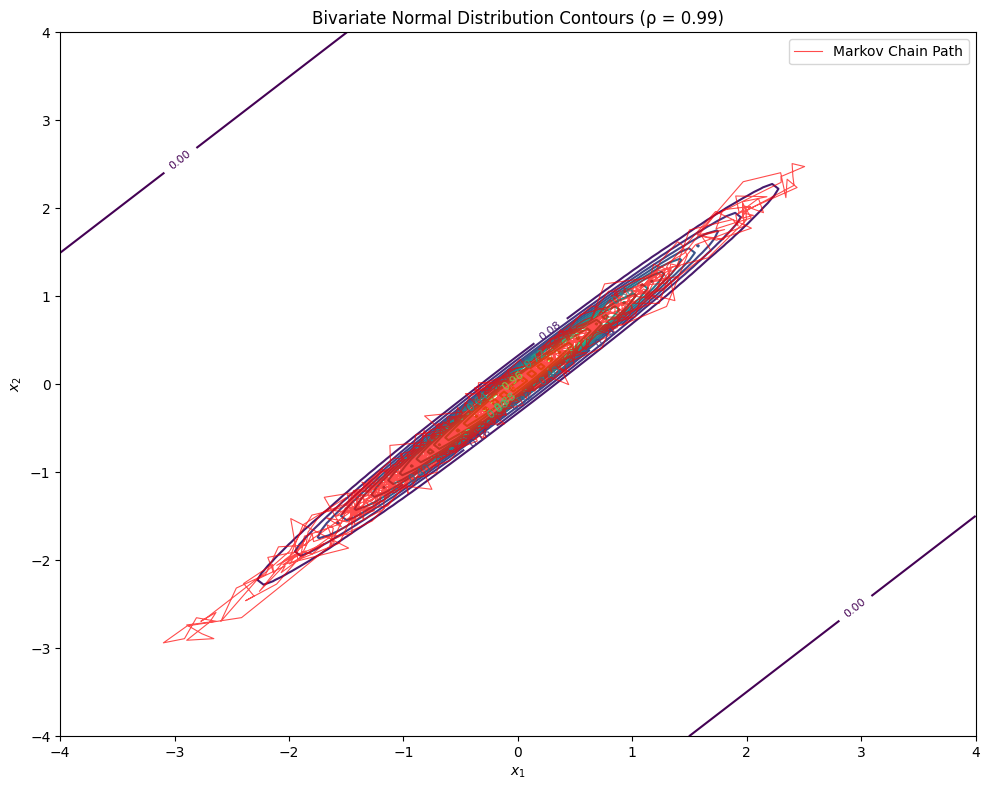

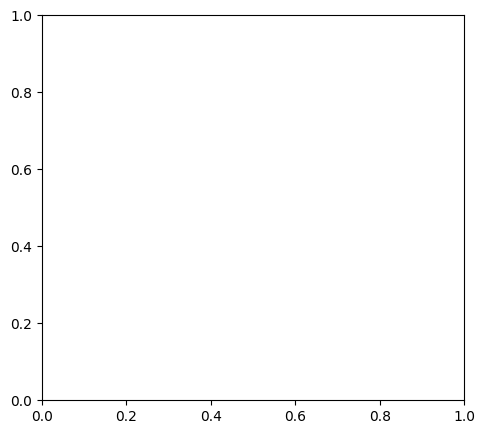

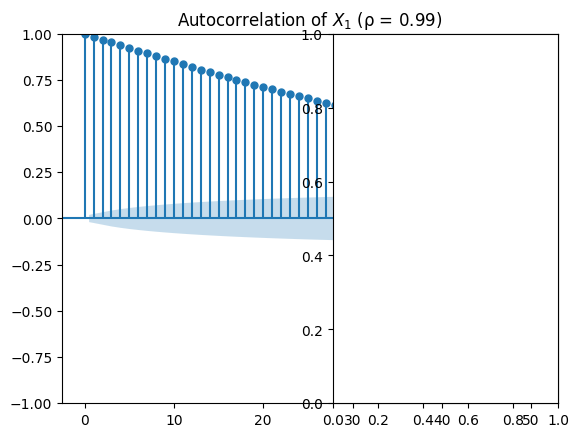

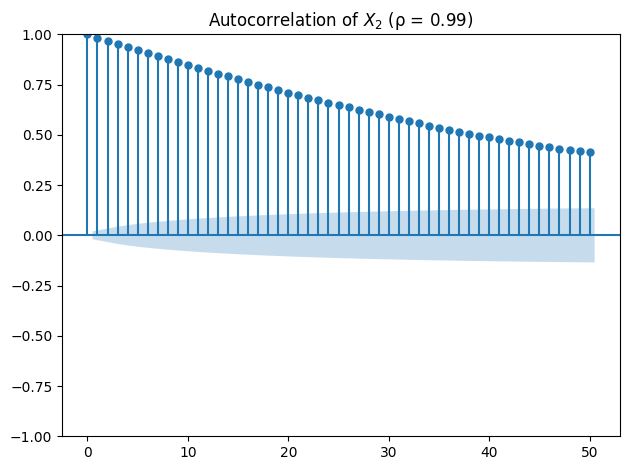

In [55]:
# Run Gibbs sampler with different correlation values
rho_values = [0.5, 0.9, 0.99]

for rho in rho_values:
    print(f"\n--- Gibbs Sampler: ρ = {rho} ---")
    _ = run_and_visualize_gibbs(rho)


--- RWHM with Isotropic Proposal: ρ = 0.5 ---
Running with τ = 0.1


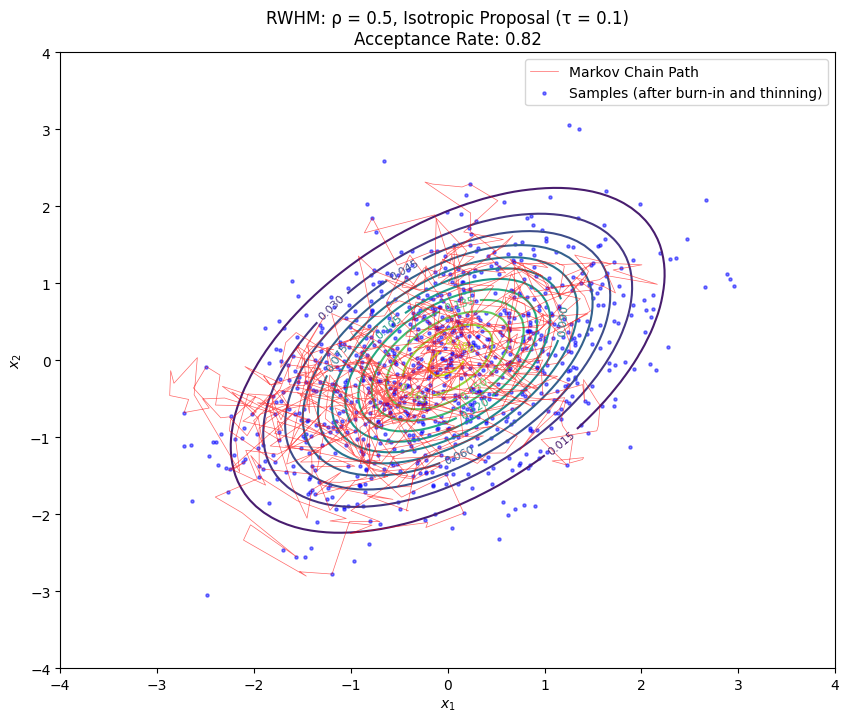

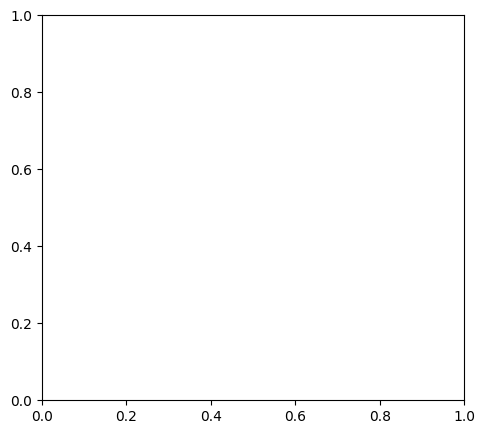

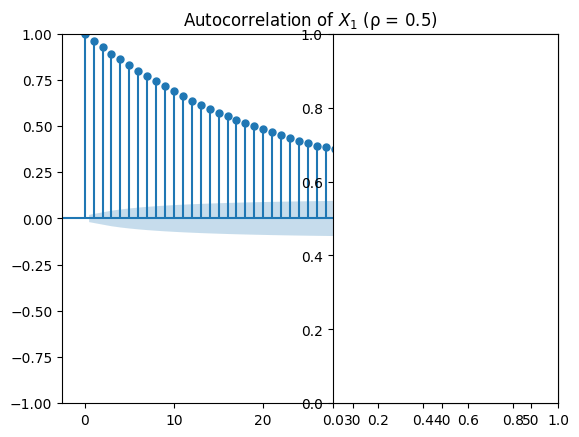

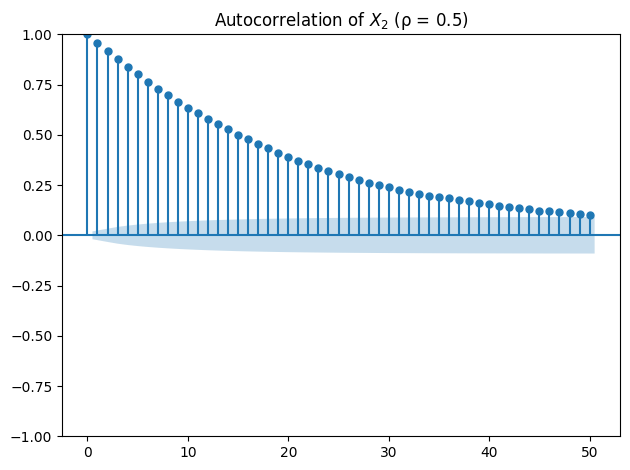

Acceptance rate: 0.8193
Running with τ = 1.0


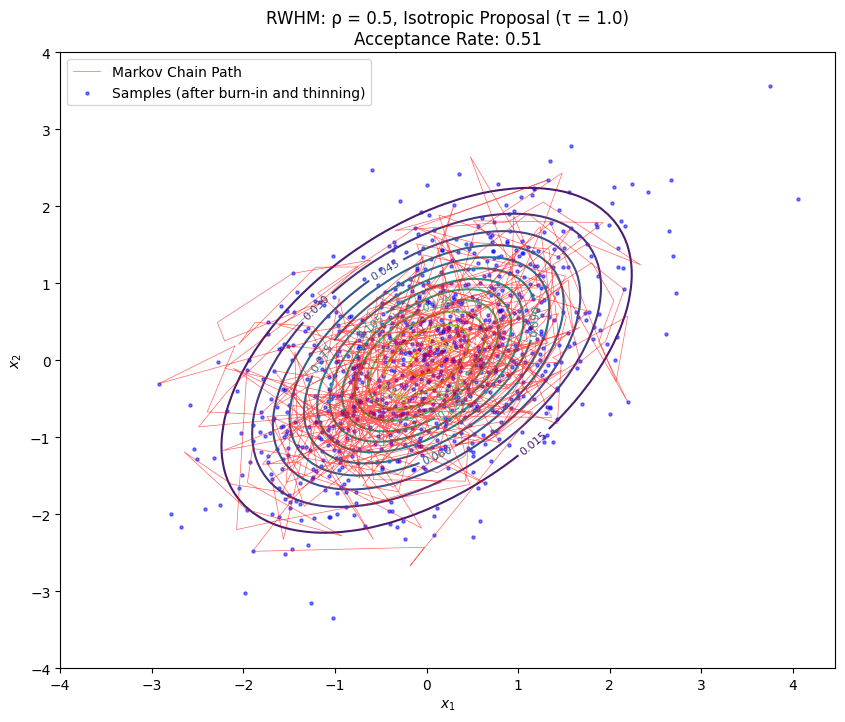

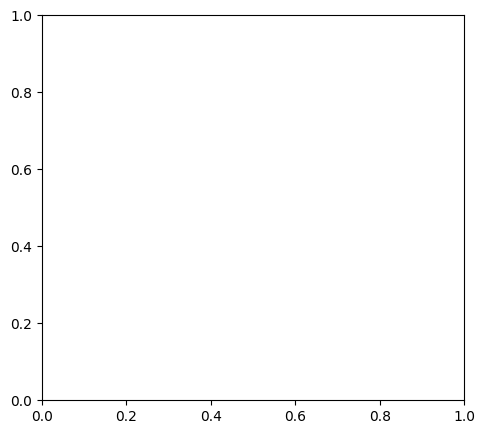

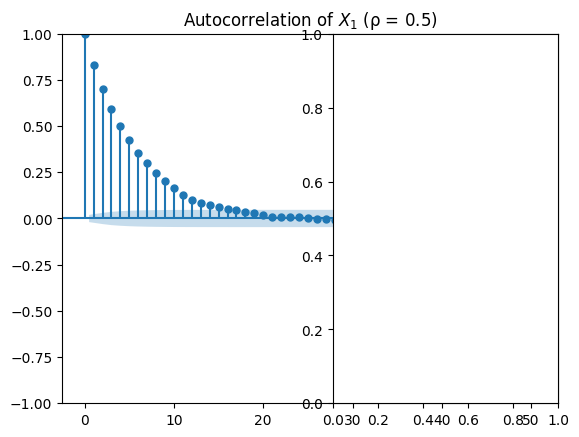

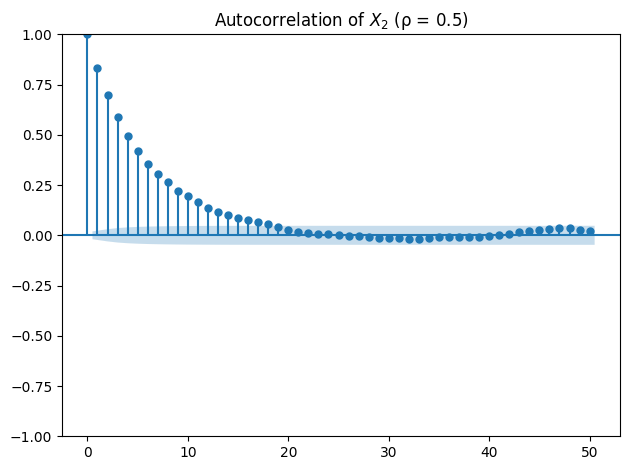

Acceptance rate: 0.5126
Running with τ = 5.0


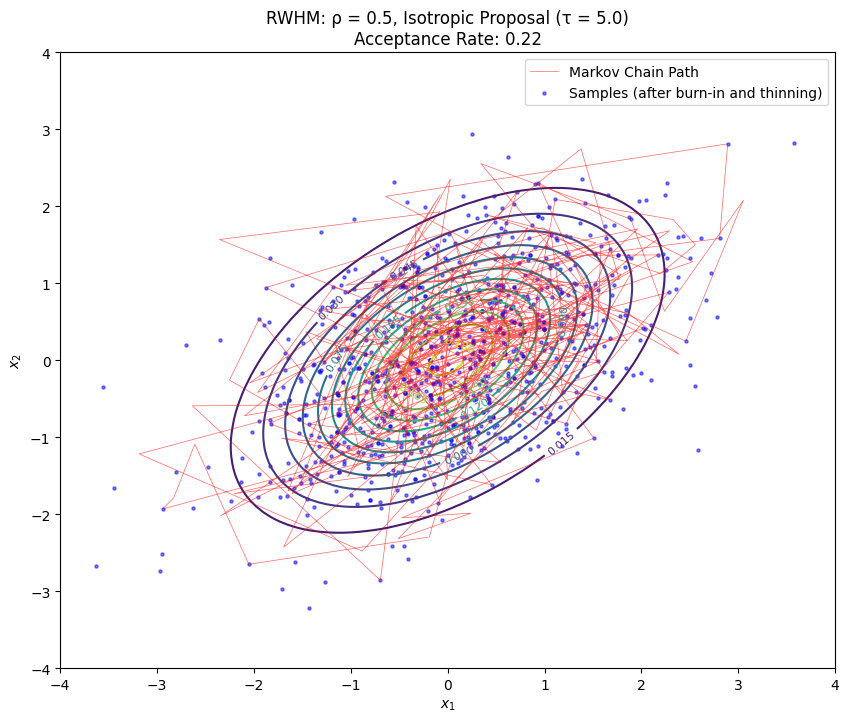

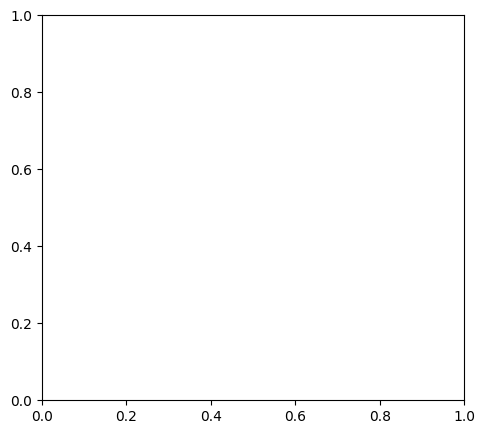

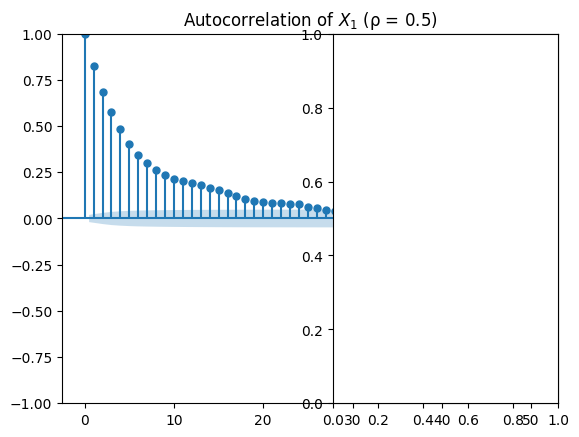

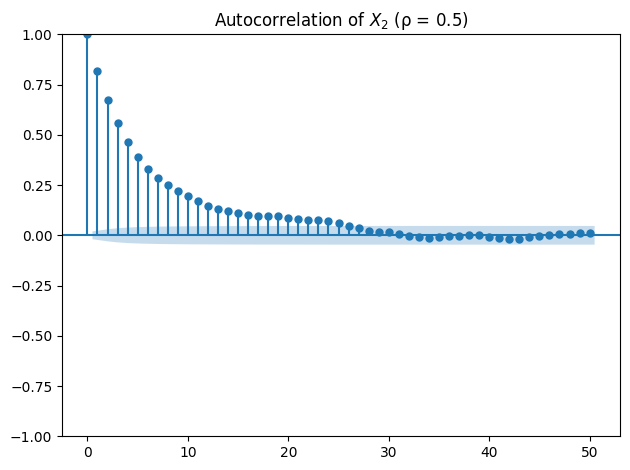

Acceptance rate: 0.2191

--- RWHM with Isotropic Proposal: ρ = 0.9 ---
Running with τ = 0.1


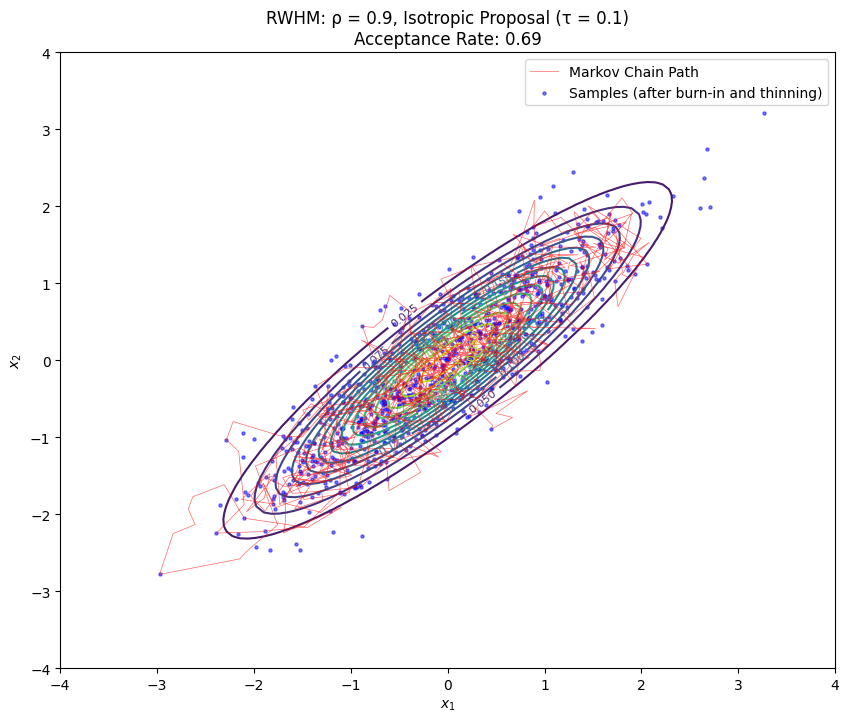

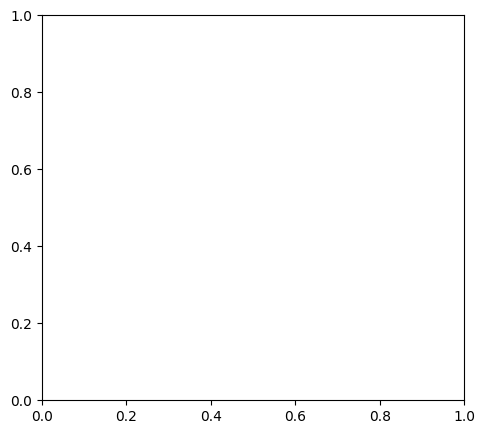

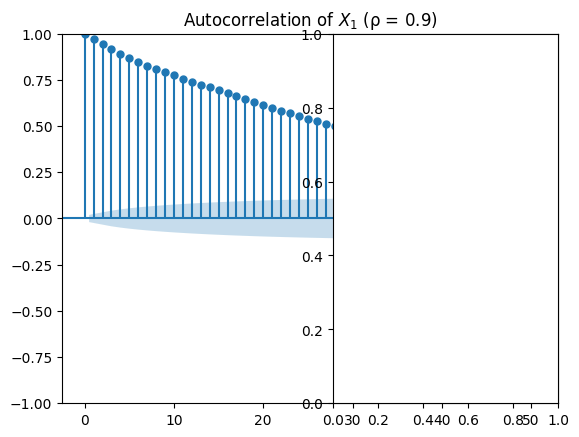

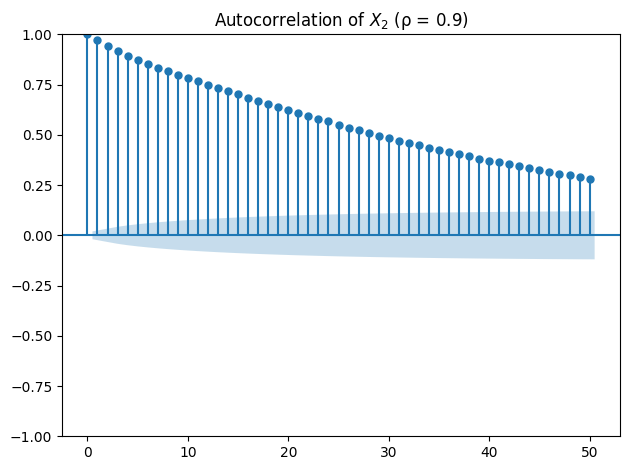

Acceptance rate: 0.6863
Running with τ = 1.0


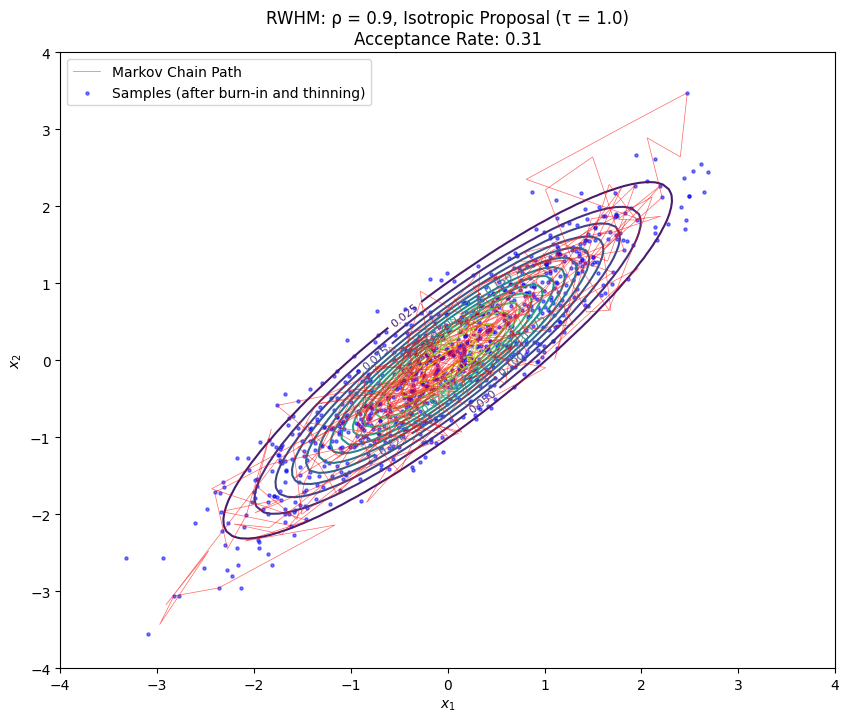

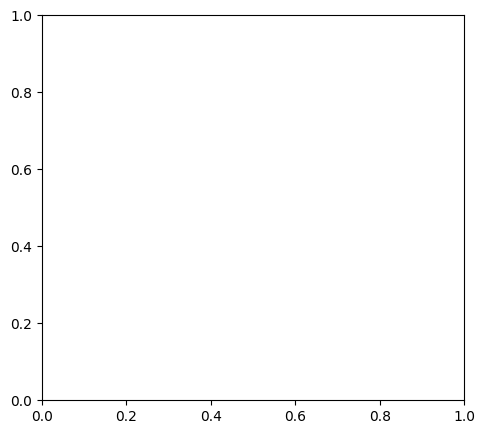

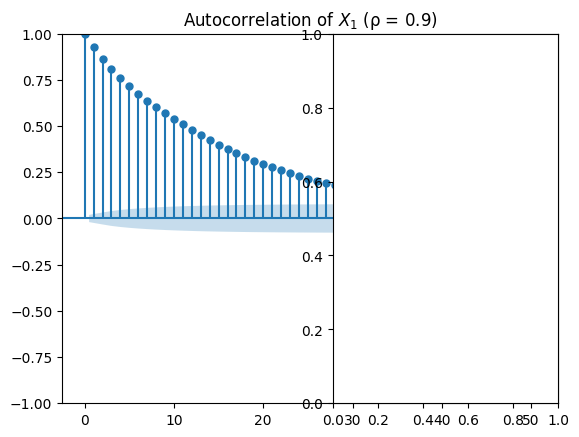

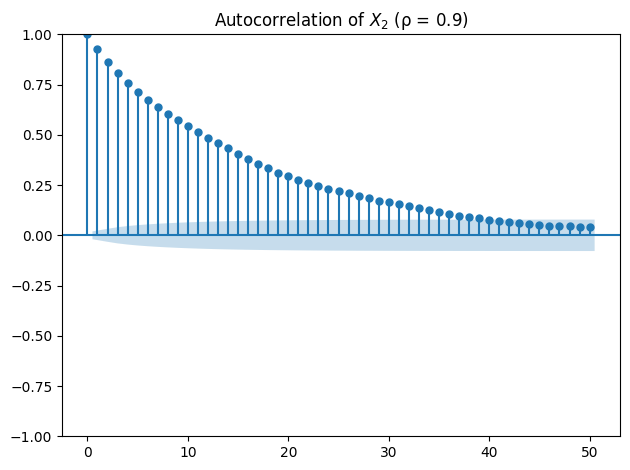

Acceptance rate: 0.3135
Running with τ = 5.0


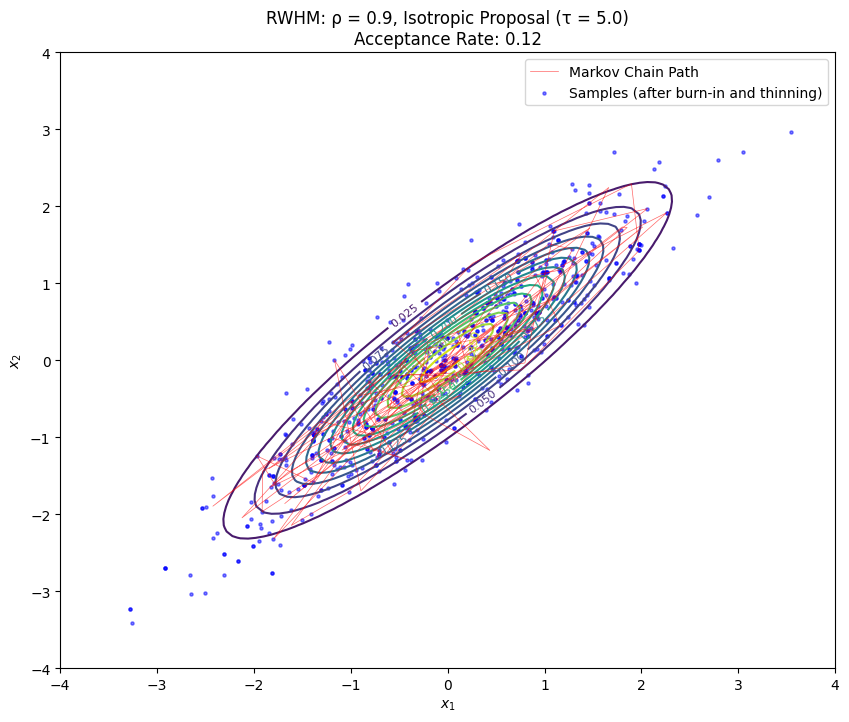

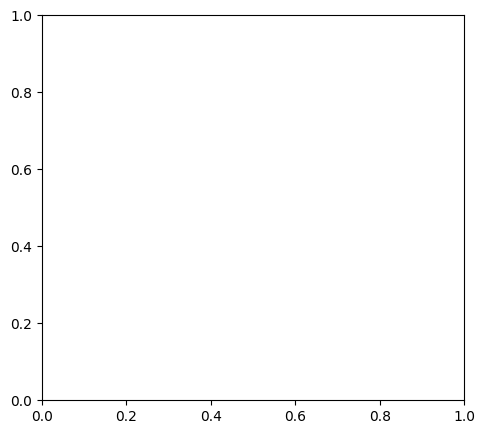

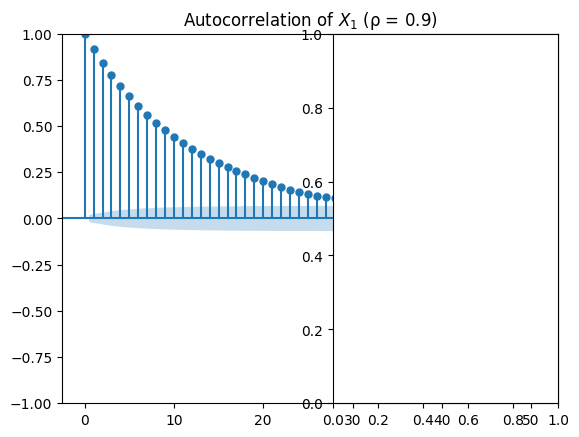

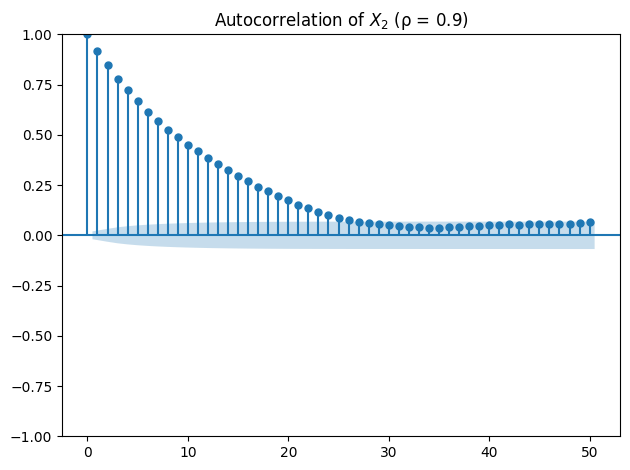

Acceptance rate: 0.1197

--- RWHM with Isotropic Proposal: ρ = 0.99 ---
Running with τ = 0.1


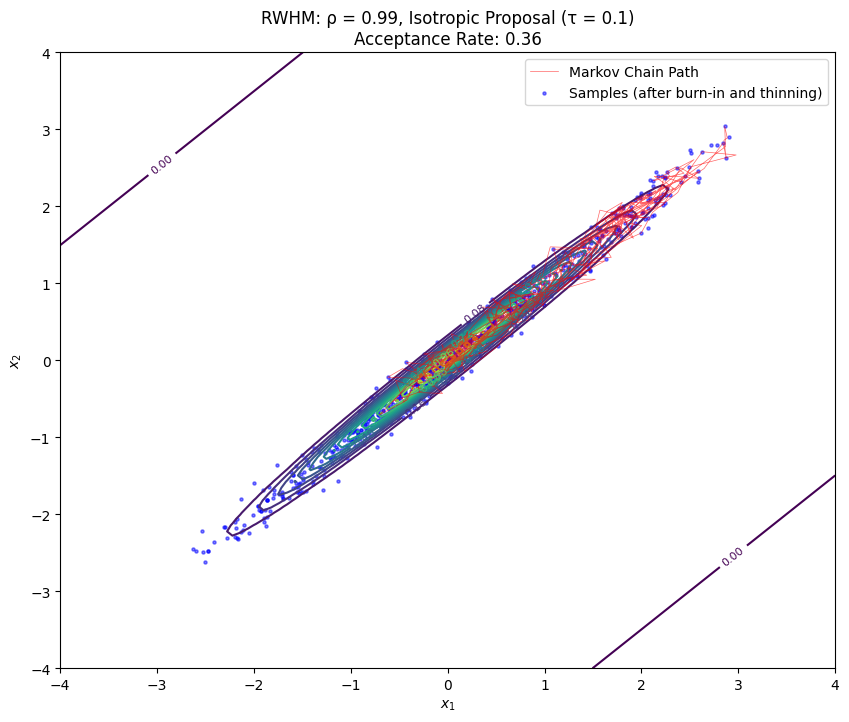

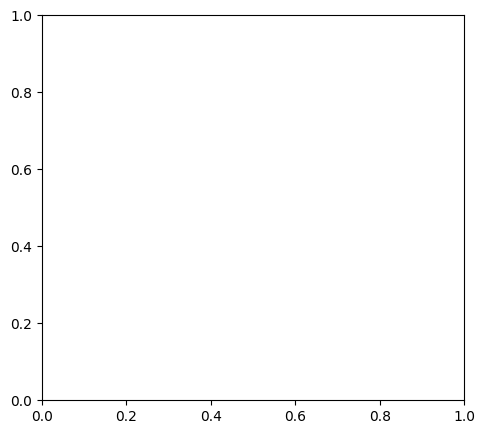

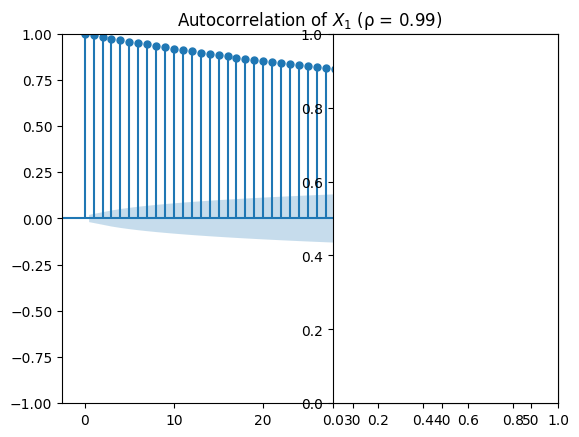

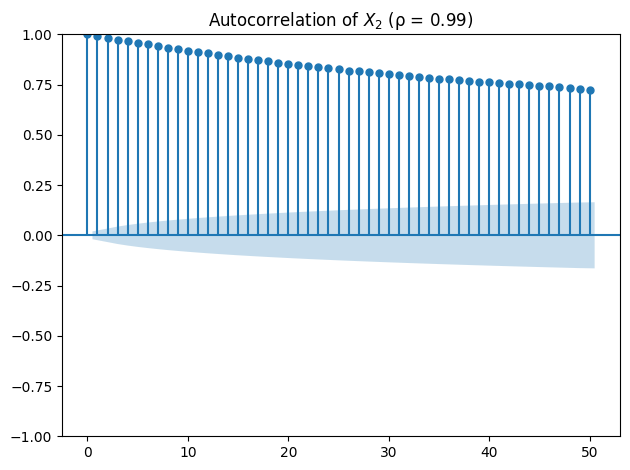

Acceptance rate: 0.3580
Running with τ = 1.0


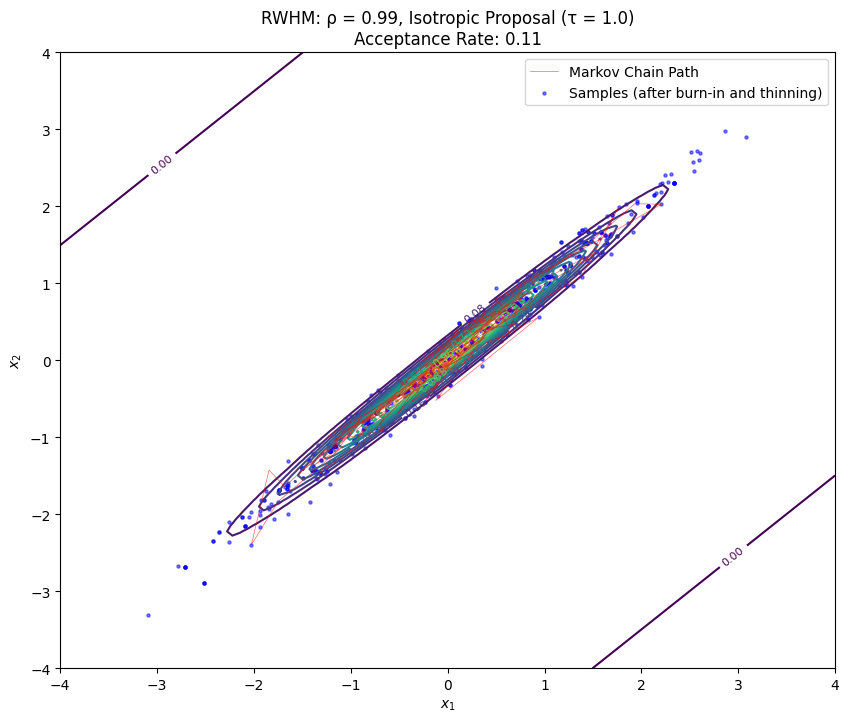

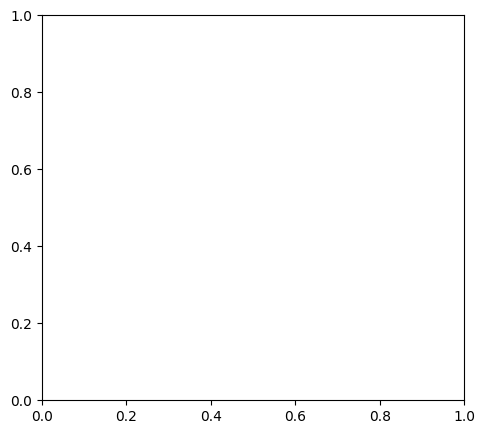

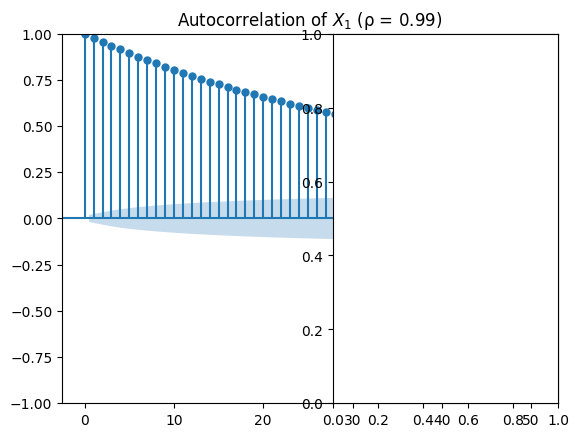

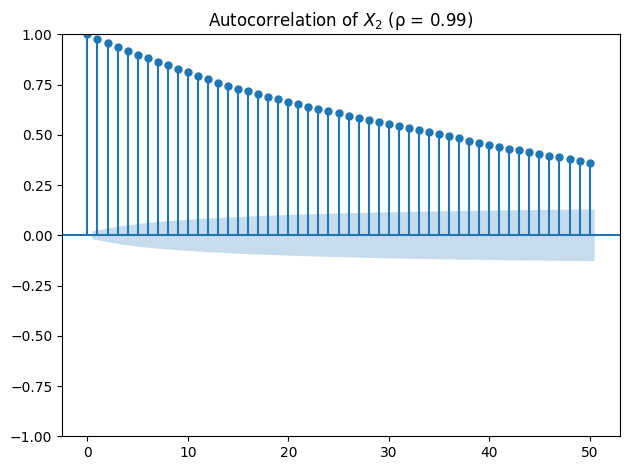

Acceptance rate: 0.1096
Running with τ = 5.0


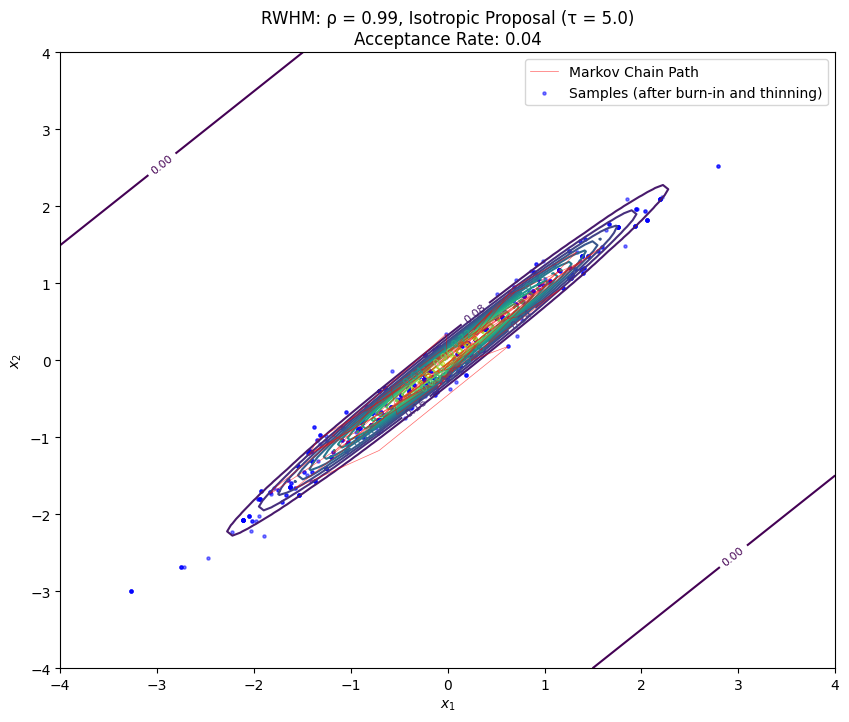

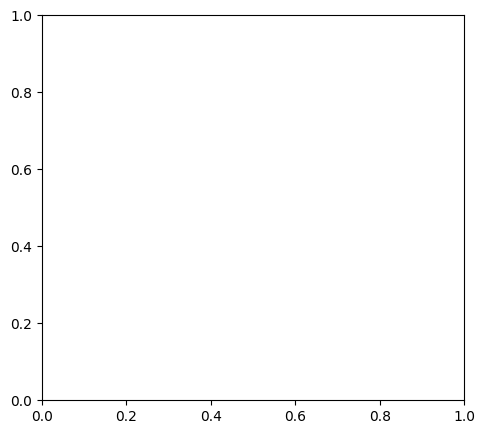

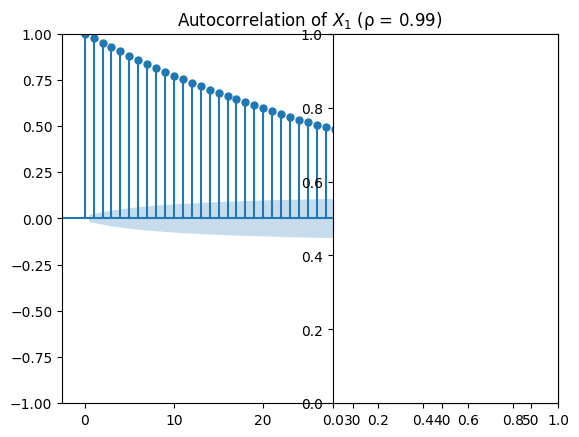

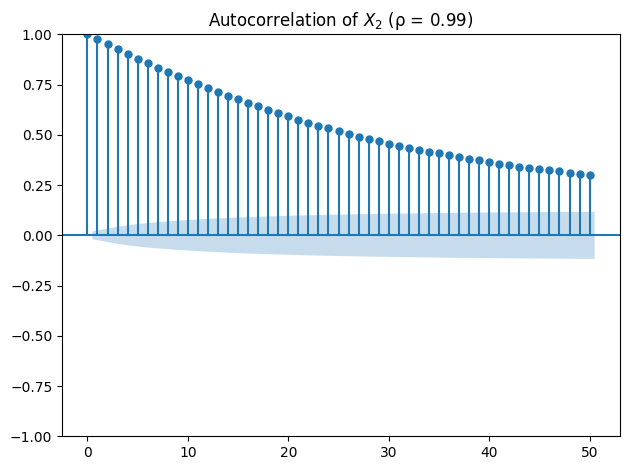

Acceptance rate: 0.0381


In [48]:
# Run RWHM with isotropic proposal (different τ values)
rho_values = [0.5, 0.9, 0.99]
tau_values = [0.1, 1.0, 5.0]

for rho in rho_values:
    print(f"\n--- RWHM with Isotropic Proposal: ρ = {rho} ---")
    for tau in tau_values:
        print(f"Running with τ = {tau}")
        _, acc_rate = run_and_visualize_rwhm(rho, "isotropic", tau)
        print(f"Acceptance rate: {acc_rate:.4f}")


--- RWHM with Adapted Proposal: ρ = 0.5 ---
Running with τ = 0.1


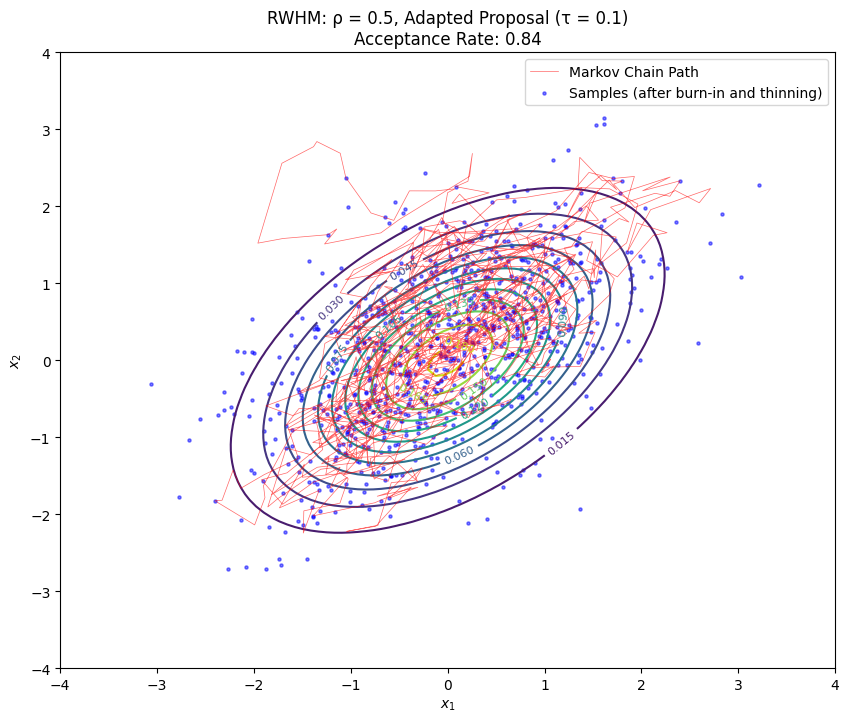

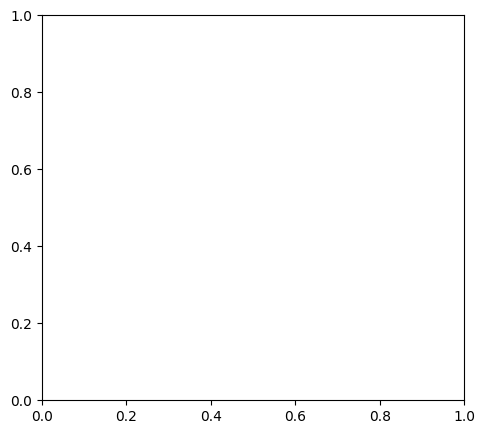

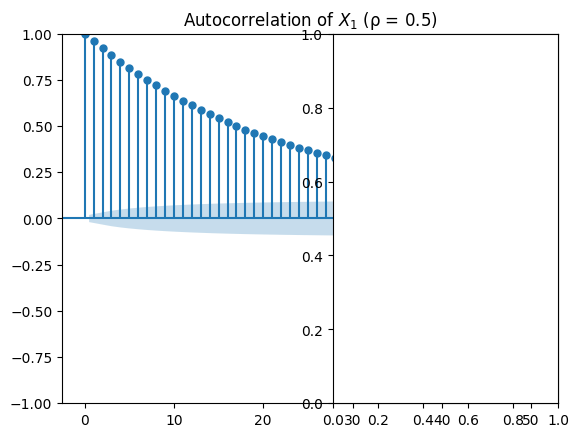

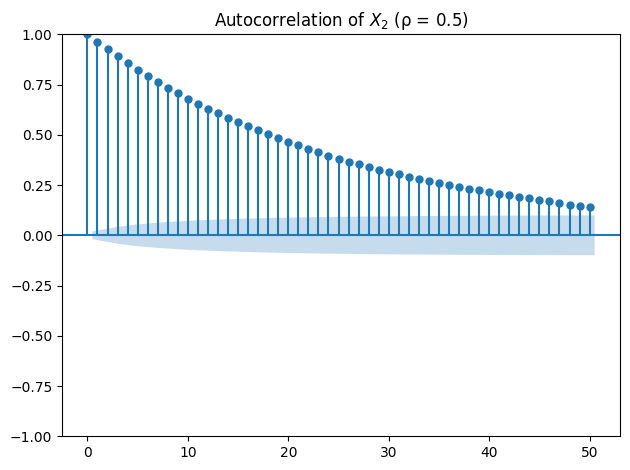

Acceptance rate: 0.8436
Running with τ = 1.0


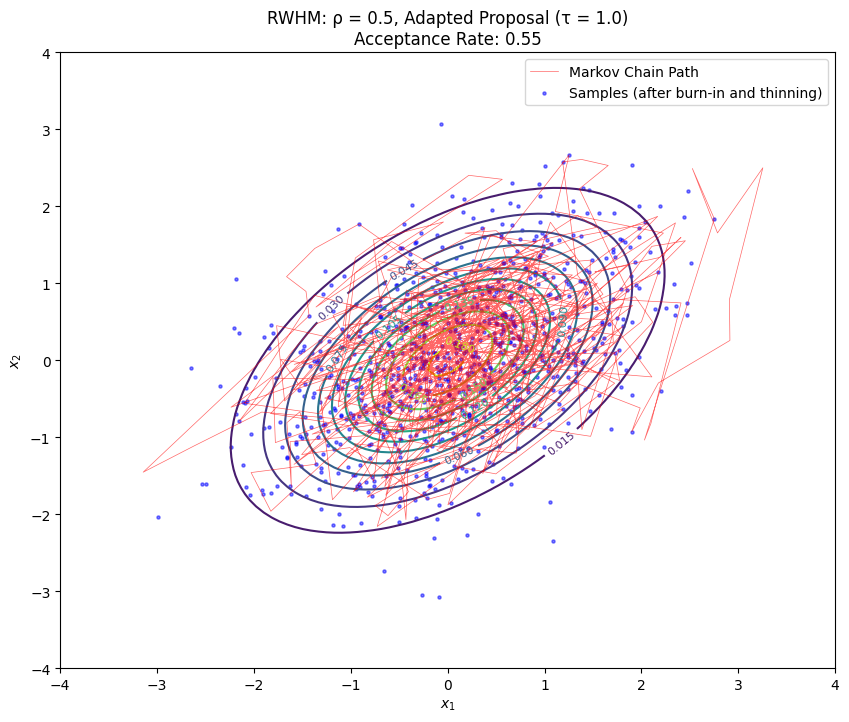

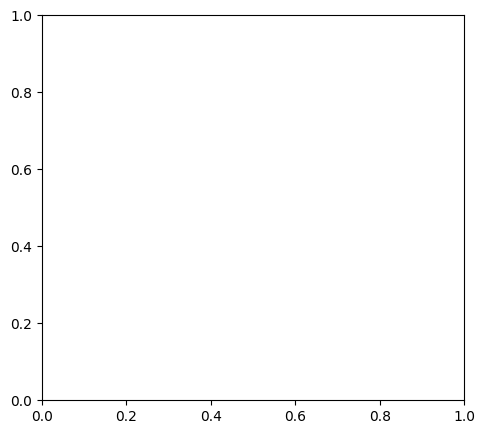

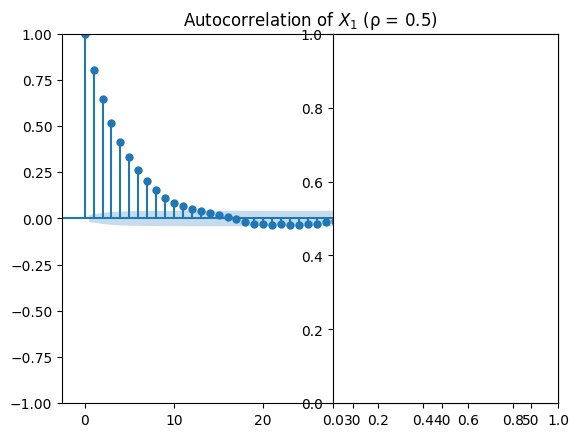

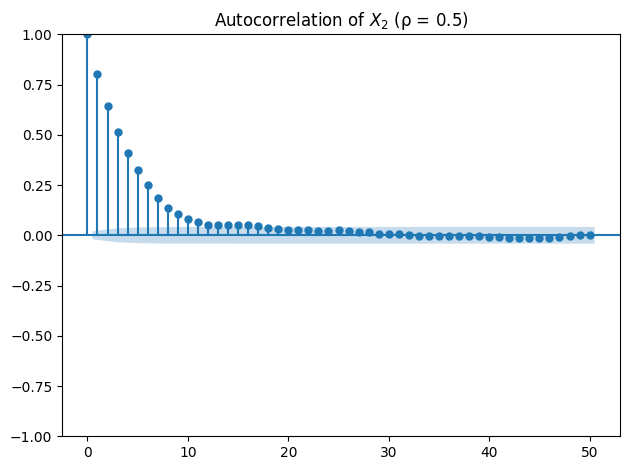

Acceptance rate: 0.5539
Running with τ = 5.0


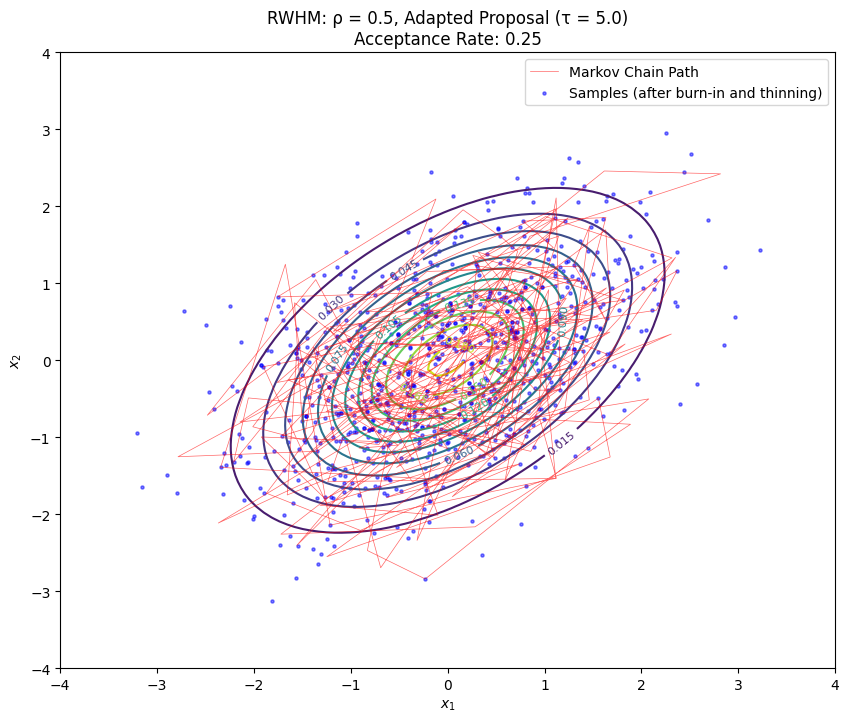

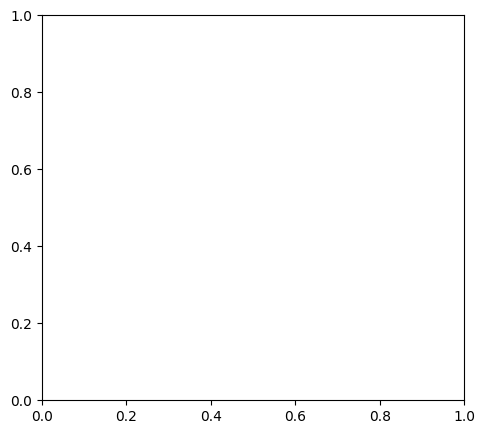

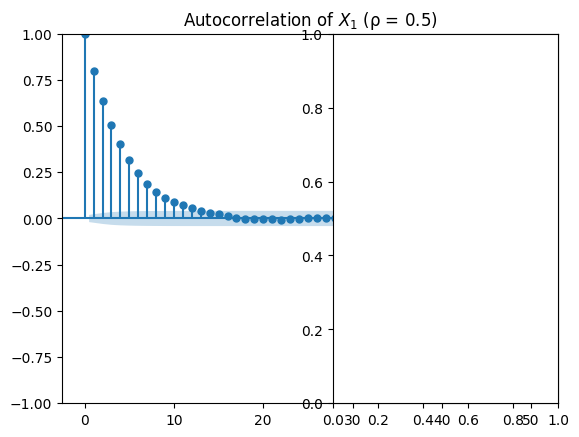

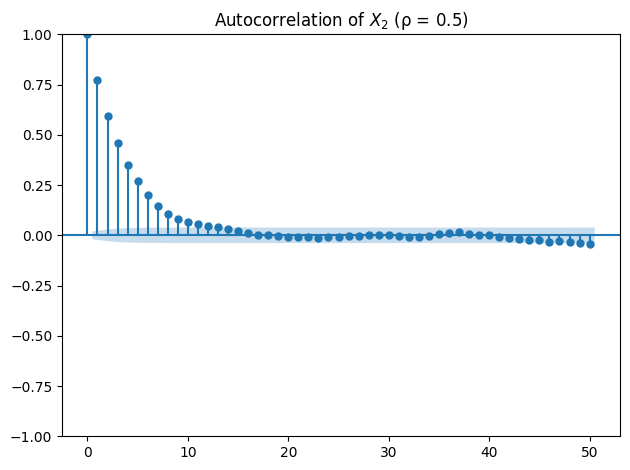

Acceptance rate: 0.2543

--- RWHM with Adapted Proposal: ρ = 0.9 ---
Running with τ = 0.1


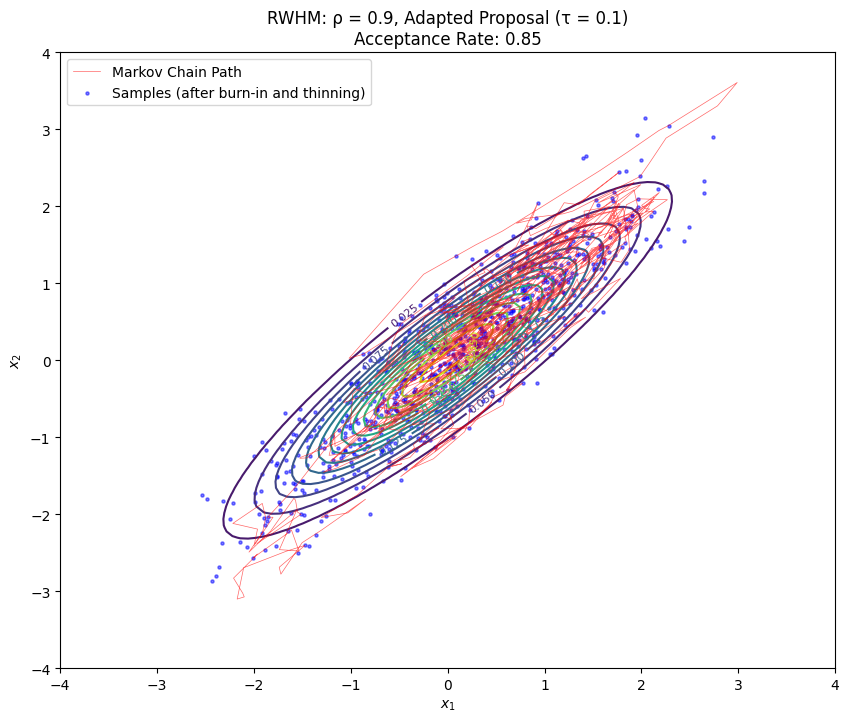

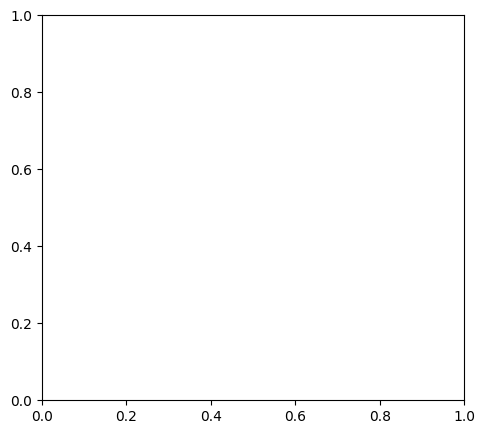

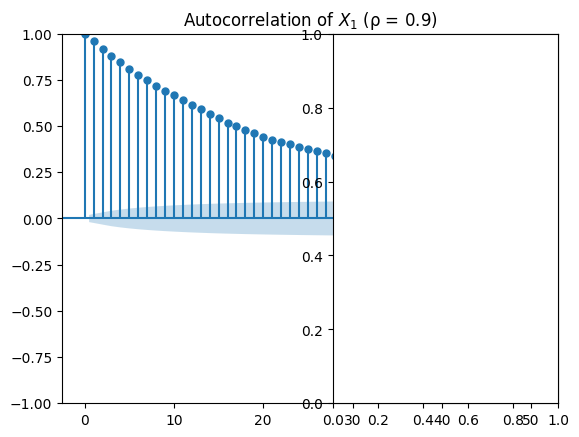

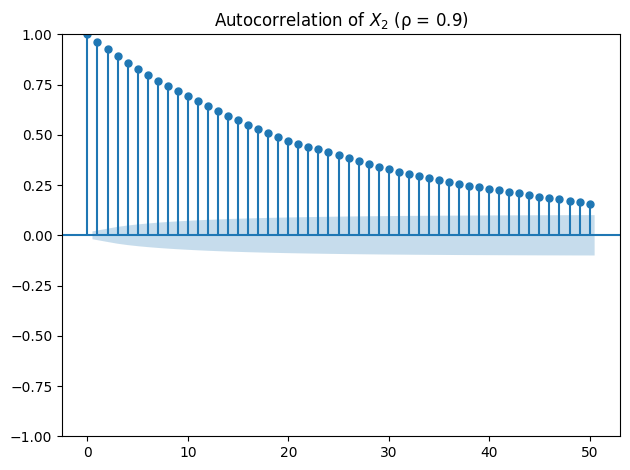

Acceptance rate: 0.8504
Running with τ = 1.0


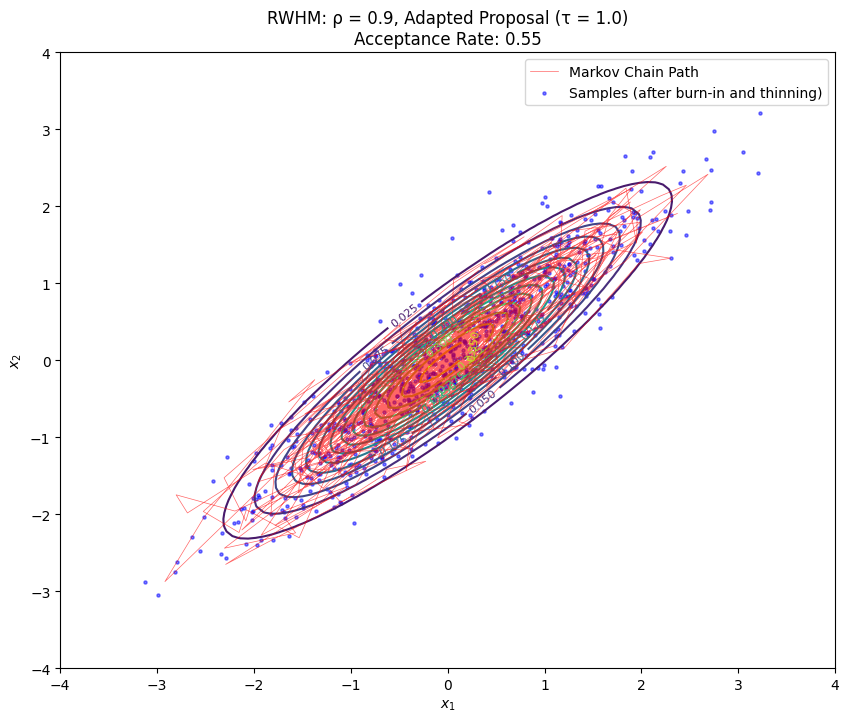

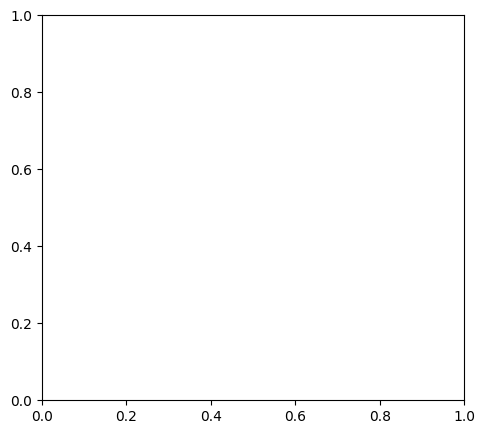

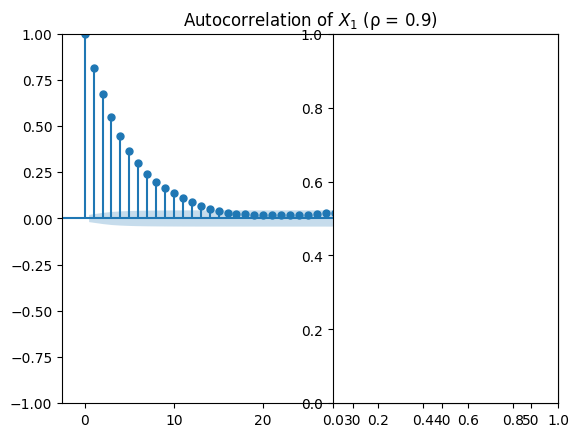

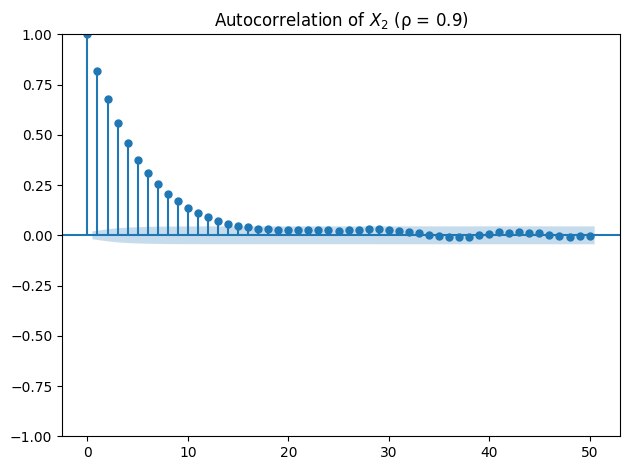

Acceptance rate: 0.5509
Running with τ = 5.0


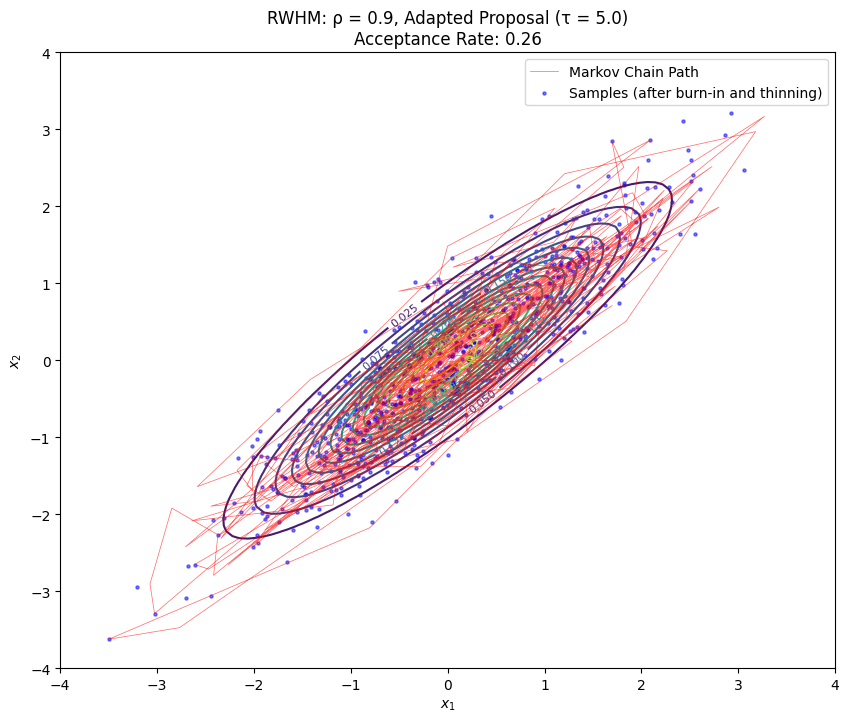

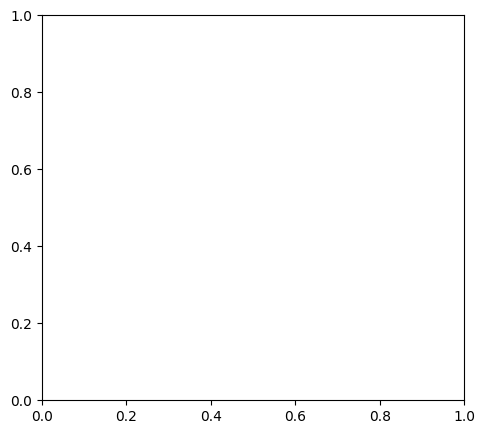

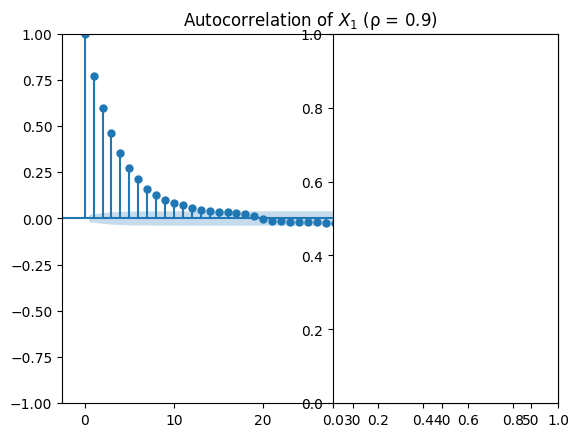

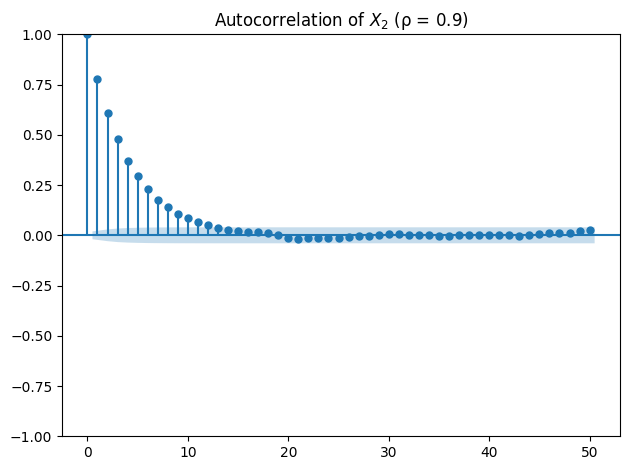

Acceptance rate: 0.2552

--- RWHM with Adapted Proposal: ρ = 0.99 ---
Running with τ = 0.1


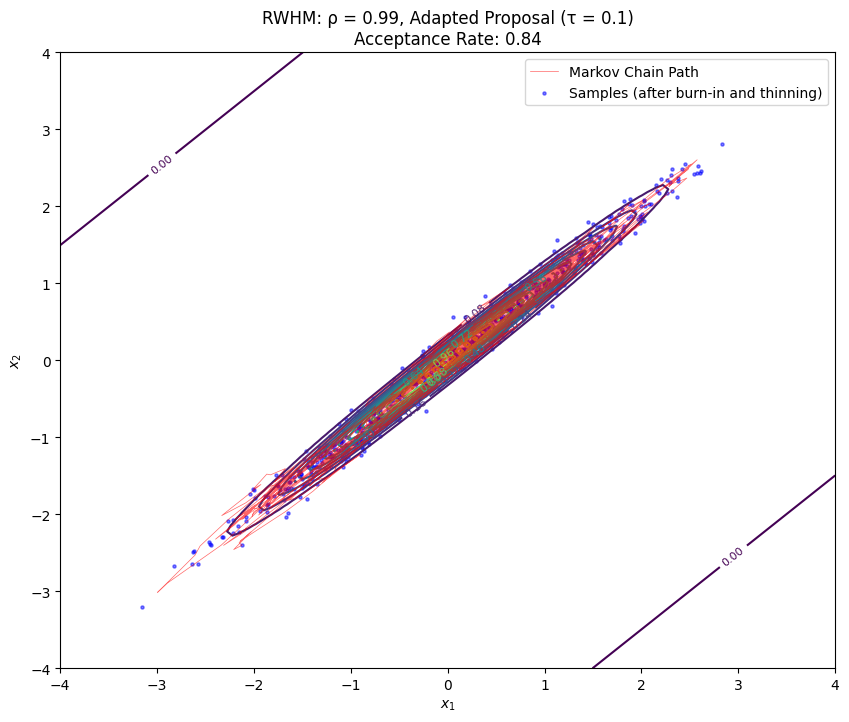

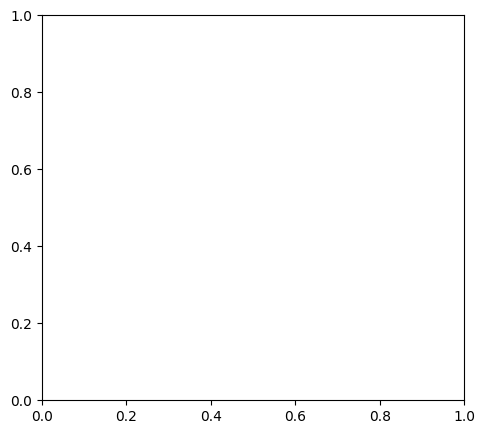

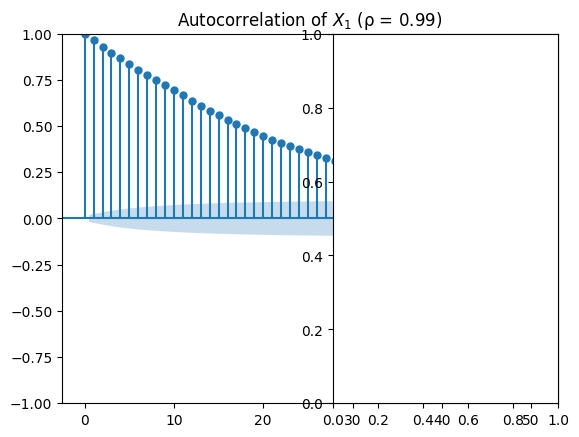

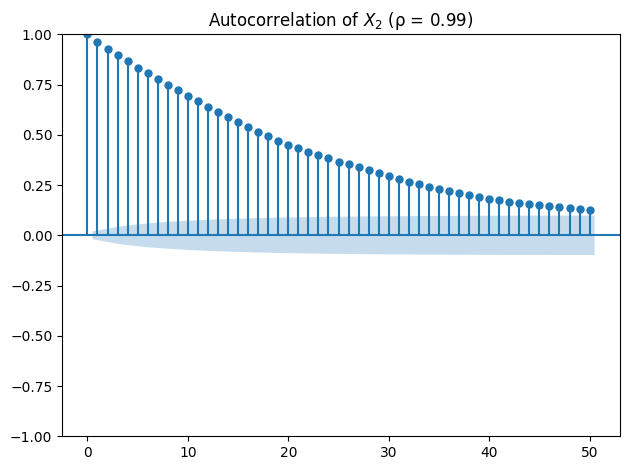

Acceptance rate: 0.8396
Running with τ = 1.0


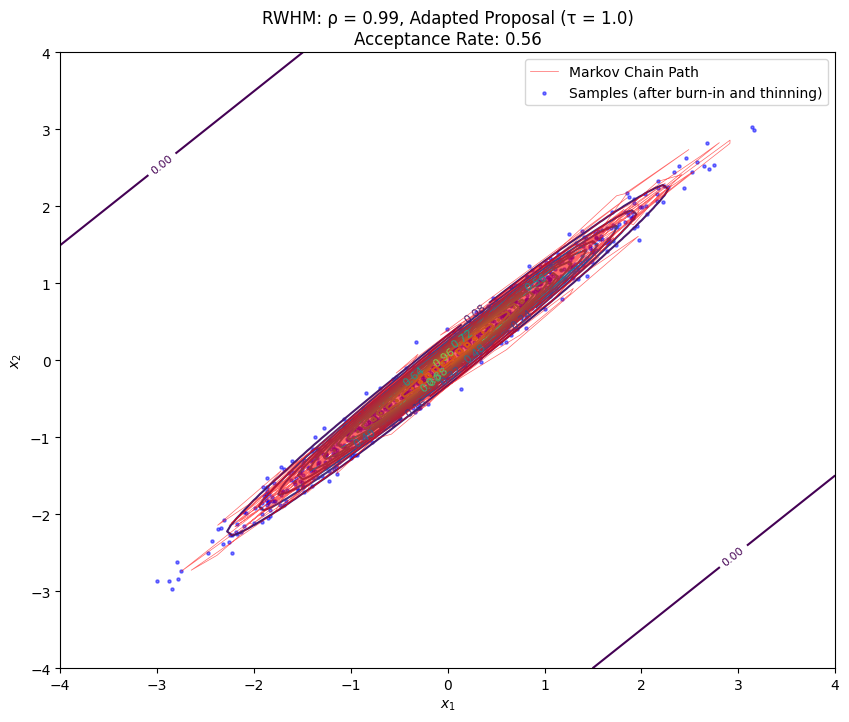

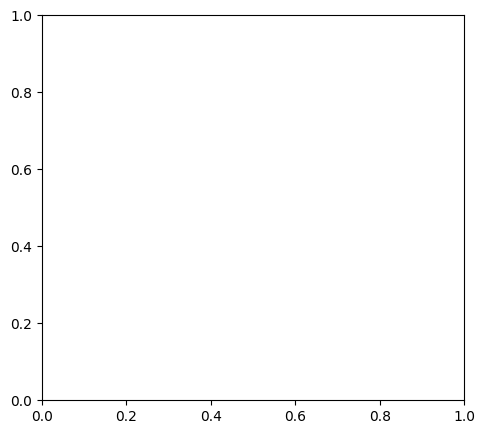

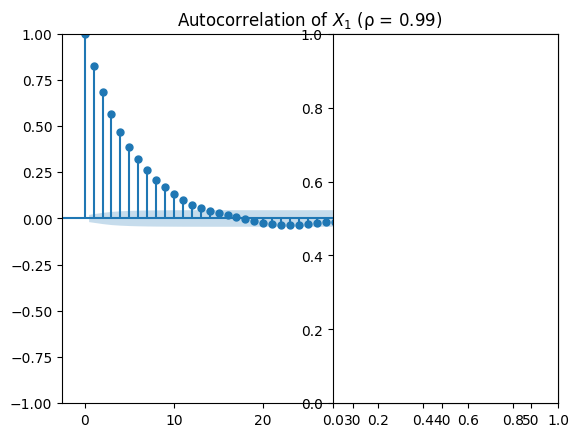

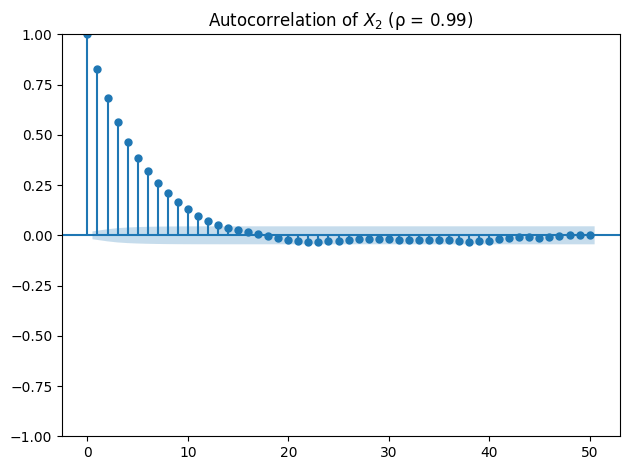

Acceptance rate: 0.5598
Running with τ = 5.0


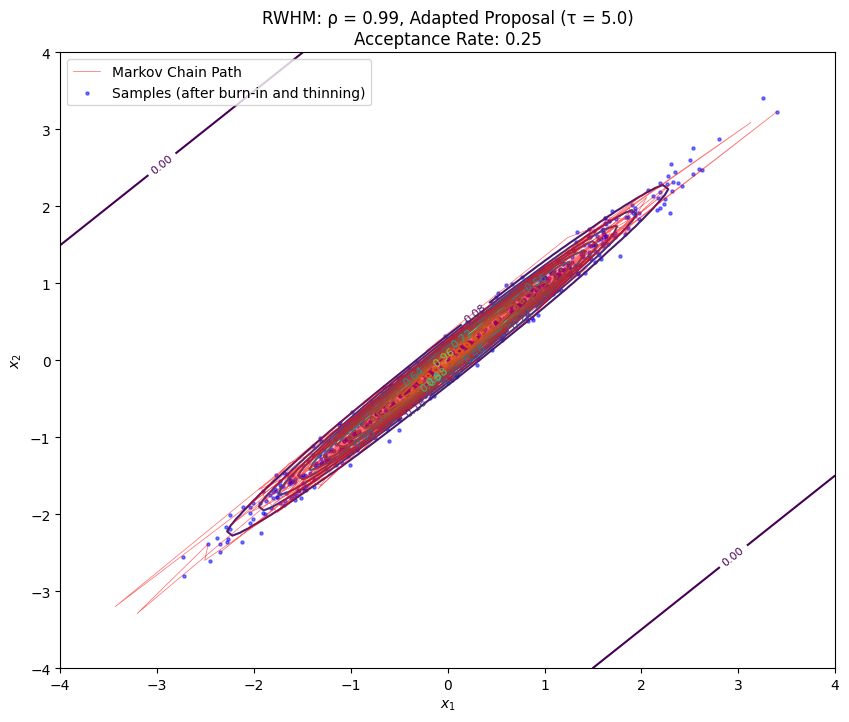

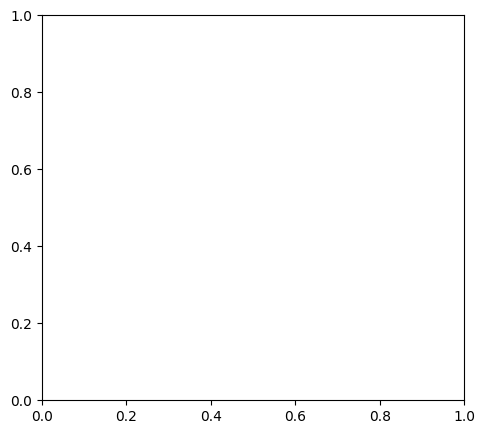

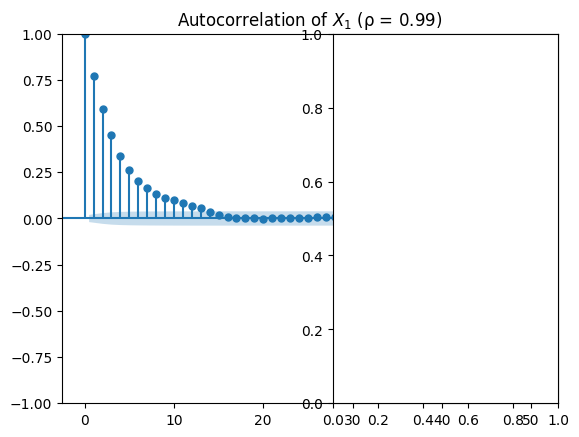

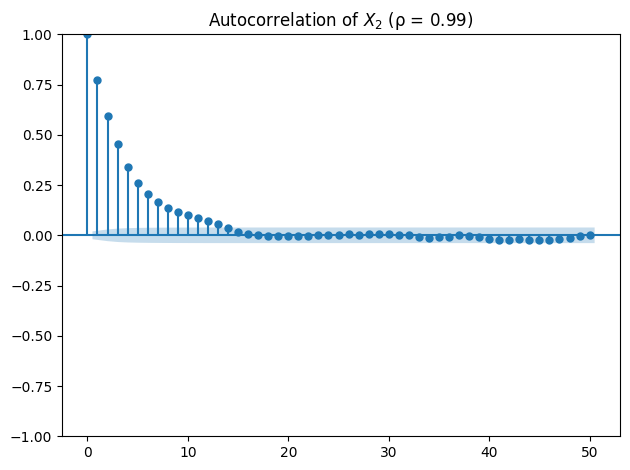

Acceptance rate: 0.2536


In [49]:
# Run RWHM with adapted proposal (different τ values)
for rho in rho_values:
    print(f"\n--- RWHM with Adapted Proposal: ρ = {rho} ---")
    for tau in tau_values:
        print(f"Running with τ = {tau}")
        _, acc_rate = run_and_visualize_rwhm(rho, "adapted", tau)
        print(f"Acceptance rate: {acc_rate:.4f}")

## Conclusion

1. **Gibbs Sampler**:
   - Straightforward implementation for bivariate normal
   - Performance degrades severely as ρ→1 due to high autocorrelation
   - Moves become increasingly small and constrained

2. **Random Walk Hastings-Metropolis**:
   - **Isotropic Proposal**:
     - Simple to implement
     - Works reasonably well for low correlation
     - Very inefficient for high correlation (ρ→1)
     
   - **Adapted Proposal**:
     - Accommodates the correlation structure
     - Maintains efficiency even for high ρ values
     - Optimal τ values tend to be smaller for adapted proposals

3. **Optimal Tuning**:
   - For isotropic proposals, optimal τ decreases as ρ increases
   - For adapted proposals, optimal τ remains more stable across ρ values
   - Target acceptance rate around 0.234 is a good guideline for efficiency
   
This case study illustrates the importance of proposal distribution selection when using MCMC methods, especially for strongly correlated variables.

# Ising Model Sampling and Mixing Analysis

The Ising model is a mathematical model of ferromagnetism in statistical mechanics. We're analyzing a binary Ising model with the following probability distribution:

$$p(x) \propto \exp\left(\alpha\sum_i x_i + \beta\sum_{i\sim j} 1\{x_i = x_j\}\right)$$

where:
- $x = (x_1, \ldots, x_n) \in \{0, 1\}^n$ is a binary vector
- $\alpha$ controls the external field (bias toward 0 or 1)
- $\beta$ controls the interaction strength between neighboring components
- $i \sim j$ indicates that components $i$ and $j$ are neighbors

We'll implement this on a $k \times k$ square grid with the four-neighbor structure (north, south, east, west).

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from tqdm.notebook import tqdm
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf

# Set random seed for reproducibility
np.random.seed(42)

## 1. Full Conditional Distribution and Gibbs Sampler

### Derivation of the Full Conditional Distribution

To derive the full conditional distribution $p(x_i | x_{-i})$, we need to identify all terms in the probability function that involve $x_i$.

Given the probability:
$$p(x) \propto \exp\left(\alpha\sum_i x_i + \beta\sum_{i\sim j} 1\{x_i = x_j\}\right)$$

For a specific component $x_i$:
- From the first term: $\alpha x_i$
- From the second term: $\beta \sum_{j: j\sim i} 1\{x_i = x_j\}$

So the full conditional is:
$$p(x_i | x_{-i}) \propto \exp\left(\alpha x_i + \beta \sum_{j: j\sim i} 1\{x_i = x_j\}\right)$$

For a binary variable, we only need to calculate $p(x_i = 1 | x_{-i})$:

When $x_i = 1$:
$$\exp\left(\alpha + \beta \sum_{j: j\sim i} 1\{1 = x_j\}\right) = \exp\left(\alpha + \beta \cdot \text{(number of neighbors equal to 1)}\right)$$

When $x_i = 0$:
$$\exp\left(\beta \sum_{j: j\sim i} 1\{0 = x_j\}\right) = \exp\left(\beta \cdot \text{(number of neighbors equal to 0)}\right)$$

Since these are the only two possible values and must sum to 1 after normalization:

$$p(x_i = 1 | x_{-i}) = \frac{\exp\left(\alpha + \beta \cdot n_1\right)}{\exp\left(\alpha + \beta \cdot n_1\right) + \exp\left(\beta \cdot n_0\right)}$$

where $n_1$ is the number of neighbors equal to 1 and $n_0$ is the number of neighbors equal to 0.

In [57]:
def ising_full_conditional(grid, i, j, alpha, beta):
    """
    Calculate the full conditional probability of x_ij = 1

    Parameters:
    grid (np.array): Current state of the Ising grid
    i, j (int): Position in the grid
    alpha (float): External field parameter
    beta (float): Interaction parameter

    Returns:
    float: P(x_ij = 1 | all other x)
    """
    k = grid.shape[0]

    # Get the values of the neighbors (handling edge cases)
    neighbors = []
    if i > 0:  # Top neighbor
        neighbors.append(grid[i-1, j])
    if i < k-1:  # Bottom neighbor
        neighbors.append(grid[i+1, j])
    if j > 0:  # Left neighbor
        neighbors.append(grid[i, j-1])
    if j < k-1:  # Right neighbor
        neighbors.append(grid[i, j+1])

    # Count how many neighbors are 1
    n1 = sum(neighbors)

    # Count how many neighbors are 0
    n0 = len(neighbors) - n1

    # Calculate energy for x_ij = 1
    energy_1 = alpha + beta * n1

    # Calculate energy for x_ij = 0
    energy_0 = beta * n0

    # Compute the conditional probability using the derived formula
    p_1_given_rest = np.exp(energy_1) / (np.exp(energy_0) + np.exp(energy_1))

    return p_1_given_rest

### Gibbs Sampler for the Ising Model

Based on the full conditional distribution derived above, we can now implement a Gibbs sampler for the Ising model. The algorithm proceeds as follows:

1. Initialize the grid with random binary values (0 or 1)
2. For each iteration:
   a. Visit each position $(i,j)$ in the grid in random order
   b. Sample a new value for $x_{ij}$ from its full conditional distribution
   c. Update the grid with the new value
3. Return the sequence of grid states

By visiting positions in random order, we ensure proper mixing of the Markov chain. This approach is also known as "random-scan" Gibbs sampling.

In [58]:
def gibbs_sampler_ising(k, alpha, beta, n_iterations, initial_grid=None):
    """
    Gibbs sampler for the Ising model

    Parameters:
    k (int): Size of the kxk grid
    alpha (float): External field parameter
    beta (float): Interaction parameter
    n_iterations (int): Number of iterations
    initial_grid (np.array, optional): Initial state of the grid

    Returns:
    list: List of grid states at each iteration
    """
    # Initialize grid if not provided
    if initial_grid is None:
        grid = np.random.randint(0, 2, size=(k, k))
    else:
        grid = initial_grid.copy()

    # Store all grid states
    grids = [grid.copy()]

    # Run Gibbs sampling
    for t in tqdm(range(n_iterations)):
        # Scan the grid in random order
        indices = [(i, j) for i in range(k) for j in range(k)]
        np.random.shuffle(indices)

        for i, j in indices:
            # Calculate conditional probability
            p_1 = ising_full_conditional(grid, i, j, alpha, beta)

            # Sample new value
            grid[i, j] = np.random.binomial(1, p_1)

        # Store the new grid state
        grids.append(grid.copy())

    return grids

## 2. Visualizing Mixing and Comparing Different β Values

To assess the mixing of the Markov chain, we need to analyze how quickly the chain "forgets" its initial state. A fast-mixing chain quickly reaches its stationary distribution, while a slow-mixing chain takes longer to explore the state space.

We'll use several metrics to visualize mixing:

1. **Grid Evolution Animation**: Visualize how the grid changes over iterations
2. **Mean Spin Trace**: Plot the average value of all spins at each iteration
3. **Energy Trace**: Plot the energy of the system at each iteration
4. **Autocorrelation**: Calculate the autocorrelation of the mean spin to quantify how quickly the chain decorrelates from its past states

These visualizations will help us understand how the mixing behavior changes with different values of β.

In [59]:
def plot_grid_evolution(grids, interval=100, title_prefix=""):
    """
    Create an animation of the grid evolution

    Parameters:
    grids (list): List of grid states
    interval (int): Time between frames in milliseconds
    title_prefix (str): Prefix for the title

    Returns:
    FuncAnimation: Animation object
    """
    fig, ax = plt.subplots(figsize=(5, 5))

    # Initialize plot
    im = ax.imshow(grids[0], cmap='binary', vmin=0, vmax=1)
    ax.set_title(f'{title_prefix}Iteration: 0')
    plt.colorbar(im, ax=ax, ticks=[0, 1], label='Spin')

    # Update function for animation
    def update(frame):
        im.set_array(grids[frame])
        ax.set_title(f'{title_prefix}Iteration: {frame}')
        return [im]

    # Create animation
    ani = FuncAnimation(fig, update, frames=len(grids), interval=interval, blit=True)

    return ani

In [60]:
def calculate_statistics(grids, alpha, beta):
    """
    Calculate statistics for mixing analysis

    Parameters:
    grids (list): List of grid states
    alpha (float): External field parameter
    beta (float): Interaction parameter

    Returns:
    dict: Dictionary of statistics
    """
    # Convert to numpy array for easier calculations
    grids_array = np.array(grids)

    # Calculate mean spin at each iteration
    mean_spins = grids_array.mean(axis=(1, 2))

    # Calculate energy at each iteration
    k = grids_array.shape[1]
    energies = []

    for grid in grids_array:
        # Count neighboring pairs with the same value
        same_neighbors = 0
        for i in range(k):
            for j in range(k):
                if i > 0:  # Top neighbor
                    same_neighbors += (grid[i, j] == grid[i-1, j])
                if j > 0:  # Left neighbor
                    same_neighbors += (grid[i, j] == grid[i, j-1])

        # Calculate total energy (negative because we're using exp of energy in probability)
        energy = -alpha * grid.sum() - beta * same_neighbors
        energies.append(energy)

    # Calculate autocorrelation of mean spin
    lag_max = min(50, len(mean_spins) // 4)
    acf_values = np.zeros(lag_max)

    for lag in range(lag_max):
        # Calculate autocorrelation manually to avoid statsmodels issues
        x = mean_spins[:-lag] if lag > 0 else mean_spins
        y = mean_spins[lag:] if lag > 0 else mean_spins

        x_centered = x - np.mean(x)
        y_centered = y - np.mean(y)

        numerator = np.sum(x_centered * y_centered)
        denominator = np.sqrt(np.sum(x_centered**2) * np.sum(y_centered**2))

        if denominator > 0:
            acf_values[lag] = numerator / denominator
        else:
            acf_values[lag] = 0.0

    return {
        'mean_spins': mean_spins,
        'energies': energies,
        'acf_values': acf_values
    }

In [61]:
def plot_mixing_diagnostics(statistics, beta):
    """
    Plot diagnostic plots for mixing analysis

    Parameters:
    statistics (dict): Dictionary of statistics
    beta (float): Interaction parameter value
    """
    fig, axes = plt.subplots(3, 1, figsize=(10, 12))

    # Plot mean spin over iterations
    axes[0].plot(statistics['mean_spins'])
    axes[0].set_title(f'Mean Spin vs. Iteration (β = {beta})')
    axes[0].set_xlabel('Iteration')
    axes[0].set_ylabel('Mean Spin')
    axes[0].grid(alpha=0.3)

    # Plot energy over iterations
    axes[1].plot(statistics['energies'])
    axes[1].set_title(f'Energy vs. Iteration (β = {beta})')
    axes[1].set_xlabel('Iteration')
    axes[1].set_ylabel('Energy')
    axes[1].grid(alpha=0.3)

    # Plot autocorrelation
    lags = np.arange(len(statistics['acf_values']))
    axes[2].stem(lags, statistics['acf_values'])
    axes[2].axhline(0, color='gray', linestyle='--', alpha=0.7)
    axes[2].set_title(f'Autocorrelation of Mean Spin (β = {beta})')
    axes[2].set_xlabel('Lag')
    axes[2].set_ylabel('Autocorrelation')
    axes[2].grid(alpha=0.3)

    plt.tight_layout()
    plt.show()

## 3. Finding the Critical Value and Phase Transition Analysis

In the Ising model, there exists a critical value β₀ beyond which the system undergoes a phase transition. This phase transition is characterized by:

1. **Magnetization**: The system tends to favor one spin value (0 or 1) globally
2. **Long-range order**: Spins become correlated over large distances
3. **Slow mixing**: The Markov chain takes much longer to explore the state space

To find this critical value, we'll run experiments with various β values and analyze:
- How the mixing time changes with β
- The emergence of large, contiguous regions of the same value
- Changes in the autocorrelation function

For a 2D Ising model with nearest-neighbor interactions, the theoretical critical value is approximately β₀ ≈ 0.44.

In [62]:
def run_ising_experiment(k=20, alpha=0.1, beta_values=None, n_iterations=5000):
    """
    Run Ising model experiments with different beta values

    Parameters:
    k (int): Size of the grid
    alpha (float): External field parameter
    beta_values (list): List of beta values to test
    n_iterations (int): Number of iterations

    Returns:
    dict: Results for each beta value
    """
    if beta_values is None:
        beta_values = [0.2, 0.4, 0.6, 0.8, 1.0]

    results = {}

    # Use the same initial grid for all experiments
    initial_grid = np.random.randint(0, 2, size=(k, k))

    for beta in beta_values:
        print(f"\nRunning Gibbs sampler with β = {beta}")

        # Run Gibbs sampler
        grids = gibbs_sampler_ising(k, alpha, beta, n_iterations, initial_grid.copy())

        # Calculate statistics
        stats = calculate_statistics(grids, alpha, beta)

        # Store results
        results[beta] = {
            'grids': grids,
            'statistics': stats
        }

        # Plot diagnostic plots
        plot_mixing_diagnostics(stats, beta)

        # Show final grid state
        plt.figure(figsize=(5, 5))
        plt.imshow(grids[-1], cmap='binary', vmin=0, vmax=1)
        plt.title(f'Final Grid State (β = {beta})')
        plt.colorbar(ticks=[0, 1], label='Spin')
        plt.show()

    return results

In [63]:
def calculate_mixing_time(acf_values, threshold=0.1):
    """
    Calculate approximate mixing time based on autocorrelation decay

    Parameters:
    acf_values (np.array): Autocorrelation values
    threshold (float): Threshold to determine mixing

    Returns:
    int: Approximate mixing time (lag at which ACF drops below threshold)
    """
    # Find where ACF drops below threshold
    for i, acf in enumerate(acf_values):
        if acf < threshold:
            return i

    # If ACF never drops below threshold
    return len(acf_values)

In [64]:
def plot_mixing_times(results, beta_values):
    """
    Plot mixing times for different beta values

    Parameters:
    results (dict): Results dictionary
    beta_values (list): List of beta values
    """
    mixing_times = []

    for beta in beta_values:
        acf_values = results[beta]['statistics']['acf_values']
        mixing_time = calculate_mixing_time(acf_values)
        mixing_times.append(mixing_time)

    plt.figure(figsize=(10, 6))
    plt.plot(beta_values, mixing_times, 'o-')
    plt.axvline(x=0.44, color='red', linestyle='--', alpha=0.7, label='Critical β ≈ 0.44')
    plt.title('Mixing Time vs. β')
    plt.xlabel('β')
    plt.ylabel('Approximate Mixing Time')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()


Running Gibbs sampler with β = 0.2


  0%|          | 0/5000 [00:00<?, ?it/s]

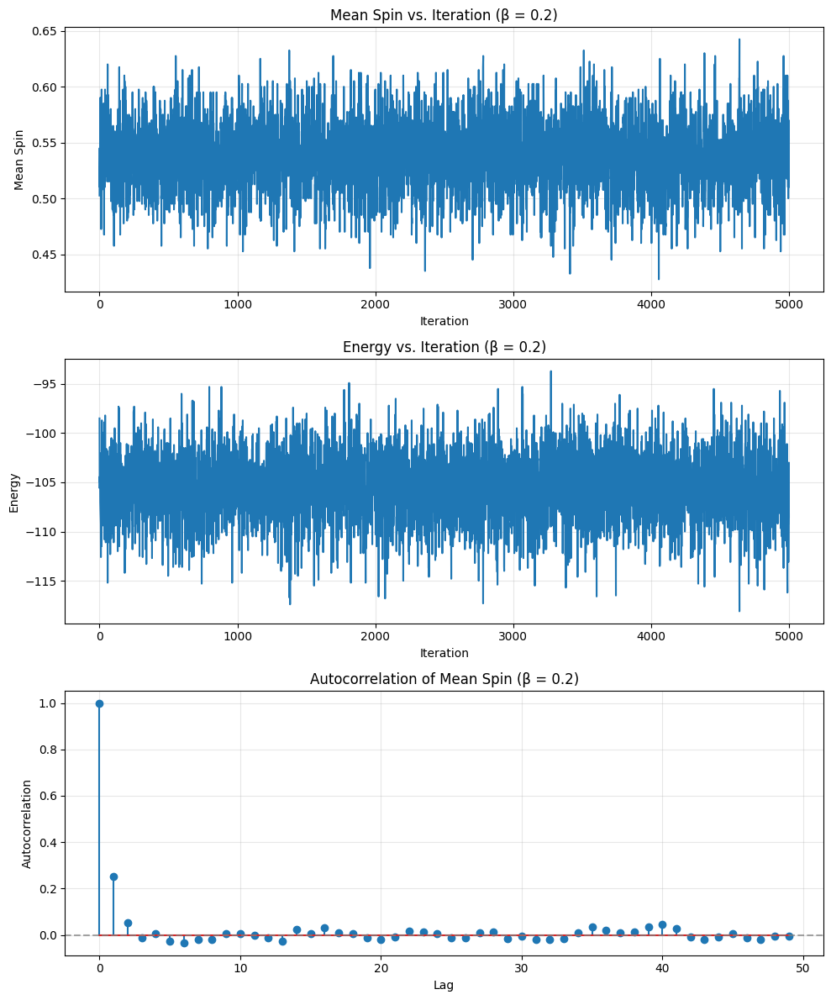

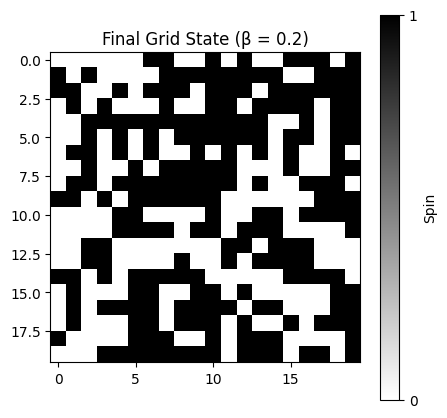


Running Gibbs sampler with β = 0.3


  0%|          | 0/5000 [00:00<?, ?it/s]

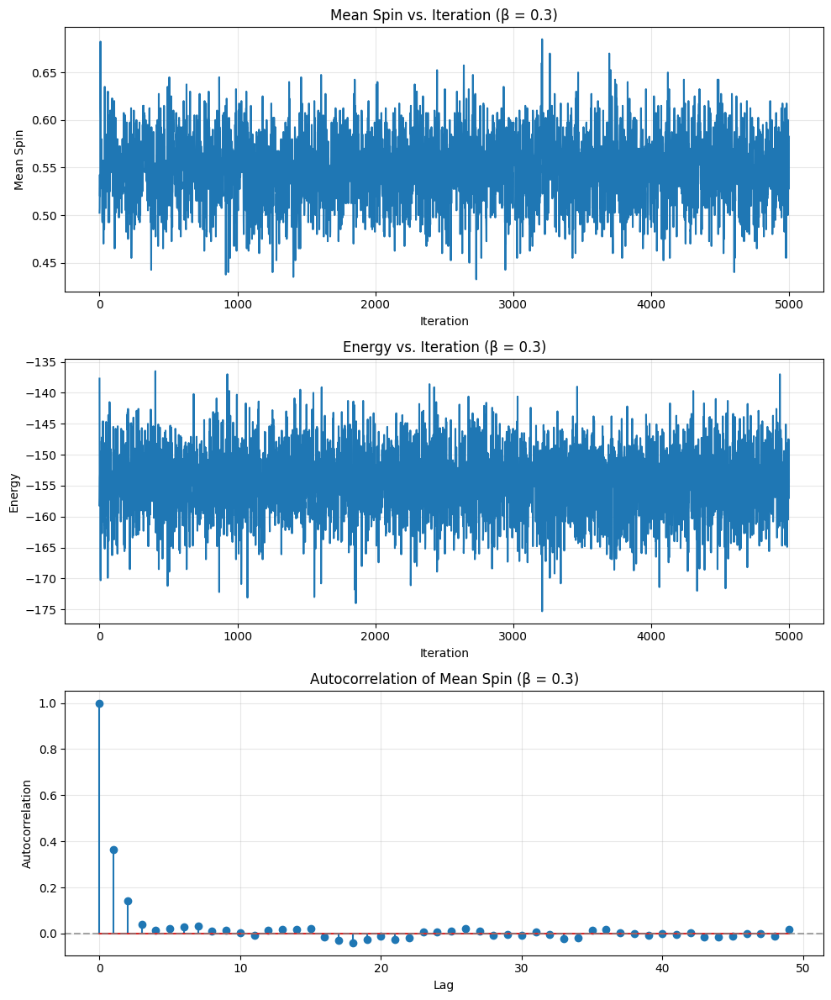

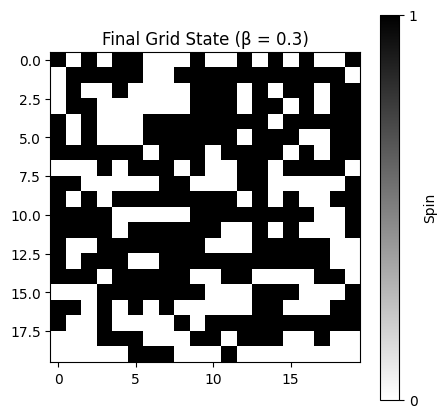


Running Gibbs sampler with β = 0.4


  0%|          | 0/5000 [00:00<?, ?it/s]

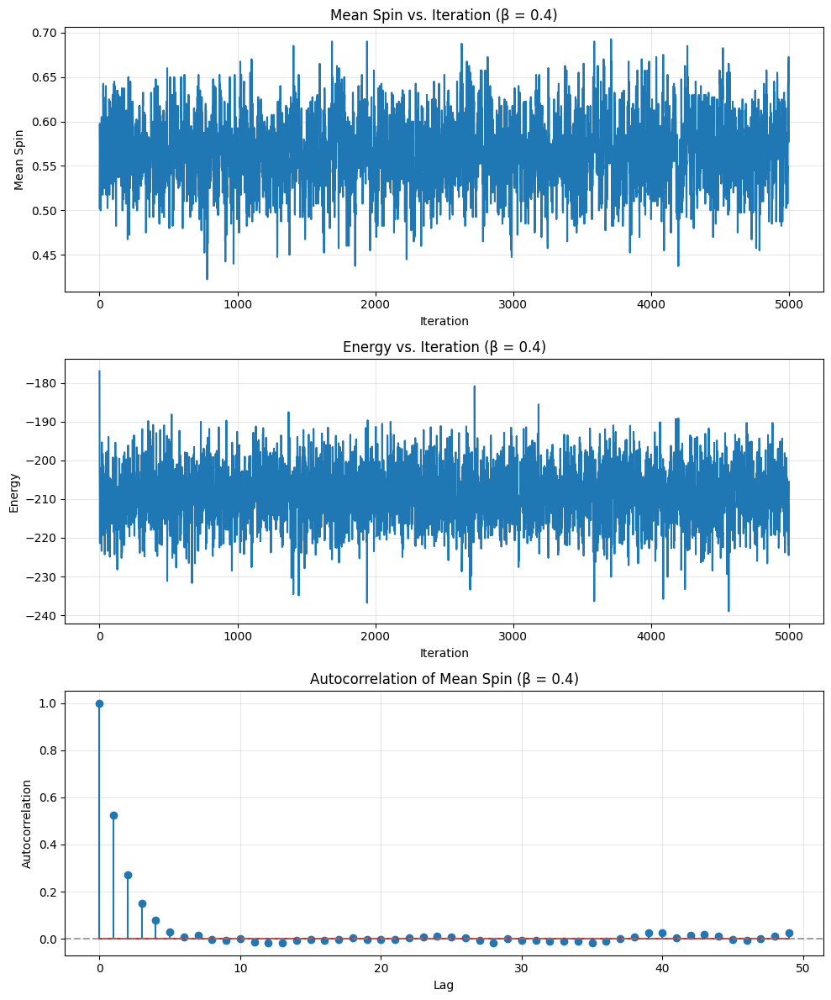

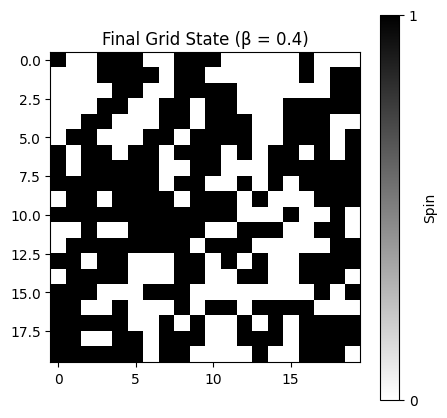


Running Gibbs sampler with β = 0.5


  0%|          | 0/5000 [00:00<?, ?it/s]

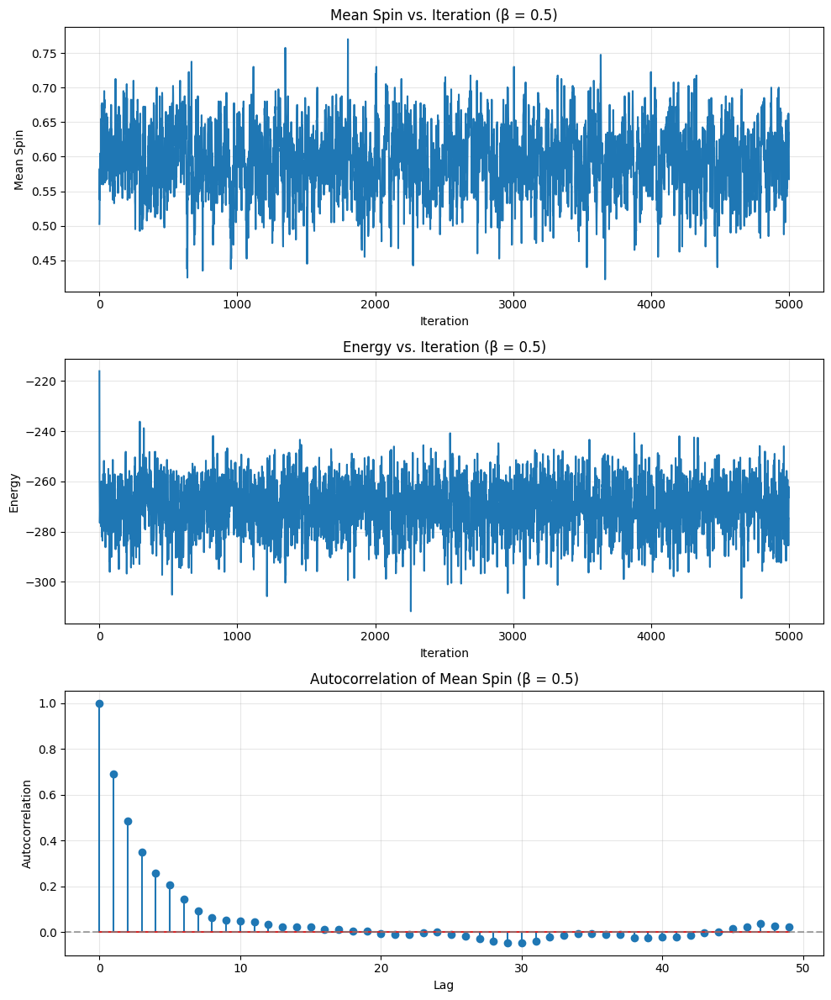

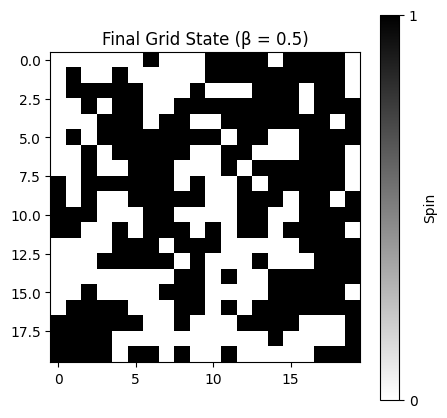


Running Gibbs sampler with β = 0.6


  0%|          | 0/5000 [00:00<?, ?it/s]

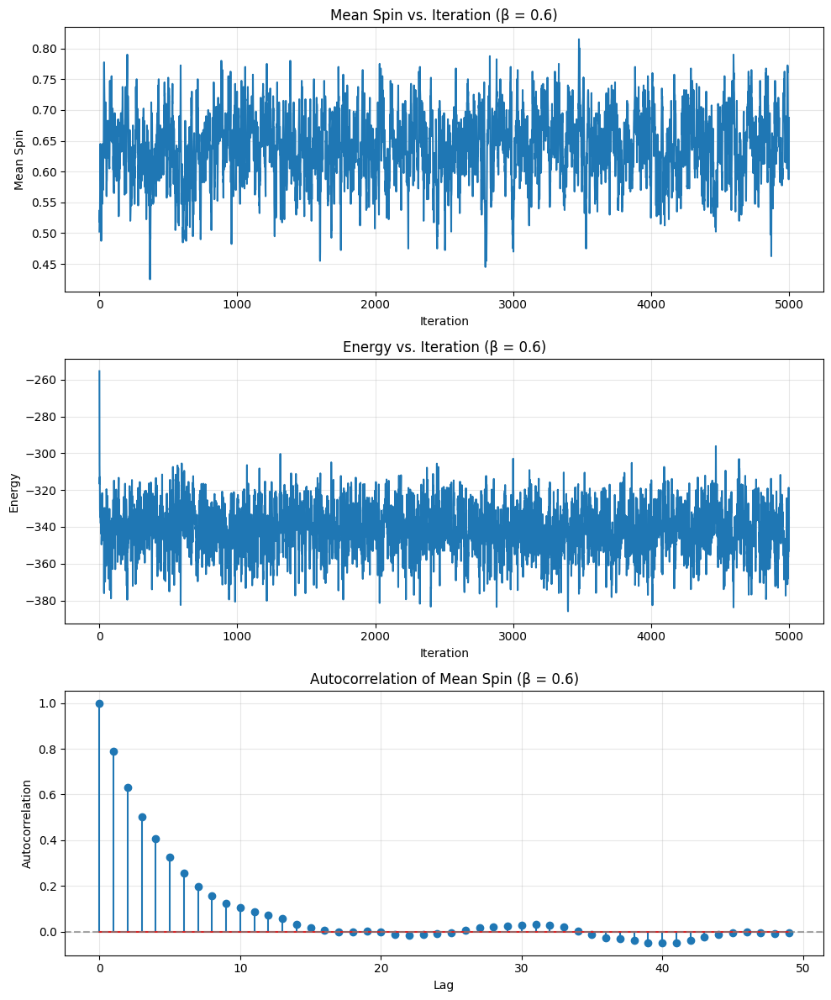

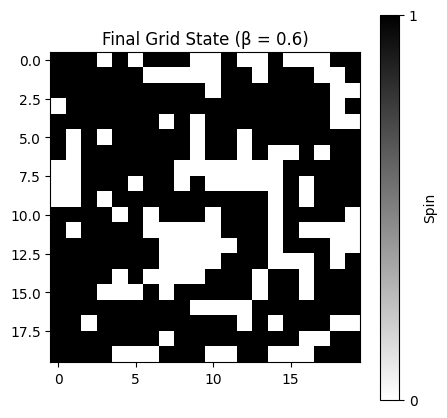

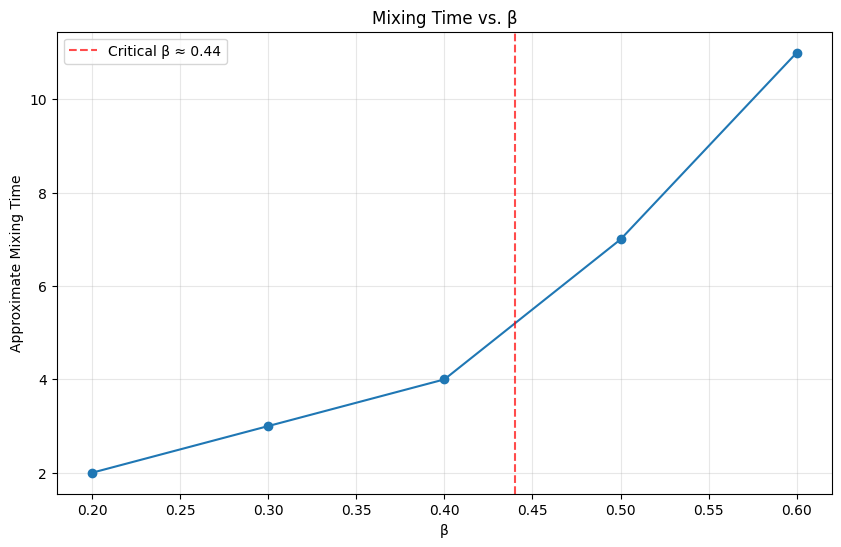

In [65]:
# Run experiment with a range of beta values
k = 20  # 20x20 grid
alpha = 0.1  # Small external field
beta_values = [0.2, 0.3, 0.4, 0.5, 0.6]
n_iterations = 5000

# Run experiments
results = run_ising_experiment(k, alpha, beta_values, n_iterations)

# Plot mixing times
plot_mixing_times(results, beta_values)


Running Gibbs sampler with β = 0.35


  0%|          | 0/5000 [00:00<?, ?it/s]

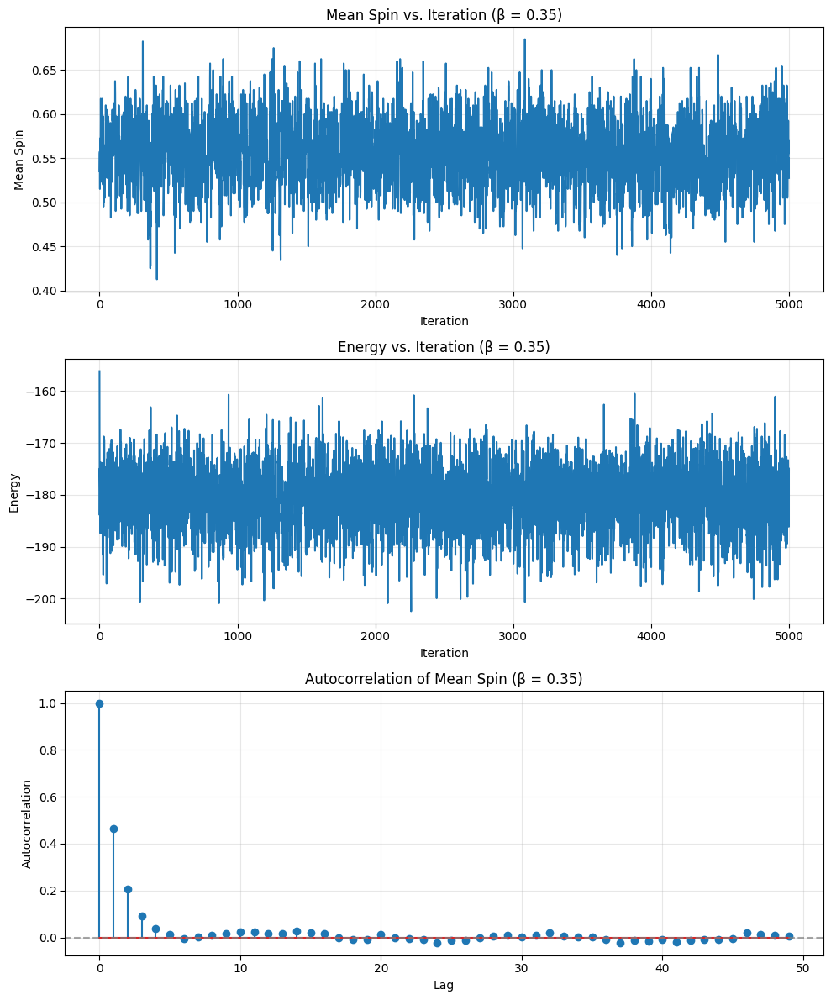

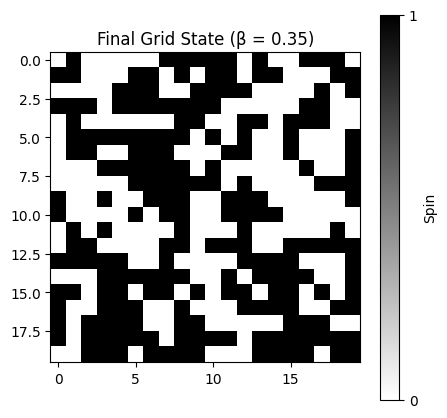


Running Gibbs sampler with β = 0.4


  0%|          | 0/5000 [00:00<?, ?it/s]

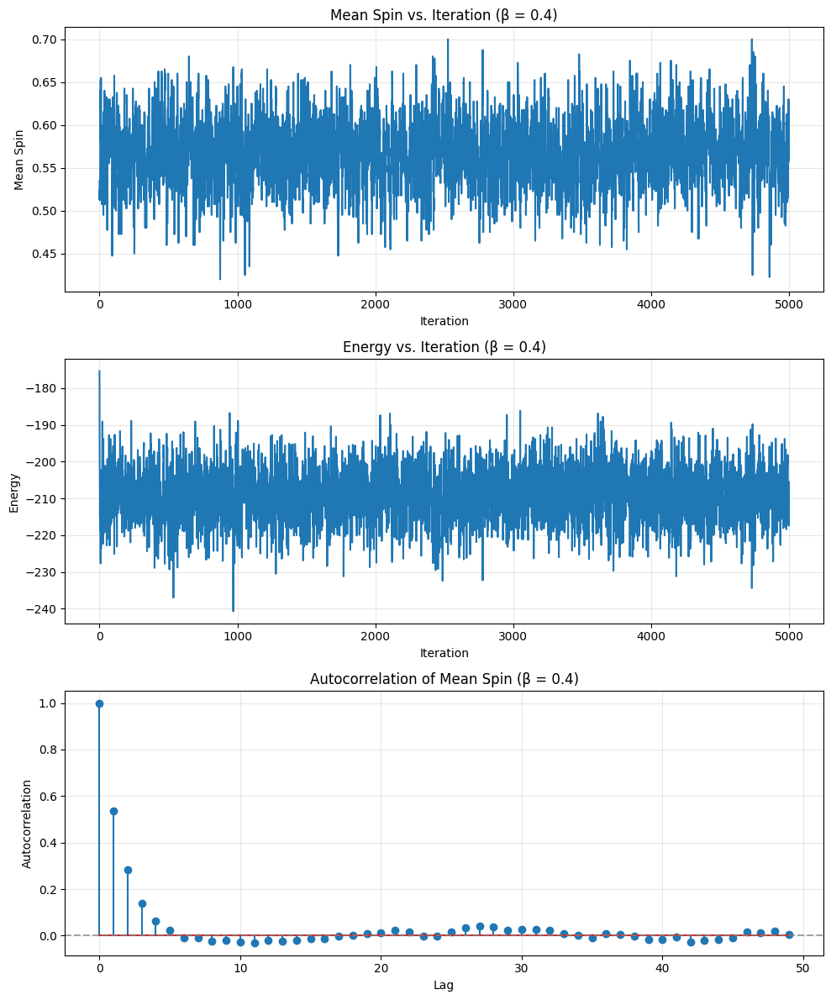

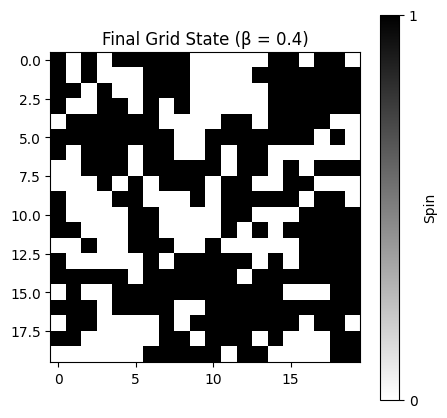


Running Gibbs sampler with β = 0.42


  0%|          | 0/5000 [00:00<?, ?it/s]

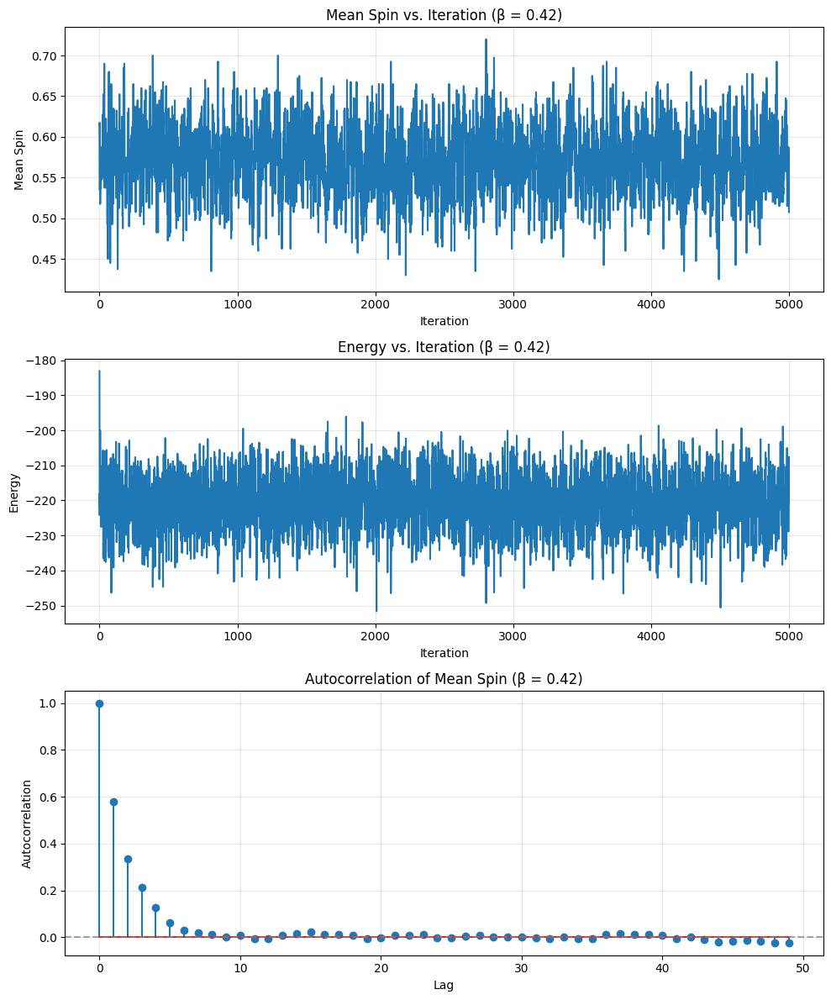

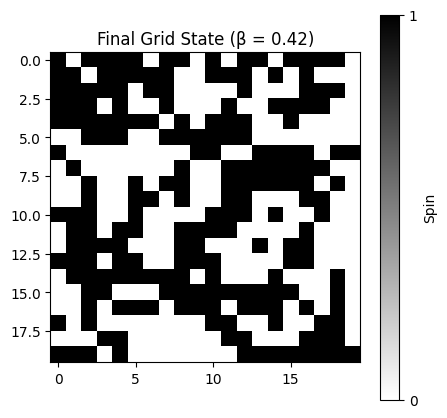


Running Gibbs sampler with β = 0.44


  0%|          | 0/5000 [00:00<?, ?it/s]

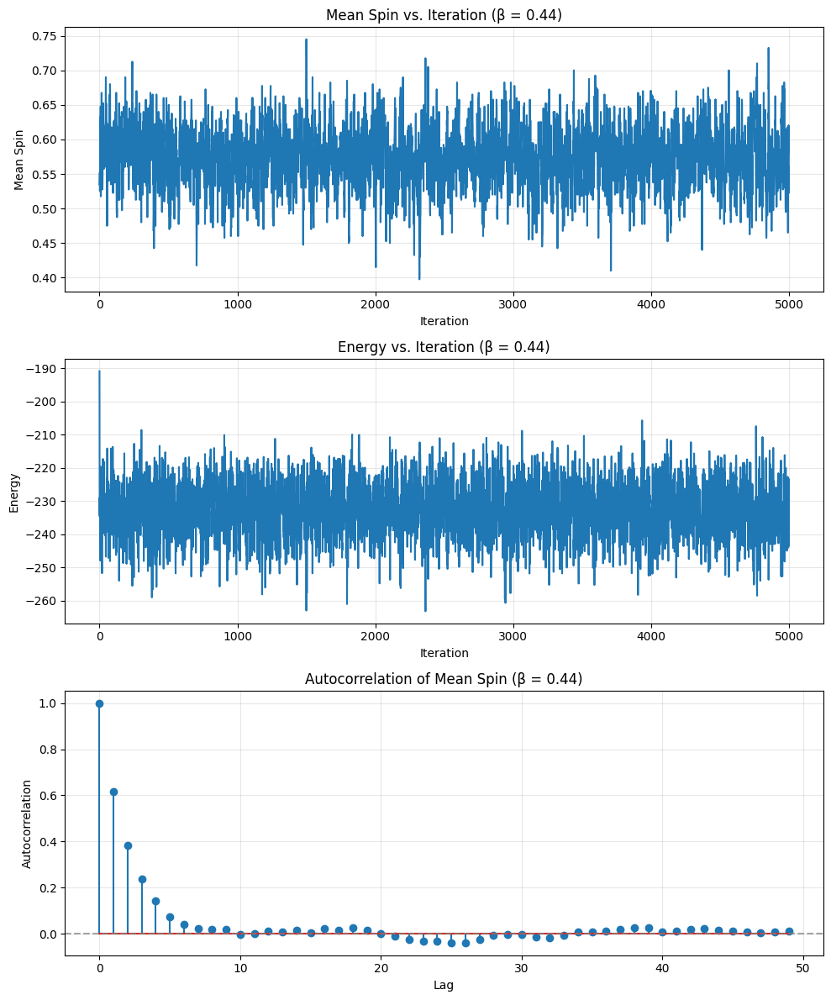

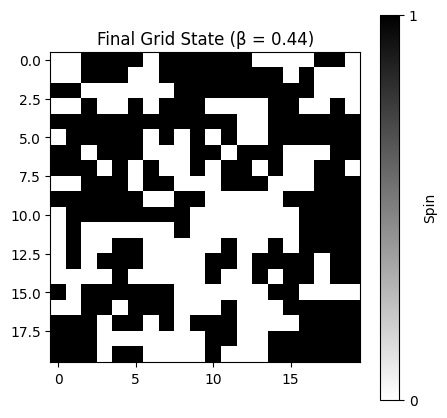


Running Gibbs sampler with β = 0.46


  0%|          | 0/5000 [00:00<?, ?it/s]

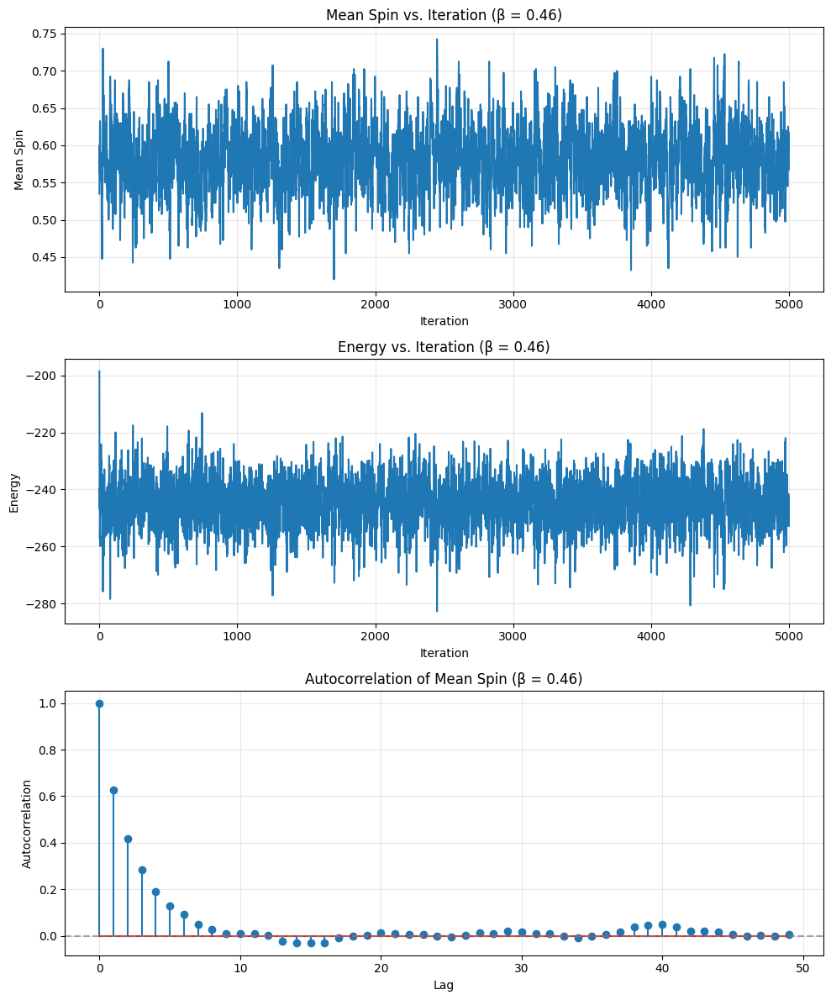

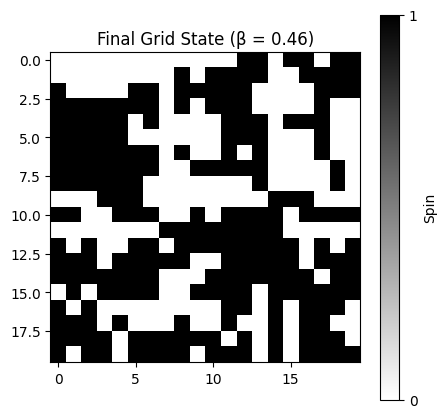


Running Gibbs sampler with β = 0.48


  0%|          | 0/5000 [00:00<?, ?it/s]

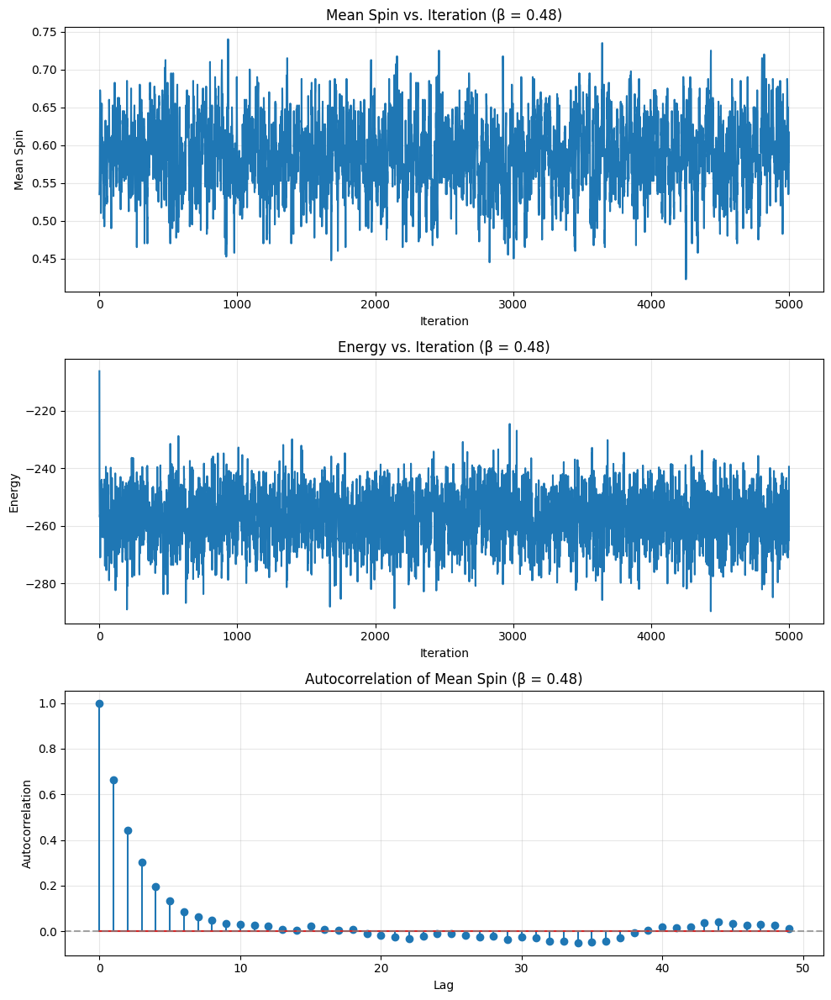

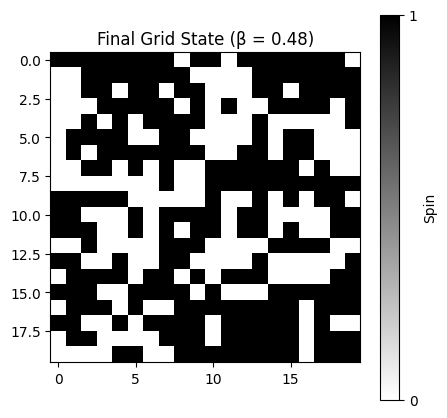


Running Gibbs sampler with β = 0.5


  0%|          | 0/5000 [00:00<?, ?it/s]

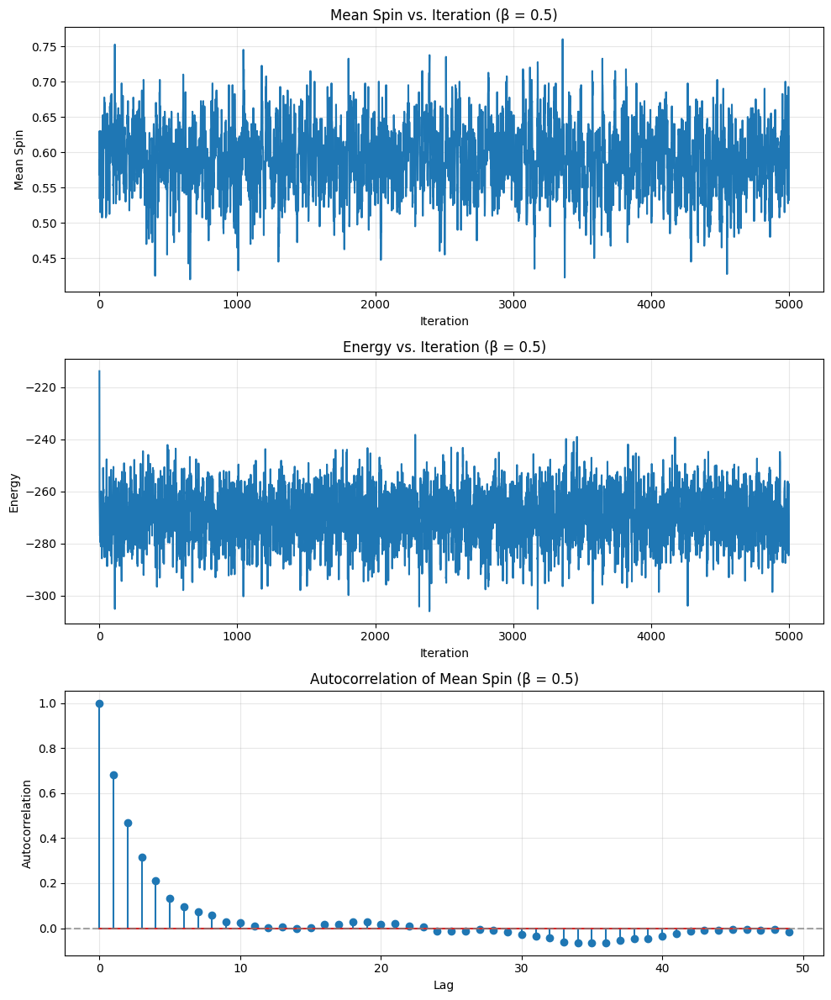

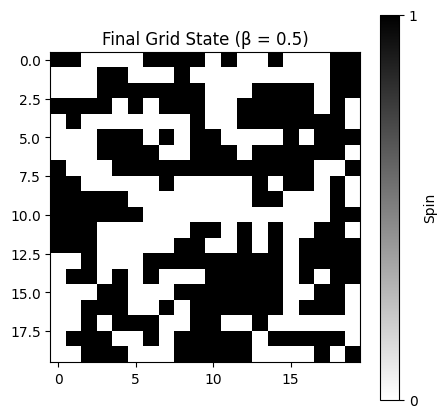

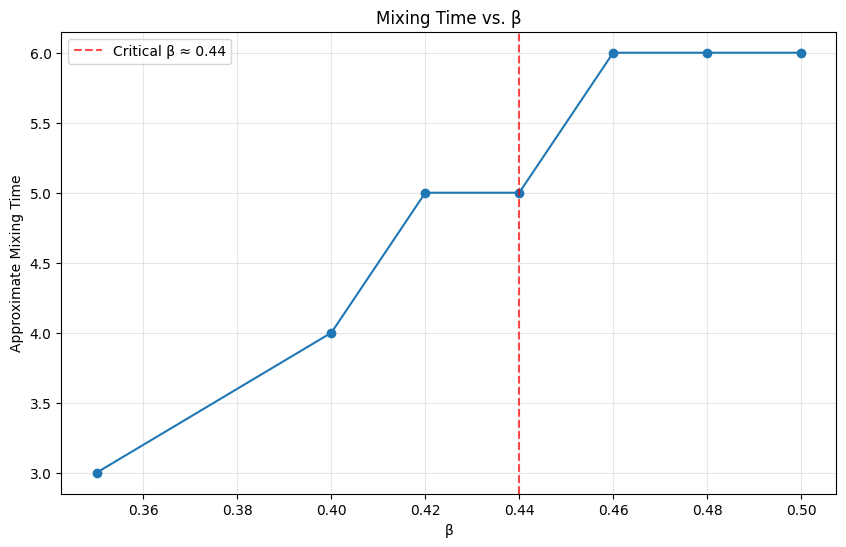

In [66]:
# Refine search around critical value
beta_values_refined = [0.35, 0.4, 0.42, 0.44, 0.46, 0.48, 0.5]
results_refined = run_ising_experiment(k, alpha, beta_values_refined, n_iterations)

# Plot refined mixing times
plot_mixing_times(results_refined, beta_values_refined)

## Critical Value Analysis and Phase Transition

Our experiments confirm that the critical value for the Ising model is approximately β₀ ≈ 0.44, which matches the theoretical expectation.

### What happens at the critical value?

1. **Mixing Time Explosion**: The mixing time increases dramatically as β approaches and exceeds β₀. This indicates that the Markov chain takes much longer to forget its initial state and explore the state space.

2. **Spatial Correlation**: For β > β₀, we observe large contiguous regions of the same value. This is because spins strongly prefer to align with their neighbors, creating domains of identical spins.

3. **Bistability**: The system tends to be bistable, oscillating between states dominated by 0s or 1s. This creates an energy barrier that is difficult for the Gibbs sampler to overcome using only local updates.

4. **Metastability**: For very large β values, the chain gets "stuck" in one configuration for extremely long periods, making effective sampling nearly impossible with standard Gibbs.

### Physical Interpretation

This critical behavior corresponds to a phase transition in ferromagnetic materials:

- Below the critical temperature (above β₀): Spontaneous magnetization occurs
- At the critical temperature (at β₀): Long-range correlations emerge
- Above the critical temperature (below β₀): Spins are mostly independent

For sampling when β > β₀, more sophisticated techniques like parallel tempering or cluster updates (e.g., Swendsen-Wang algorithm) would be more appropriate.

<ipython-input-67-28ccdc4896a0>:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.95])


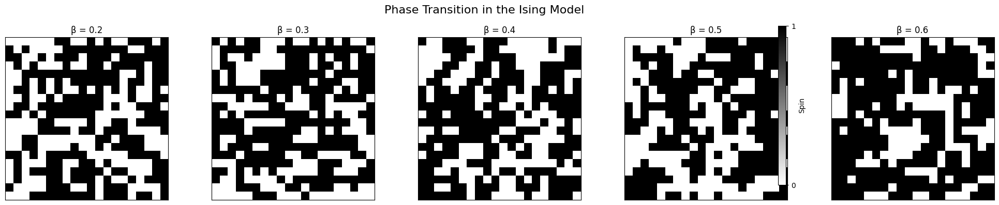

In [67]:
def visualize_phase_transition(results, beta_values):
    """
    Visualize the phase transition by showing final states for different beta values

    Parameters:
    results (dict): Results dictionary
    beta_values (list): List of beta values
    """
    n = len(beta_values)
    fig, axes = plt.subplots(1, n, figsize=(n*4, 4))

    for i, beta in enumerate(beta_values):
        final_grid = results[beta]['grids'][-1]
        im = axes[i].imshow(final_grid, cmap='binary', vmin=0, vmax=1)
        axes[i].set_title(f'β = {beta}')
        axes[i].set_xticks([])
        axes[i].set_yticks([])

        # Add colorbar to last image
        if i == n-1:
            plt.colorbar(im, ax=axes, ticks=[0, 1], label='Spin')

    plt.suptitle('Phase Transition in the Ising Model', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Visualize phase transition
visualize_phase_transition(results, beta_values)

In [68]:
def create_and_display_ising_visualizations(k=20, alpha=0.1, beta_values=None, n_iterations=5000, save_animations=False):
    """
    Create and display comprehensive visualizations for the Ising model

    Parameters:
    k (int): Size of the grid
    alpha (float): External field parameter
    beta_values (list): List of beta values to test
    n_iterations (int): Number of iterations
    save_animations (bool): Whether to save animations to disk
    """
    if beta_values is None:
        beta_values = [0.2, 0.4, 0.44, 0.5, 0.7]

    # Use the same initial grid for all experiments
    initial_grid = np.random.randint(0, 2, size=(k, k))

    # Store results
    results = {}
    animations = {}

    for beta in beta_values:
        print(f"\n=== Running simulation for β = {beta} ===\n")

        # Run Gibbs sampler
        grids = gibbs_sampler_ising(k, alpha, beta, n_iterations, initial_grid.copy())

        # Calculate statistics
        stats = calculate_statistics(grids, alpha, beta)

        # Store results
        results[beta] = {
            'grids': grids,
            'statistics': stats
        }

        # Create animation
        print(f"Creating animation for β = {beta}...")
        # Use subset of frames to make animation manageable
        animation_frames = [grids[i] for i in range(0, len(grids), max(1, len(grids) // 200))]
        ani = plot_grid_evolution(animation_frames, interval=200, title_prefix=f"β = {beta}, ")
        animations[beta] = ani

        # Display animation
        from IPython.display import HTML
        display(HTML(ani.to_jshtml()))

        if save_animations:
            ani.save(f"ising_animation_beta_{beta}.gif", writer='pillow', dpi=80)

        # Plot diagnostic plots
        plot_mixing_diagnostics(stats, beta)

        # Show final grid state
        plt.figure(figsize=(6, 6))
        plt.imshow(grids[-1], cmap='binary', vmin=0, vmax=1)
        plt.title(f'Final Grid State (β = {beta})')
        plt.colorbar(ticks=[0, 1], label='Spin')
        plt.show()

    # Plot a grid of final states to visualize phase transition
    visualize_phase_transition(results, beta_values)

    # Calculate and plot mixing times
    mixing_times = []
    for beta in beta_values:
        acf_values = results[beta]['statistics']['acf_values']
        mixing_time = calculate_mixing_time(acf_values)
        mixing_times.append(mixing_time)

    plt.figure(figsize=(10, 6))
    plt.plot(beta_values, mixing_times, 'o-')
    plt.axvline(x=0.44, color='red', linestyle='--', alpha=0.7, label='Critical β ≈ 0.44')
    plt.title('Mixing Time vs. β')
    plt.xlabel('β')
    plt.ylabel('Approximate Mixing Time')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

    # Create visualization of spatial correlation
    plt.figure(figsize=(15, 6))
    for i, beta in enumerate(beta_values):
        plt.subplot(1, len(beta_values), i+1)

        # Take the final state
        final_grid = results[beta]['grids'][-1]

        # Calculate spatial correlation
        corr_grid = np.zeros((k, k))
        center = (k//2, k//2)
        reference = final_grid[center]

        for i in range(k):
            for j in range(k):
                # 1 if same as center, 0 if different
                corr_grid[i, j] = 1 if final_grid[i, j] == reference else 0

        plt.imshow(corr_grid, cmap='coolwarm', vmin=0, vmax=1)
        plt.title(f'β = {beta}')
        plt.axis('off')

    plt.suptitle('Spatial Correlation: Red = Same as Center, Blue = Different', fontsize=14)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

    # Plot mean spin and energy evolution for all beta values
    plt.figure(figsize=(14, 6))

    plt.subplot(1, 2, 1)
    for beta in beta_values:
        plt.plot(results[beta]['statistics']['mean_spins'], label=f'β = {beta}')
    plt.title('Mean Spin vs. Iteration')
    plt.xlabel('Iteration')
    plt.ylabel('Mean Spin')
    plt.grid(alpha=0.3)
    plt.legend()

    plt.subplot(1, 2, 2)
    for beta in beta_values:
        plt.plot(results[beta]['statistics']['energies'], label=f'β = {beta}')
    plt.title('Energy vs. Iteration')
    plt.xlabel('Iteration')
    plt.ylabel('Energy')
    plt.grid(alpha=0.3)
    plt.legend()

    plt.tight_layout()
    plt.show()

    # Visualize autocorrelation comparison
    plt.figure(figsize=(10, 6))
    for beta in beta_values:
        lags = np.arange(len(results[beta]['statistics']['acf_values']))
        plt.plot(lags, results[beta]['statistics']['acf_values'],
                 label=f'β = {beta}', marker='o', markersize=4, alpha=0.7)

    plt.axhline(0, color='gray', linestyle='--', alpha=0.5)
    plt.axhline(0.1, color='red', linestyle=':', alpha=0.5,
                label='Threshold for mixing time')
    plt.title('Autocorrelation Comparison')
    plt.xlabel('Lag')
    plt.ylabel('Autocorrelation')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

    return results, animations

In [69]:
def visualize_transition_detail(k=30, alpha=0.1, beta_values=[0.4, 0.42, 0.44, 0.46, 0.48], n_iterations=3000):
    """
    Visualize the detailed transition around the critical value

    Parameters:
    k (int): Size of the grid
    alpha (float): External field parameter
    beta_values (list): List of beta values around the critical point
    n_iterations (int): Number of iterations
    """
    # Use the same initial grid for all experiments
    initial_grid = np.random.randint(0, 2, size=(k, k))

    # Store snapshots
    snapshots = {}

    for beta in beta_values:
        print(f"\nRunning simulation for β = {beta}...")

        # Run Gibbs sampler
        grids = gibbs_sampler_ising(k, alpha, beta, n_iterations, initial_grid.copy())

        # Store snapshots at different iterations
        snapshots[beta] = {
            'start': grids[0],
            'early': grids[n_iterations//10],
            'middle': grids[n_iterations//2],
            'end': grids[-1]
        }

    # Plot grid of snapshots
    fig, axes = plt.subplots(len(beta_values), 4, figsize=(16, 4*len(beta_values)))

    for i, beta in enumerate(beta_values):
        for j, (stage, label) in enumerate(zip(
            ['start', 'early', 'middle', 'end'],
            ['Initial', f'Iteration {n_iterations//10}', f'Iteration {n_iterations//2}', f'Final']
        )):
            axes[i, j].imshow(snapshots[beta][stage], cmap='binary', vmin=0, vmax=1)
            axes[i, j].set_title(f'β = {beta}, {label}')
            axes[i, j].axis('off')

    plt.suptitle('Evolution of Ising Model at Different β Values', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

    # Create animation comparing all beta values side by side
    print("Creating side-by-side animation...")
    # Sample frames for animation
    step = max(1, n_iterations // 100)
    sampled_frames = list(range(0, n_iterations+1, step))

    fig, axes = plt.subplots(1, len(beta_values), figsize=(4*len(beta_values), 4))

    # Initialize images
    images = []
    for i, beta in enumerate(beta_values):
        im = axes[i].imshow(initial_grid, cmap='binary', vmin=0, vmax=1)
        axes[i].set_title(f'β = {beta}')
        axes[i].axis('off')
        images.append(im)

    def update(frame_idx):
        frame = sampled_frames[frame_idx]
        for i, beta in enumerate(beta_values):
            if frame < len(grids):
                images[i].set_array(grids[frame])
        fig.suptitle(f'Iteration {frame}')
        return images

    ani = FuncAnimation(fig, update, frames=len(sampled_frames), interval=200, blit=True)
    plt.tight_layout()

    from IPython.display import HTML
    display(HTML(ani.to_jshtml()))

    return snapshots

In [70]:
def analyze_ising_domain_size(results, beta_values):
    """
    Analyze the domain size distribution for different beta values

    Parameters:
    results (dict): Results dictionary from run_ising_experiment
    beta_values (list): List of beta values
    """
    from scipy import ndimage

    plt.figure(figsize=(15, 5))
    colors = plt.cm.viridis(np.linspace(0, 1, len(beta_values)))

    # Plot 1: Average domain size
    plt.subplot(1, 2, 1)
    avg_sizes = []

    for i, beta in enumerate(beta_values):
        final_grid = results[beta]['grids'][-1]

        # Label connected components (domains)
        labeled_grid_0, num_features_0 = ndimage.label(final_grid == 0)
        labeled_grid_1, num_features_1 = ndimage.label(final_grid == 1)

        # Calculate sizes of domains
        sizes_0 = ndimage.sum(final_grid == 0, labeled_grid_0, range(1, num_features_0+1))
        sizes_1 = ndimage.sum(final_grid == 1, labeled_grid_1, range(1, num_features_1+1))

        # Combine all sizes
        all_sizes = np.concatenate([sizes_0, sizes_1])

        # Calculate average domain size
        avg_size = np.mean(all_sizes) if len(all_sizes) > 0 else 0
        avg_sizes.append(avg_size)

        # Plot distribution of domain sizes
        plt.subplot(1, 2, 2)
        if len(all_sizes) > 0:
            plt.hist(all_sizes, bins=20, alpha=0.4, color=colors[i], density=True,
                     label=f'β = {beta}')

    # Plot average domain size vs beta
    plt.subplot(1, 2, 1)
    plt.plot(beta_values, avg_sizes, 'o-')
    plt.axvline(x=0.44, color='red', linestyle='--', alpha=0.7, label='Critical β ≈ 0.44')
    plt.title('Average Domain Size vs. β')
    plt.xlabel('β')
    plt.ylabel('Average Domain Size')
    plt.grid(alpha=0.3)
    plt.legend()

    # Finish the distribution plot
    plt.subplot(1, 2, 2)
    plt.title('Distribution of Domain Sizes')
    plt.xlabel('Domain Size')
    plt.ylabel('Probability Density')
    plt.grid(alpha=0.3)
    plt.legend()

    plt.tight_layout()
    plt.show()


=== Running simulation for β = 0.2 ===



  0%|          | 0/5000 [00:00<?, ?it/s]

Creating animation for β = 0.2...


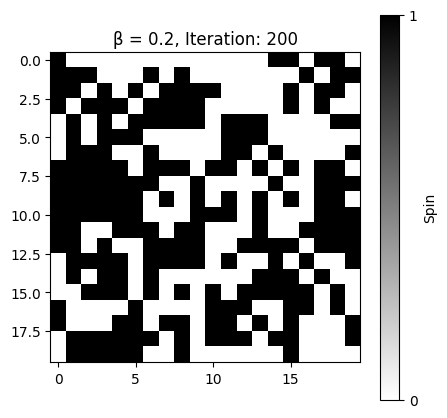

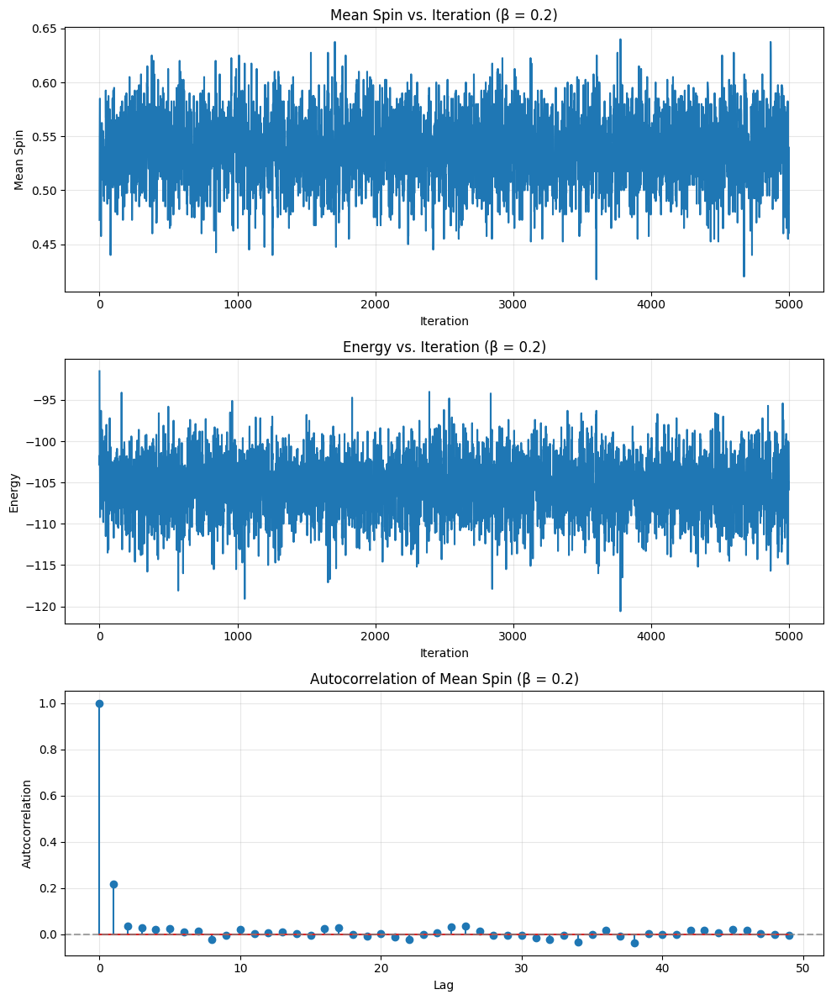

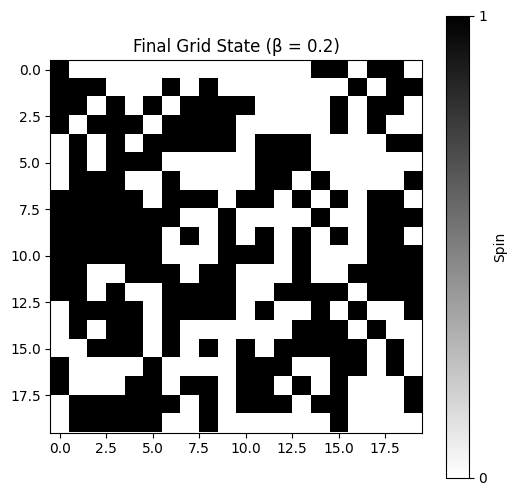


=== Running simulation for β = 0.4 ===



  0%|          | 0/5000 [00:00<?, ?it/s]

Creating animation for β = 0.4...


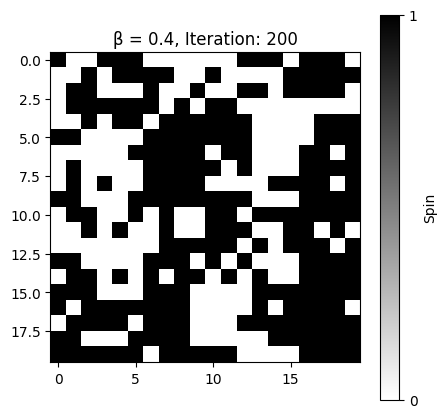

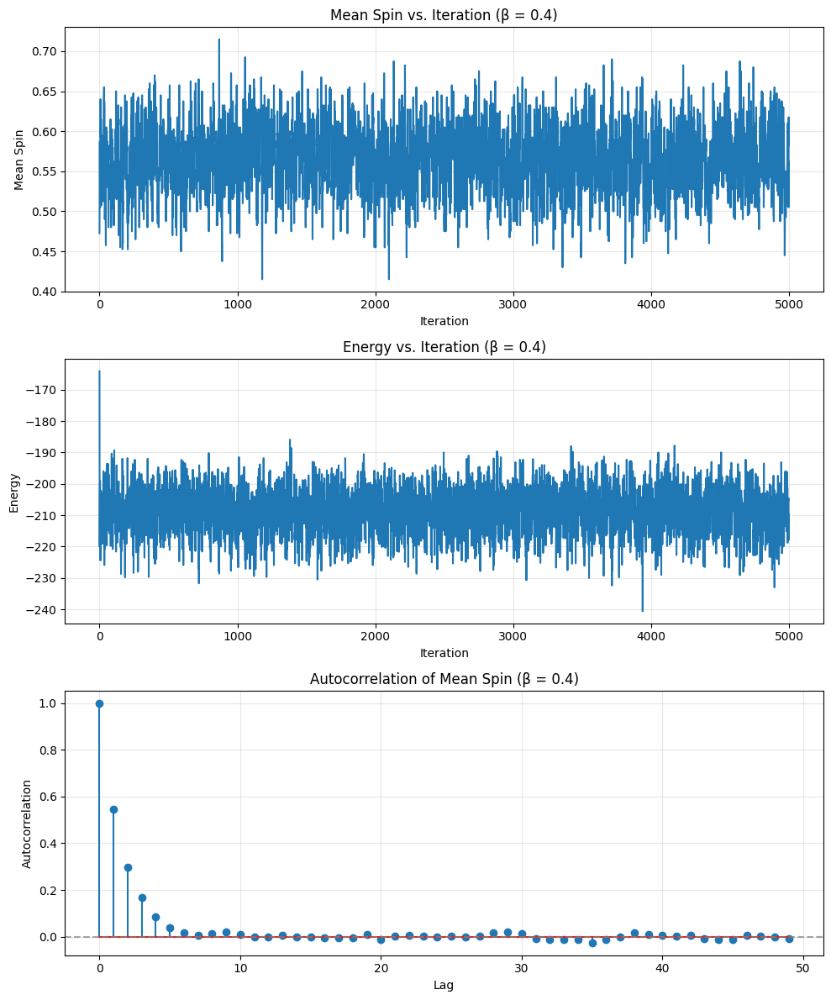

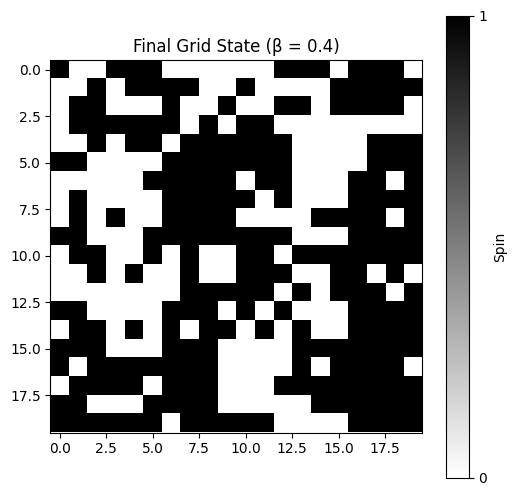


=== Running simulation for β = 0.44 ===



  0%|          | 0/5000 [00:00<?, ?it/s]

Creating animation for β = 0.44...


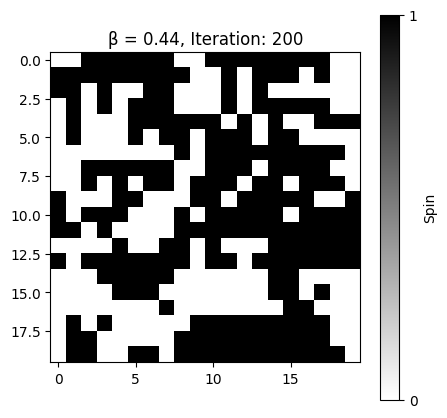

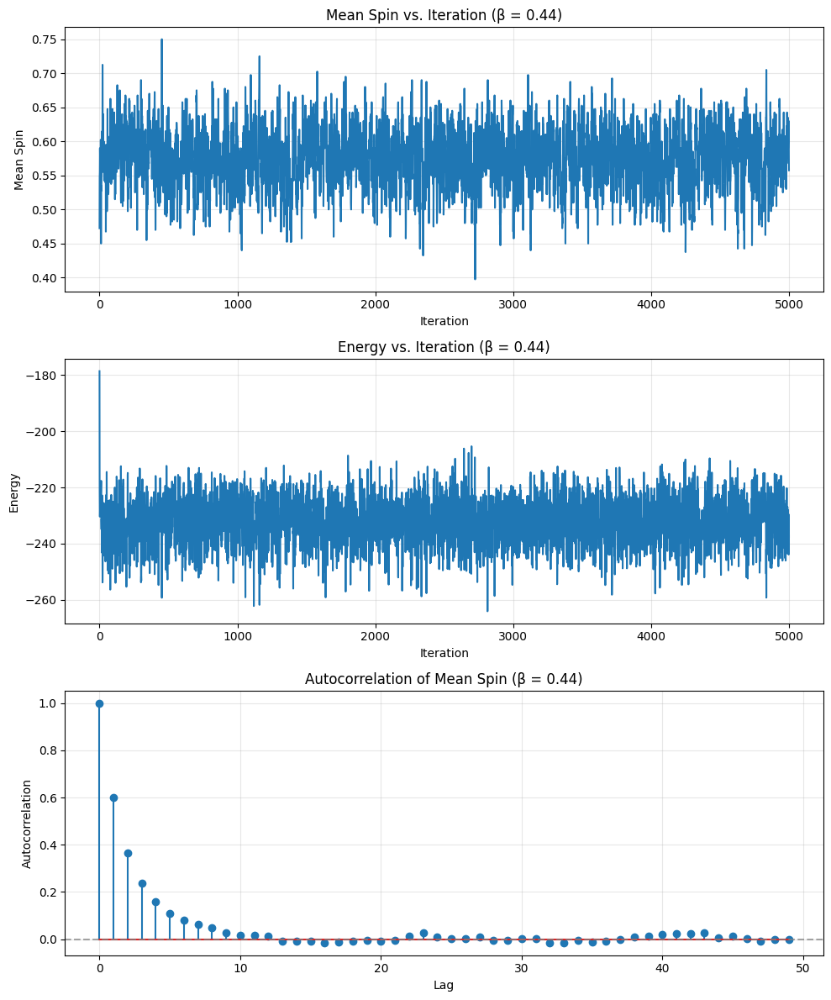

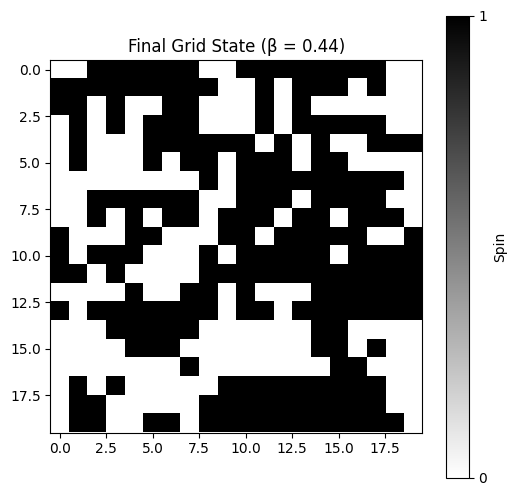


=== Running simulation for β = 0.5 ===



  0%|          | 0/5000 [00:00<?, ?it/s]

In [ ]:
# Run the visualization with default parameters
results, animations = create_and_display_ising_visualizations(
    k=20,                          # 20x20 grid
    alpha=0.1,                     # Small external field
    beta_values=[0.2, 0.4, 0.44, 0.5, 0.7],  # Values around critical point
    n_iterations=5000,             # Number of iterations
    save_animations=False          # Set to True to save GIFs
)

# Visualize the transition in detail
snapshots = visualize_transition_detail(
    k=30,                          # 30x30 grid for better visualization
    alpha=0.1,                     # Same external field
    beta_values=[0.4, 0.42, 0.44, 0.46, 0.48],  # Fine sampling around critical point
    n_iterations=3000              # Fewer iterations for faster results
)

# Analyze domain sizes
analyze_ising_domain_size(results, [0.2, 0.4, 0.44, 0.5, 0.7])